## Imports and Installation

In [1]:
!pip install miseval

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.0/61.0 kB 6.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 15.7/15.7 MB 35.4 MB/s eta 0:00:0000:0100:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 48.7 MB/s eta 0:00:00a 0:00:01
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 34.5/34.5 MB 27.1 MB/s eta 0:00:0000:0100:01
  Created wheel for dictances: filename=dictances-1.5.6-py3-none-any.whl size=13517 sha256=95cb653db21fc2ac78859cdebbce2b3c6557c0e4ca35de3198e853bd321db3e0
  Stored in directory: /root/.cache/pip/wheels/cc/96/4d/91f2edcb5d2584367af01e025c786759fffe618127f10eadbd
  Created wheel for hausdorff: filename=hausdorff-0.2.6-py3-none-any.whl size=15187 sha256=6d17d1eac597871e99a7d883dc30897a445e392de88c324597500dd29db4a57d
  Stored in directory: /root/.cache/pip/wheels/8d/56/ea/fd4bbacf1217e197e63de821a74730e953b23fdf2030733061
 

In [200]:
#Standard imports
import os
import math
import pathlib
import shutil
import matplotlib.pyplot as plt
import cv2
import numpy as np
from scipy.ndimage import rotate
import re
import random
#import segmentation_models as sm
#import segmentation_models_pytorch as sm
import time
from sklearn.model_selection import train_test_split
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix
from miseval import evaluate
from tqdm import tqdm
from PIL import Image
#Tensorflow imports
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.utils import image_dataset_from_directory, img_to_array, load_img, array_to_img, save_img, to_categorical



In [3]:
#PyTorch imports
import torch
from torch.nn import functional as f
from torch.utils.data import TensorDataset, Dataset
from torch.utils.data import DataLoader
import torchvision
from torchvision import transforms
from torchvision.transforms import functional as F
from torchvision import transforms
from torch import nn

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## Data Paths

In [4]:
image_dir = "./fundus_images/"
#enhanced_image_dir = "./enhancement_one_x/"
enhanced_image_dir = "./fundus_images/"
annotations_dir = "./cleaned_annotations/"

In [5]:
image_files = sorted(list(os.listdir(image_dir)))
image_files.remove(".ipynb_checkpoints")
image_files = sorted([os.path.join(enhanced_image_dir, file_name) for file_name in image_files])


annotation_files = sorted(list(os.listdir(annotations_dir)))
annotation_files.remove(".DS_Store")
annotation_files = sorted([os.path.join(annotations_dir, file_name) for file_name in annotation_files])

In [6]:
train_img, tv_img, train_anns, tv_anns = train_test_split(image_files, annotation_files, test_size=0.2, random_state=99)

In [7]:
mismatch = [file[:-4] for file in image_files if file in annotation_files]

In [8]:
valid_img, test_img, valid_anns, test_anns = train_test_split(tv_img, tv_anns, test_size=0.5, random_state=99)

In [9]:
classes = sorted(["cotton_wool_spots", "hard_exudate", "retinal_hemorrhage", "microaneurysm"])

In [10]:
classes

['cotton_wool_spots', 'hard_exudate', 'microaneurysm', 'retinal_hemorrhage']

In [11]:
print(f"There are {len(train_img)} training images and annotations")
print(f"There are {len(valid_img)} validation images and annotations")
print(f"There are {len(test_img)} test images and annotations")

There are 1260 training images and annotations
There are 157 validation images and annotations
There are 158 test images and annotations


### Moving out Test Files

In [63]:
target_img_dir = "./test_ds/images/"
target_ann_dir = "./test_ds/annotations/"

for img, ann in zip(test_img, test_anns):
    img_file = img.split("/")[-1]
    ann_file = img.split("/")[-1]
    dst_img_file = os.path.join(target_img_dir, img_file)
    dst_ann_file = os.path.join(target_ann_dir, ann_file)
    
    try:
        os.mkdir(dst_ann_file)
    except:
        pass
    
    
    shutil.copy(img, dst_img_file)
    for f in os.listdir(ann):
        shutil.copy(os.path.join(ann, f), os.path.join(dst_ann_file, f))


### Classification Data Paths


In [12]:
targets_dir = "./dr_grades/"

In [13]:
segmentation_maps_dir = "./lesion_annotations_color_darker/"

In [14]:
image_files = sorted(list(os.listdir(segmentation_maps_dir)))
#image_files.remove(".DS_Store")
image_files = sorted([os.path.join(segmentation_maps_dir, img_file) for img_file in image_files])

## Data Pipeline Classes

### Segmentation Pipeline

In [12]:
class MultiClassSegmentationDataset(Dataset):
    
    def __init__(self, image_files, mask_dirs, size, classes,n_classes, background=True, test_mode=False, binary_index=None):
        
        assert len(image_files) == len(mask_dirs)
        
        self.image_files = sorted(image_files)
        self.mask_dirs = sorted(mask_dirs)
        self.annotation_files = {}
        
        for img_fldr in self.mask_dirs:
            self.annotation_files[img_fldr] = sorted(os.listdir(img_fldr))
            
        self.H = size
        self.W = size
        self.n = n_classes
        self.classes = dict(zip(sorted(classes), range(n_classes)))
        self.background = background
        self.test_mode = test_mode
        self.binary_index = binary_index

    
    def __len__(self):
        
        return len(self.image_files)

    def __getitem__(self, idx):
        
        #Reading the image
        img_path = self.image_files[idx]

        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (self.H,self.W))
        #norm_img = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        norm_img = img / 255.0
        norm_img = np.transpose(norm_img, (2, 0, 1))
        img_tensor = torch.from_numpy(norm_img)
        img_tensor = img_tensor.float()
        
        
        #Preparing mask - There are 4 lesion classes, the directories have 1 picture each for a specific lesion, have to combine them
        #1 extra class for the background
        #The background mask is currently all ones, the ones from each class have to be subtracted from it
        background = np.ones((self.H, self.W))
        mask = np.zeros((self.n + 1, self.H, self.W))
        ann_fldr = self.mask_dirs[idx]
        ann_files = self.annotation_files[ann_fldr]
        for ann_file in ann_files:

            code = ann_file[:-4]
            ix = self.classes[code]
            ann_path = os.path.join(ann_fldr, ann_file)
            ann = cv2.imread(ann_path, 0)
            ann = cv2.resize(ann, (self.H, self.W), cv2.INTER_NEAREST)
            #update background by subtracting the current pixel positions
            background = background - ann
            
            ann = np.expand_dims(ann, axis=0)
            
            mask[ix+1, :, :] = ann
        
        #If there are overlapping pixel values, the pixel value at a certain position may be negative, have to clip to 0
        background = np.clip(background, 0, None)
        background = np.expand_dims(background, axis=0)
        #Place the background class inside
        if self.background:
            mask[0,:,:] = background
        
        mask_tensor = torch.from_numpy(mask)
        mask_tensor = mask_tensor.float()
        
        if not self.test_mode:
            #Data augmentation if it's not test_mode, for example training and validation data will get augmented
            augment_mode = np.random.randint(0,4)
            if augment_mode == 0:
                img_tensor = F.hflip(img_tensor)
                mask_tensor = F.hflip(mask_tensor)
            elif augment_mode == 1:
                img_tensor = F.vflip(img_tensor)
                mask_tensor = F.vflip(mask_tensor)
            elif augment_mode == 2:
                angle = np.random.randint(-5, 5)
                img_tensor = F.rotate(img_tensor, angle)
                mask_tensor = F.rotate(mask_tensor, angle)

        if self.binary_index is not None:
            mask_tensor = mask_tensor[self.binary_index]
            
        return img_tensor, mask_tensor
        
        
                
        
        

        

### Classification Pipeline

In [13]:
class ClassificationDataset(Dataset):

    def __init__(self, image_files, target_dir, size, n_classes, test_mode=False):

        self.image_files = image_files
        self.target_dir = target_dir
        self.H = size
        self.W = size
        self.n_classes = n_classes
        self.test_mode = test_mode
    
    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):

        #Reading the image
        img_path = self.image_files[idx]

        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        img = cv2.resize(img, (self.H,self.W))
        #norm_img = cv2.normalize(img, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        norm_img = img / 255.0
        norm_img = np.transpose(norm_img, (2, 0, 1))
        img_tensor = torch.from_numpy(norm_img)
        img_tensor = img_tensor.float()

        #Creating the target class vector
        target = torch.zeros(self.n_classes)
        #The name of the image file is the last part of the img path, without the extension
        img_file = img_path.split('/')[-1][:-4] + ".txt"
        target_file_path = os.path.join(self.target_dir, img_file)
        with open(target_file_path, "r") as target_file:
            class_ix = int(target_file.read())
        target[class_ix] = 1.0

        if not self.test_mode:
            #Data augmentation if it's not test_mode, for example training and validation data will get augmented
            augment_mode = np.random.randint(0,4)
            if augment_mode == 0:
                img_tensor = F.hflip(img_tensor)
            elif augment_mode == 1:
                img_tensor = F.vflip(img_tensor)
            elif augment_mode == 2:
                angle = np.random.randint(-5, 5)
                img_tensor = F.rotate(img_tensor, angle)


        return img_tensor, target

 
    

## Model Definition

### Segmentation Models

#### Base Model

In [52]:
class BaseModel():

    def predict(self, dataloader):
        """This function """
        self.eval()

        with torch.no_grad():
            
            predictions = []
            for images, _ in tqdm(dataloader):
                images = images.to(device)
                outputs = self(images)
                outputs = torch.nn.functional.softmax(outputs, dim=1)

                predictions.append(outputs.permute(0, 2, 3, 1))
            predictions = torch.cat(predictions, dim=0)
        
        return predictions.detach().cpu().numpy()
    
    def predict_binary(self, dataloader):
        """This function """
        self.eval()

        with torch.no_grad():
            
            predictions = []
            for images, _ in tqdm(dataloader):
                images = images.to(device)
                outputs = self(images)
                outputs = torch.sigmoid(outputs)
                predictions.append(outputs)
            predictions = torch.cat(predictions, dim=0)
        
        return predictions.detach().cpu().numpy()
    
    def predict_image(self, image):
        """This function returns the prediction of one image.
            image : torch.Tensor shape (3, w, h)
        """
        self.eval()
        with torch.no_grad():
            
            image = image.float()
            image = image.unsqueeze(0)
            image = image.to(device)
            output = self(image)
            output = torch.nn.functional.softmax(output, dim=1)
            output = output.detach().cpu().numpy()
            output = np.transpose(output, (0, 2, 3, 1))
            return output

#### Dual Attention

In [14]:
import torch
from torch import nn

class SpatialAttention(nn.Module):

    def __init__(self, in_channels):

        super(SpatialAttention, self).__init__()

        self.C = in_channels

        self.alpha = nn.Parameter(torch.tensor(0.0))

        self.conv1 = nn.Conv2d(in_channels=self.C, out_channels=self.C, kernel_size=1, stride=1)
        self.conv2 = nn.Conv2d(in_channels=self.C, out_channels=self.C, kernel_size=1, stride=1)
        self.conv3 = nn.Conv2d(in_channels=self.C, out_channels=self.C, kernel_size=1, stride=1)
        self.relu = nn.ReLU()

    
    def forward(self, x):
        

        H = x.shape[2]
        W = x.shape[3]

        N = H * W

        a = x
        b = self.relu(self.conv1(x))
        c = self.relu(self.conv2(x))
        d = self.relu(self.conv3(x))

            

        b = b.view(-1, self.C, N)
        c = c.view(-1, self.C, N)
        d = d.view(-1, self.C, N)

        c = torch.bmm(c.transpose(1, 2), b)
        S = nn.Softmax(dim=1)(c)
        S = S.transpose(1, 2)

        d = self.alpha * torch.bmm(d, S)
        d = d.view(-1, self.C, H, W)
        E = a + d

        return E


class ChannelAttention(nn.Module):

    def __init__(self, in_channels):

        super(ChannelAttention, self).__init__()
        self.beta = nn.Parameter(torch.tensor(0.0))

        self.C = in_channels
    
    def forward(self, x):

        a1=a2=a3=a4 = x
        H = x.shape[2]
        W = x.shape[3]
        N = H * W

        a2 = a2.view(-1, self.C, N)
        a3 = a3.view(-1, self.C, N)
        a4 = a4.view(-1, self.C, N)
        a4 = a4.transpose(1, 2)

        aa_T = torch.bmm(a3, a4)
        X = nn.Softmax(dim=1)(aa_T)
        X = X.transpose(1, 2)

        a2_pass = torch.bmm(X, a2) * self.beta
        a2_pass = a2_pass.view(-1, self.C, H, W)

        E = a1 + a2_pass

        return E

class DualAttention(nn.Module):

    def __init__(self, in_channels):
        
        super(DualAttention, self).__init__()
        self.C = in_channels

        self.conv1 = nn.Conv2d(self.C, self.C, 1)
        self.conv2 = nn.Conv2d(self.C, self.C, 1)

        self.sam = SpatialAttention(in_channels)
        self.cam = ChannelAttention(in_channels)

    def forward(self, x):

        e1 = self.sam(x)
        e2 = self.sam(x)

        e1 = self.conv1(e1)
        e2 = self.conv2(e2)

        F = e1 + e2
        return F

#### Compact Split Attention

In [15]:
class CSA(nn.Module):

    def __init__(self, in_channels):
        
        super(CSA, self).__init__()

        self.C = in_channels
        self.C_by_2 = int(in_channels / 2)
        self.conv_1 = nn.Conv2d(in_channels, in_channels, 1)
        self.conv_3x3_1 = nn.Conv2d(in_channels=self.C_by_2, out_channels=self.C_by_2, kernel_size=3, stride=1, padding="same")
        self.conv_3x3_2 = nn.Conv2d(in_channels=self.C_by_2, out_channels=self.C_by_2, kernel_size=3, stride=1, padding="same")
        self.conv_3x3_3 = nn.Conv2d(in_channels=in_channels, out_channels=self.C_by_2, kernel_size=3, stride=1, padding="same")

        self.group_1 = nn.Conv2d(in_channels=in_channels, out_channels=in_channels, kernel_size=1, stride=1)
        self.bn = nn.BatchNorm2d(in_channels)
        self.relu = nn.ReLU()
        self.group_2 = nn.Conv2d(in_channels=in_channels, out_channels=in_channels, kernel_size=1, stride=1)
        self.softmax = nn.Softmax(dim=1)
        self.final_conv = nn.Conv2d(in_channels=in_channels, out_channels=in_channels, kernel_size=1, stride=1)

    def forward(self, input):

        H = input.shape[2]
        W = input.shape[3]

        N = H * W

        F = self.conv_1(input)
        F_1, F_2 = F.split(int(self.C / 2), dim=1)

        F_1 = self.conv_3x3_1(F_1)
        F_2 = self.conv_3x3_2(F_2)
        F_2 = torch.concat([F_1, F_2], dim=1)
        F_2 = self.conv_3x3_3(F_2)

        F = torch.concat([F_1, F_2], dim=1)

        #Global average pooling
        F = nn.AdaptiveAvgPool2d((H, W))(F)

        F = self.group_1(F)
        F = self.bn(F)
        F = self.relu(F)
        F = self.group_2(F)

        F_1_s, F_2_s = F.split(int(self.C / 2), dim=1)

        F_1_s = self.softmax(F_1)
        F_2_s = self.softmax(F_2)

        F_1_final = F_1 * F_1_s
        F_2_final = F_2 * F_2_s

        F_final = torch.concat([F_1_final, F_2_final], dim=1)
        F_final = self.final_conv(F_final)

        output = F_final + input

        return output

#### Decoder

In [16]:
class SimpleDecoderBlock(nn.Module):

    def __init__(self, d_in, d_out):

        super().__init__()

        self.upconv = nn.UpsamplingBilinear2d(scale_factor=2)
        self.conv_1 = nn.Conv2d(d_in, d_out, 1, 1)
        self.relu = nn.ReLU()
        self.conv_2 = nn.Conv2d(d_out*2, d_out, 3, 1, "same")
        self.bn1 = nn.BatchNorm2d(d_out)
        self.conv_3 = nn.Conv2d(d_out, d_out, 3, 1, "same")
        self.bn2 = nn.BatchNorm2d(d_out)

    def forward(self, inp, a):

        x = self.upconv(inp)
        x = self.relu(self.conv_1(x))

        if a is not None:

            x = torch.cat([a, x], axis=1)
            x = self.conv_2(x)
            x = self.bn1(x)
            x = self.relu(x)
            
        x = self.conv_3(x)
        x = self.bn2(x)
        x = self.relu(x)

        return x


        

In [17]:
class DecoderBlock(nn.Module):

    def __init__(self, d_in, d_out):


        super().__init__()
        self.upconv = nn.ConvTranspose2d(d_in, d_out, 2, 2)
        self.conv_1 = nn.Conv2d(d_out*2, d_out, 3, 1, "same")
        self.bn1 = nn.BatchNorm2d(d_out)
        self.relu = nn.ReLU()
        self.conv_2 = nn.Conv2d(d_out, d_out, 3, 1, "same")
        self.bn2 = nn.BatchNorm2d(d_out)
        

    def forward(self, inp, a):
        
        x = self.relu(self.upconv(inp))

        if a is not None:
            x = torch.cat([a, x], axis=1)
            x = self.conv_1(x)
            x = self.bn1(x)
            x = self.relu(x)
            
        x = self.conv_2(x)
        x = self.bn2(x)
        x = self.relu(x)

        return x


class Decoder(nn.Module):

    def __init__(self, d_in, filters, num_classes, simple=False, sigmoid=False, subtractive=False):

        super().__init__()

        self.decoder_blocks = []

        for f in filters:
            
            if simple:
                db = SimpleDecoderBlock(d_in, f)
            else:
                db = DecoderBlock(d_in, f)

            self.decoder_blocks.append(db)
            d_in = f
        
        self.dropout = nn.Dropout2d(p=0.2)
        self.sub = nn.Conv2d(f, 1, 1, 1) if subtractive else None
        self.output = nn.Conv2d(f, num_classes, 1, 1)
        self.decoder_blocks = nn.ModuleList(self.decoder_blocks)
        self.sig = nn.Sigmoid() if (sigmoid or subtractive) else None
    
    def forward(self, inputs, activations):

        x = inputs
        for db, a in zip(self.decoder_blocks, activations):

            x = db(x, a)
        
        if self.sub is None:
            output = self.output(x)
            if self.sig is not None:
                output = self.sig(output)
        else:
            bin_mask = self.sig(self.sub(x))
            weighted_features = bin_mask * x
            output = self.output(weighted_features)
        
        output = self.dropout(output)
            
        return output
        


#### Encoder

In [18]:

class EncoderBlock(nn.Module):

    def __init__(self, d_in, d_out):

        super().__init__()

        self.conv_1 = nn.Conv2d(d_in, d_out, 3, 1, "same")

        self.bn1 = nn.BatchNorm2d(d_out)
        self.bn2 = nn.BatchNorm2d(d_out)
        
        self.relu = nn.ReLU()
        self.pool = nn.MaxPool2d(2, 2)

        self.conv_2 = nn.Conv2d(d_out, d_out, 3, 1, "same")
    
    def forward(self, inputs):

        a = self.relu(self.bn1(self.conv_1(inputs)))
        a = self.relu(self.bn1(self.conv_2(a)))
        x = self.pool(a)

        return x, a


class LastEncoder(nn.Module):

    def __init__(self, d_in, d_out):

        super().__init__()
        self.conv1 = nn.Conv2d(d_in, d_out, 3, 1, "same")
        self.relu = nn.ReLU()
        self.conv2 = nn.Conv2d(d_out, d_out, 3, 1, "same")

    def forward(self, inputs):

        x = self.relu(self.conv2(self.relu(self.conv1(inputs))))

        return x

class FullEncoder(nn.Module):

    def __init__(self, d_in, filters):

        super().__init__()

        self.encoder_blocks = []
        for f in filters[:-1]:

            encoder = EncoderBlock(d_in, f)

            self.encoder_blocks.append(encoder)
            d_in = f
        
        self.last_encoder = LastEncoder(f, filters[-1])
        self.encoder_blocks = nn.ModuleList(self.encoder_blocks)



    def forward(self, inputs):

        activations = []
        x = inputs
        for eb in self.encoder_blocks:

            x, a = eb(x)
            activations.append(a)

        x = self.last_encoder(x)

        return x, activations

class UNet(nn.Module, BaseModel):

    def __init__(self, d_in, num_classes, filters, simple=False, sigmoid=False, attention=False, subtractive=False):

        super().__init__()
        self.encoder = FullEncoder(d_in, filters)
        self.decoder = Decoder(filters[-1], filters[:-1][::-1], num_classes, simple=simple, sigmoid=sigmoid)

    def forward(self,inputs):

        x, activations = self.encoder(inputs)

        o = self.decoder(x, activations[::-1])

        return o

#### VGG U-Net

In [19]:
from torchvision.models import vgg19, VGG19_Weights


class VGGUNet(nn.Module, BaseModel):

    def __init__(self, num_classes, simple=False, sigmoid=False, attention=False, subtractive=False):

        super().__init__()
        
        vgg19_m = vgg19(weights=VGG19_Weights.DEFAULT)
        self.vgg = nn.Sequential(*(list(vgg19_m.children())[0][:-1]))
        for param in self.vgg.parameters():
            param.requires_grad = False
            
        self.vgg = self.vgg.to(device)
        self.activations = []

        self.filters = [512, 256, 128, 64]
        self.decoder = Decoder(self.filters[0], self.filters, num_classes, simple=simple, sigmoid=sigmoid, subtractive=subtractive)

        self.attention = attention
        if attention == 1:
            self.dual_attention = CSA(self.filters[0])
            self.dual_attention_2 = CSA(self.filters[0])
        elif attention == 2:
            self.dual_attention = DualAttention(self.filters[0])
            self.dual_attention_2 = DualAttention(self.filters[0])
        elif attention > 2 or attention < 0:
            print("Print attention can only be 0, 1, or 2")
            return -1
        else:
            pass
                                           

    
    def getActivations(self):
        def hook(model, input, output):
            self.activations.append(output)
        return hook
    
    def forward(self, input):

        self.activations = []

        h1 = self.vgg[3].register_forward_hook(self.getActivations())
        h2 = self.vgg[8].register_forward_hook(self.getActivations())
        h3 = self.vgg[17].register_forward_hook(self.getActivations())
        h4 = self.vgg[26].register_forward_hook(self.getActivations())

        vgg_output = self.vgg(input)

        if self.attention:
            vgg_output = self.dual_attention(vgg_output)
            self.activations[-1] = self.dual_attention_2(self.activations[-1])

        final_output = self.decoder(vgg_output, self.activations[::-1])

        h1.remove()
        h2.remove()
        h3.remove()
        h4.remove()

        return final_output


#### Resnet UNet

In [20]:
from torchvision.models import resnet50, ResNet50_Weights

In [21]:
class ResNetUNet(nn.Module, BaseModel):

    def __init__(self, num_classes, simple=False, sigmoid=False, attention=False, subtractive=False):

        super().__init__()

        self.activations = [None]
        resnet_model = resnet50(weights=ResNet50_Weights.DEFAULT)

        self.resnet_backbone = nn.Sequential(*(list(resnet_model.children())[0:7]))
        for param in self.resnet_backbone.parameters():
            param.requires_grad = False

        filters = [512, 256, 64, 64]
        self.decoder = Decoder(1024, filters, num_classes, simple=simple, sigmoid=sigmoid, subtractive=subtractive)
        self.attention = attention
        if attention == 1:
            self.dual_attention = CSA(1024)
            self.dual_attention_2 = CSA(filters[0])
        elif attention == 2:
            self.dual_attention = DualAttention(1024)
            self.dual_attention_2 = DualAttention(filters[0])
        elif attention > 2 or attention < 0:
            print("Attention can only be 0, 1, or 2")
            return -1
        else:
            pass
    
    def getActivations(self):
        def hook(model, input, output):
            self.activations.append(output)
        return hook
    
    def forward(self, input):

        self.activations = [None]

        hr1 = self.resnet_backbone[2].register_forward_hook(self.getActivations())
        hr2 = self.resnet_backbone[4][2].register_forward_hook(self.getActivations())
        hr3 = self.resnet_backbone[5][-1].register_forward_hook(self.getActivations())

        resnet_output = self.resnet_backbone(input)
        
        if self.attention:
            resnet_output = self.dual_attention(resnet_output)
            self.activations[-1] = self.dual_attention_2(self.activations[-1])

        final_output = self.decoder(resnet_output, self.activations[::-1])

        hr1.remove()
        hr2.remove()
        hr3.remove()

        return final_output

#### Efficient Net UNet

In [22]:
from torchvision.models import efficientnet_b4, EfficientNet_B4_Weights

In [23]:
class EfficientNetUNet(nn.Module, BaseModel):

    def __init__(self, num_classes, simple=False, sigmoid=False, attention=False, subtractive=False):

        super().__init__()
        self.activations = [None]

        effnet_b4 = efficientnet_b4(weights=EfficientNet_B4_Weights)
        self.effnet_b4_backbone = nn.Sequential(*(list(effnet_b4.children())[0]))
        for param in self.effnet_b4_backbone.parameters():
            param.requires_grad = False
        
        filters = [160, 56, 32, 48, 64]
        self.decoder = Decoder(448, filters, num_classes, simple, sigmoid, subtractive)
        
        self.attention = attention
        if attention == 1:
            self.dual_attention = CSA(448)
            self.dual_attention_2 = CSA(160)
        elif attention == 2:
            self.dual_attention = DualAttention(448)
            self.dual_attention_2 = DualAttention(160)
        elif attention > 2 or attention < 0:
            print("Attention can only be 0, 1, or 2")
            return -1
        else:
            pass
            
    
    def getActivations(self):
        def hook(model, input, output):
            self.activations.append(output)
        return hook
    
    def forward(self, input):

        self.activations = [None]

        e1 = self.effnet_b4_backbone[0].register_forward_hook(self.getActivations())
        e2 = self.effnet_b4_backbone[2][-1].register_forward_hook(self.getActivations())
        e3 = self.effnet_b4_backbone[3][-1].register_forward_hook(self.getActivations())
        e4 = self.effnet_b4_backbone[5][-1].register_forward_hook(self.getActivations())
        e5 = self.effnet_b4_backbone[7][-1].register_forward_hook(self.getActivations())

        self.effnet_b4_backbone(input)
        effnet_output = self.activations.pop()
        
        if self.attention:
            effnet_output = self.dual_attention(effnet_output)
            self.activations[-1] = self.dual_attention_2(self.activations[-1])

        final_output = self.decoder(effnet_output, self.activations[::-1])

        e1.remove()
        e2.remove()
        e3.remove()
        e4.remove()
        e5.remove()


        return final_output

        
        

        

##### Archived

In [24]:
class ArcEfficientNetUNet(nn.Module, BaseModel):

    def __init__(self, num_classes, simple=False, sigmoid=False, attention=False):

        super().__init__()
        self.activations = [None]

        effnet_b4 = efficientnet_b4(weights=EfficientNet_B4_Weights)
        self.effnet_b4_backbone = nn.Sequential(*(list(effnet_b4.children())[0]))
        for param in self.effnet_b4_backbone.parameters():
            param.requires_grad = False
        
        filters = [160, 56, 32, 48, 64]
        self.decoder = Decoder(448, filters, num_classes, simple, sigmoid)
        self.conv = nn.Conv2d(in_channels=1792, out_channels=448, kernel_size=1, stride=1, padding="same")
        
        self.attention = attention
        if attention:
            self.dual_attention = DualAttention(448)
            self.dual_attention_2 = DualAttention(160)
    
    def getActivations(self):
        def hook(model, input, output):
            self.activations.append(output)
        return hook
    
    def forward(self, input):

        self.activations = [None]

        e1 = self.effnet_b4_backbone[0].register_forward_hook(self.getActivations())
        e2 = self.effnet_b4_backbone[2][-1].register_forward_hook(self.getActivations())
        e3 = self.effnet_b4_backbone[3][-1].register_forward_hook(self.getActivations())
        e4 = self.effnet_b4_backbone[5][-1].register_forward_hook(self.getActivations())

        effnet_output = self.effnet_b4_backbone(input)
        effnet_output = self.conv(effnet_output)
        
        if self.attention:
            effnet_output = self.dual_attention(effnet_output)
            self.activations[-1] = self.dual_attention_2(self.activations[-1])

        final_output = self.decoder(effnet_output, self.activations[::-1])

        e1.remove()
        e2.remove()
        e3.remove()
        e4.remove()


        return final_output

        
        

        

### Classification Models

#### Base Model

In [27]:
class BaseClassificationModel:

    def predict(self, dl):

        self.eval()

        with torch.no_grad():
            
            predictions = []
            for images, _ in tqdm(dataloader):
                images = images.to(device)
                outputs = self(images)
                outputs = torch.nn.functional.softmax(outputs, dim=1)
                predictions.append(outputs)
            predictions = torch.cat(predictions, dim=0)
        
        return predictions.detach().cpu().numpy()

#### Classification Model

In [22]:
from torchvision.models import efficientnet_b4, EfficientNet_B4_Weights

In [23]:
class DRClassifier(nn.Module, BaseClassificationModel):
    
    def __init__(self, num_classes=2):
            
        super(DRClassifier, self).__init__()
        effnet_b4 = efficientnet_b4(weights=EfficientNet_B4_Weights)
        self.effnet_b4_backbone = nn.Sequential(*(list(effnet_b4.children())[:2]))
        self.output_layer = nn.Linear(in_features=1792, out_features=num_classes)
        self.dropout = nn.Dropout1d(p=0.2)
    
    def forward(self, input):
        
        x = self.effnet_b4_backbone(input)
        x = x.view(x.size(0), -1)
        
        output = self.output_layer(x)
        output = self.dropout(output)
        
        return output

## Trainer

In [24]:
class Trainer:

    def __init__(self, network, train_dl, n_classes, epochs, loss_function, optimizer, scheduler=None, patience=None):

        self.network = network
        self.train_dl = train_dl
        self.epochs = epochs
        self.loss_function = loss_function
        self.optimizer = optimizer
        self.scheduler = scheduler 
        #Initialize the early stopping mechanism
        self.dice = Dice(n_classes)
        if patience is not None:
            self.patience = patience
            self.best = float('inf') * -1
            self.counter = 0
            self.es = True
        else:
            self.es = False

        self.n_classes = n_classes
        self.multi = True if n_classes > 1 else False
    
    def early_stop(self, metric, mode=0):
        
        #mode=0 is for minimum, mode=1 is for maximum
        
        if mode:
            if metric > self.best:
                self.best = metric
                self.counter = 0
            else:
                self.counter += 1
        else:
            if metric < self.best:
                self.best = metric
                self.counter = 0
            else:
                self.counter += 1
        
        if self.counter > self.patience:
            return -1
        else:
            return 0

    
    def get_mins(self, seconds):
        
        """This function converts seconds to minutes and seconds"""

        return f"{math.floor(seconds // 60)} mins : {math.floor(seconds % 60)} seconds"
    
    def main_step(self, img_batch, target_batch, clf_loss, bcm_params):

        #Zeroing out previous gradients
        self.optimizer.zero_grad()

        #Make model prediction
        if clf_loss is None:
            pred = self.network(img_batch)
        else:
            pred = self.network(img_batch)
            
            clf_pred = f.max_pool2d(pred, pred.shape[2:])
            clf_pred = torch.squeeze(torch.squeeze(clf_pred, dim=-1), dim=-1)
            
            clf_target_batch = f.max_pool2d(target_batch, target_batch.shape[2:])
            clf_target_batch = torch.squeeze(torch.squeeze(clf_target_batch, dim=-1), dim=-1).float().to(device)
        
        target_batch = target_batch.float().to(device)
            
        #Compute Loss
        if clf_loss is None: 
            loss = self.loss_function(pred, target_batch)
        else:
            #Compute the loss for the multi-task training approach
            #(segmentation_prediction, segmentation_target), (classification_prediction, classification_target)
            loss = clf_loss((pred, target_batch), (clf_pred[:, 1:], clf_target_batch[:, 1:]))
        
        #Compute Binary Class Map Weighting
        if bcm_params is not None:
            class_index, bcm_loss_function, gamma = bcm_params
            class_map_pred = pred[:,class_index, :, :]
            class_map_target = target_batch[:, class_index, :, :]
            bcm_loss = bcm_loss_function(class_map_pred, class_map_target)

            loss = loss + (gamma * bcm_loss)
            
            
        #Calculate gradients through backpropagation
        loss.backward()            
        #Update the model parameters
        self.optimizer.step()
        
        return loss, pred
    
    def eval_step(self,img_batch, target_batch, clf_loss, bcm_params):
    
        #Assumes the network is already put into evaluation mode
        if clf_loss is None:
            val_pred = self.network(img_batch)
        else:
            #If it's multi-task training, then network will have 2 outputs. We have to handle that
            val_pred = self.network(img_batch)
            
            clf_pred = f.max_pool2d(val_pred, val_pred.shape[2:])
            clf_pred = torch.squeeze(torch.squeeze(clf_pred, dim=-1), dim=-1)
            
            clf_target_batch = f.max_pool2d(target_batch, target_batch.shape[2:])
            clf_target_batch = torch.squeeze(torch.squeeze(clf_target_batch, dim=-1), dim=-1).float().to(device)
            
        target_batch = target_batch.float().to(device)

        #Compute Loss
        if clf_loss is None:
            loss = self.loss_function(val_pred, target_batch)
        else:
            #Compute the loss for the multi-task training approach
            #(segmentation_prediction, segmentation_target), (classification_prediction, classification_target)
            loss = clf_loss((val_pred, target_batch), (clf_pred[:, 1:], clf_target_batch[:, 1:]))
        
        if bcm_params is not None:
            class_index, bcm_loss_function, gamma = bcm_params
            class_map_pred = val_pred[:,class_index, :, :]
            class_map_target = target_batch[:, class_index, :, :]
            bcm_loss = bcm_loss_function(class_map_pred, class_map_target)
            loss = loss + (gamma * bcm_loss)

        return loss, val_pred
    
    def plot_sample_prediction(self, img_batch, target_batch, pred_batch, ix, background=False):
    
        """This function plots along with a sample image and annotation, the prediction for the sample image
           background : is background included in the annotations
        """
        assert self.n_classes > 0
        multi = False if self.n_classes == 1 else True
        #Initializing the softmax and the sigmoid
        softmax = nn.Softmax(dim=0)
        sigmoid = nn.Sigmoid()
        
        fig, ax = plt.subplots(1,4, figsize=(8,4))

        #Getting an image and reshaping it
        test_img = img_batch[ix]
        #Removing the image from the gpu and the computation graph
        n_img = test_img.to('cpu').detach().numpy()
        n_img = np.transpose(n_img, (1,2,0))
        H = n_img.shape[0]
        W = n_img.shape[1]
        
        #Getting the corresponding annotation
        #For multi-class it will be (C,H,W)
        #Removing the annotation from the gpu and computation graph
        test_ann = target_batch[ix]
        n_ann = test_ann.to('cpu').detach().numpy()
        if multi:
        #Making channels last for a single annotation
            n_ann = np.rollaxis(n_ann, 0, 3)
        
        #Getting the corresponding prediction
        #For multi-class it will be (C,H,W)
        test_pred = pred_batch[ix]
        if multi:
            #applying the softmax function to the prediction since they are just scores
            test_pred = softmax(test_pred)
        else:
            #applying the sigmoid function to the prediction
            test_pred = sigmoid(test_pred)
        
        #Thresholded prediction
        threshold = torch.nn.Threshold(0.75, 0)
        test_pred_clamped = threshold(test_pred)
        #For multiclass it will be (C,W,H)
        n_pred = test_pred.to('cpu').detach().numpy()
        #n_pred = np.rollaxis(n_pred, 0, 3)
        
        #For multiclass it will be (C,W,H)
        n_pred_clamped = test_pred_clamped.to("cpu").detach().numpy()
        #n_pred_clamped = np.rollaxis(n_pred_clamped, 0, 3)
        
        
        #Creating masks that can be plotted
        if (not background) and multi:
            #This step creates a mask for the background and concatenates it to the front of the annotation and prediction
            #Then the argmax operation is performed to obtain a matrix which can be plotted
            
            bg = np.full((H,W, 1), 0.1)
            n_ann = np.concatenate([bg, n_ann], axis=-1)
            n_ann = np.argmax(n_ann, axis=-1)

            n_pred = np.concatenate([bg, n_pred], axis=0)
            n_pred = np.argmax(n_pred, axis=0)
            
            n_pred_clamped = np.concatenate([bg, n_pred_clamped], axis=0)
            n_pred_clamped = np.argmax(n_pred_clamped, axis=0)
            
            
        elif background and multi:
            
            n_ann = np.argmax(n_ann, axis=-1)
            n_pred = np.argmax(n_pred, axis=0)
            n_pred_clamped = np.argmax(n_pred_clamped, axis=0)
        else:
            
            #Squeeze the annotation and the prediction since imshow expects 3 channels or just a matrix
            n_ann = np.squeeze(n_ann)
            n_pred = np.squeeze(n_pred) 
            n_pred_clamped = np.squeeze(n_pred_clamped)
        

        #Plotting the image
        ax[0].imshow(n_img)
        ax[0].axis("off")
        #Plotting the annotation
        ax[1].imshow(n_ann)
        ax[1].axis("off")
        #Plotting the prediction
        ax[2].imshow(n_pred)
        ax[2].axis("off")
        #Plotting a thresholded prediction
        ax[3].imshow(n_pred_clamped)
        ax[3].axis("off")
        plt.show()

    def plot_class_activations(self, target_batch, pred_batch):
    
        """This function plots the individual class activations given a prediction image. 
        This function assumes that the channels are first.
        This function also assumes that no softmax has been applied
        """
        
        #Reminder -- Change the test pred to soft pred and uncomment the declaration
        
        softmax = nn.Softmax(dim=0)
        
        test_pred = pred_batch[0].detach().to("cpu")
        test_ann = target_batch[0].detach().to("cpu")
        
        soft_pred = softmax(test_pred)
        soft_pred = soft_pred.detach().to("cpu").numpy()
        
        fig, ax = plt.subplots(1, self.n_classes, figsize=(self.n_classes*2, self.n_classes))
        
        for i in range(self.n_classes):
            
            ax[i].imshow(test_ann[i])
            ax[i].axis("off")
        
        fig, ax2 = plt.subplots(1, self.n_classes, figsize=(self.n_classes*2,self.n_classes))
        
        for i in range(self.n_classes):

            ax2[i].imshow(soft_pred[i])
            ax2[i].axis("off")
        plt.show()
        
    def accuracy(self, predictions, target):
        """
        Computes the accuracy of the predictions against the true labels.
        """
        with torch.no_grad():
            pred = f.softmax(predictions, dim=1)
            pred_class = torch.argmax(pred, dim=1)
            target_class = torch.argmax(target, dim=1)
            correct = pred_class.eq(target_class).sum().item()
            acc = correct / len(target)
            return acc
        

    
    def loop_clf(self, current_epoch, valid_dl=None, metric_fn=None):
        
        loss_value = 0
        #Indicates start of batch
        total_batches = 0
        metric_val = 0 if metric_fn is not None else None
        
        if valid_dl is not None:
            train = False
            dl = valid_dl
            torch.set_grad_enabled(False)
            self.network.eval()
            loop_mode = "Validation"
        else:
            train = True
            dl = self.train_dl
            torch.set_grad_enabled(True)
            self.network.train()
            loop_mode = "Training"
                    
        for img_batch, target_batch in tqdm(dl):
                
            total_batches += 1
            #Putting the images on device
            img_batch = img_batch.to(device)
            target_batch = target_batch.to(device)
            #Obtaining the loss and the predictions for current batch - This is multiclass classification
            pred = self.network(img_batch)
                
            self.optimizer.zero_grad()
                
            loss = self.loss_function(pred, target_batch)
            if metric_fn is not None:
                metric_val += metric_fn(pred, target_batch)
            
            if train:
                #Calculate gradients through backpropagation if this is the training looop
                loss.backward()
                #Update the model parameters
                self.optimizer.step()
                
            loss_value += loss.item()
        
        loss_for_epoch = round(loss_value / total_batches, 3)
        print(f"{loop_mode} Loss at epoch : {current_epoch+1} : {loss_for_epoch}")
        
        if metric_fn is not None:
            metric_for_epoch = round(metric_val / total_batches, 3)
            print(f"{loop_mode} Metric at epoch : {current_epoch+1} : {metric_for_epoch}")
        
        return loss_for_epoch, metric_for_epoch
        
    def plot(self, e, training_losses, validation_losses):
        
        # Create a list of the epoch numbers
        epochs = range(1, e + 2)

        # Plot the training loss
        plt.plot(epochs, training_losses, 'r-', label='Training Loss', linewidth=2)

        # Plot the validation loss
        plt.plot(epochs, validation_losses, 'b--', label='Validation Loss', linewidth=2)

        # Set the title and labels
        plt.title('Training and Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')

        # Add a legend
        plt.legend()
        # Show the plot
        plt.show()
    
    def fit_classify(self, validation=False, valid_dl=None, model_checkpoint=True, model_save_path="./model_clf.pth"):
        
        training_losses = []
        validation_losses = []
        best_val_loss = float('inf')
        
        for e in range(self.epochs):
            print(f"Starting epoch : {e+1} -------------------------------------------------------------------")
            elapsed_time = 0
            st = time.time()            
            #Training Loop
            loss, metric = self.loop_clf(e, None, self.accuracy)
            training_losses.append(loss)
            
            if validation and valid_dl is not None:
                
                print("Running Validation Step")
                ########### Validation step ##########################################################################################                
                val_loss_for_epoch, val_metric = self.loop_clf(e, valid_dl, self.accuracy)
                validation_losses.append(val_loss_for_epoch)
                
                #Model Checkpoint
                if val_loss_for_epoch < best_val_loss and model_checkpoint:
                    best_val_loss = val_loss_for_epoch
                    torch.save(self.network.state_dict(), model_save_path)
                    print(f"Saved model at val dice : {best_val_loss}")
                
                
                #Early Stopping
                if self.es:
                    #Return value of the early stop
                    rv = self.early_stop(val_loss_for_epoch, mode=0)
                    if rv == -1:
                        print(f"Early Stopping kicked in : Stopping at epoch {e+1}")
                        break
                
                #Modifying learning rate
                if self.scheduler is not None:
                    self.scheduler.step(val_loss_for_epoch)
                    
                
                
            #End of Epoch ----------------------------------------------------------------------------------------------------------------------=
            #Calculate the end time and log
            et = time.time()
            elapsed_time = et - st
            print(f"Epoch : {e+1} took {self.get_mins(elapsed_time)}")
            print("\n")
                
            ######### End of validation step #######
            print("------------------------------------------------------------------------------------------")
            print("\n")
            print("\n")
            print("\n")
        
        if not model_checkpoint:
            torch.save(self.network.state_dict(), model_save_path)
        
        self.plot(e, training_losses, validation_losses)
    
    def freeze_portion(self, weight_type):
        if weight_type == "enc":
            # code to freeze encoder weights
            for param in self.network.dual_attention.parameters():
                param.requires_grad = False
            for param in self.network.dual_attention_2.parameters():
                param.requires_grad = False
            
            for param in self.network.decoder.parameters():
                param.requires_grad = True
        elif weight_type == "dec":
            # code to freeze decoder weights
            for param in self.network.dual_attention.parameters():
                param.requires_grad = True
            for param in self.network.dual_attention_2.parameters():
                param.requires_grad = True
            
            for param in self.network.decoder.parameters():
                param.requires_grad = False
        else:
            # code to handle invalid input
            raise ValueError("Invalid weight type, can only be 'enc' or 'dec'")

    def fit(self, log=True, validation=False, valid_dl=None, model_checkpoint=True, clf_loss=None, bcm_params=None,alt_training=False,alt_base=5,model_save_path="./model.pth"):
        
        training_losses = []
        validation_losses = []
        best_val_loss = float('inf') * -1.0
        current_weight = ['dec']
        alt_weight = 'enc'
        
        if alt_training:
            print("Training using alternative optimization")
        for e in range(self.epochs):
            print(f"Starting epoch : {e+1} -------------------------------------------------------------------")
            elapsed_time = 0
            st = time.time()
            loss_value = 0
            
            #Indicates start of batch
            start = True
            start_2 = True
            total_batches = 0
            
            #Freezing different portions of the network if alternative optimization is enabled
            if alt_training:
                if alt_base == 0:
                    #Freeze something
                    current_weight.append(alt_weight)
                    alt_weight = current_weight.pop(0)
                    self.freeze_portion(alt_weight)
                    if alt_weight == "enc":
                        print("Training decoder")
                        self.optimizer.param_groups[0]['lr'] *= 2
                    else:
                        print("Traning encoder")
                        self.optimizer.param_groups[0]['lr'] *= 0.5
            
            clf_loss_a = clf_loss
            bcm_params_a = bcm_params
            
            #Training Loop
            self.network.train()
            for img_batch, annotation_batch in self.train_dl:
                
                total_batches += 1
                #Putting the images and annotations on the device
                img_batch = img_batch.to(device)
                #Obtaining the loss and the predictions for current batch - This is multiclass classification
                
                if alt_training:
                    if alt_base == 0:
                        if alt_weight == "dec":
                            clf_loss_a = None
                            bcm_params_a = None

                    
                loss, pred = self.main_step(img_batch, annotation_batch, clf_loss_a, bcm_params_a)
                
            
                #Check for the start of the batch to visualize a prediction
                if start:
                    self.plot_sample_prediction(img_batch, annotation_batch, pred, 0, background=True)
                    #Indicate that next batch is not start of epoch
                    if self.multi:
                        print(f"Plotting Activations")
                        self.plot_class_activations(annotation_batch.to(device), pred)
                    start = False
                
                #Updating loss by adding loss for current batch  
                loss_value += loss.item()
                if start_2:
                    print(f"The loss on the first batch is : {loss_value}")
                    start_2 = False
            
            #If logging is enabled print total loss value for the epoch divided by batch size
            if log:
                loss_for_epoch = round(loss_value / total_batches, 3)
                training_losses.append(loss_for_epoch)
                print(f"Loss at epoch : {e+1} : {loss_for_epoch}")

            
            #Validation Loop
            ######################################################################################################################################

            if validation and valid_dl is not None:

                print("Running Validation Step")
                ######### Validation step ############
                val_loss = 0
                val_dice_score = 0
                val_start = True
                val_start_2 = True
                val_batches = 0
                with torch.no_grad():
                    self.network.eval()

                    for img_batch, annotation_batch in valid_dl:
                        
                        val_batches += 1
                        val_img_batch = img_batch.to(device)
                        
                        valid_loss, val_pred = self.eval_step(val_img_batch, annotation_batch, clf_loss_a, bcm_params_a)
                        #Compute the dice metric
                        val_dice_score += self.dice(val_pred, annotation_batch.float().to(device)).item()
                        
                        if val_start:
                            self.plot_sample_prediction(val_img_batch, annotation_batch, val_pred, 0, background=True)
                            val_start = False

                        val_loss += valid_loss.item()

                        if val_start_2:
                            print(f"The loss on the first batch for validation is : {val_loss}")
                            val_start_2 = False


                #If logging is enabled print total loss value for the epoch divided by batch size
                if log:
                    val_loss_for_epoch = round(val_loss / val_batches, 3)
                    val_dice_for_epoch = round(val_dice_score / val_batches, 3)
                    validation_losses.append(val_loss_for_epoch)
                    print(f"Validation Loss at epoch : {e+1} : {val_loss_for_epoch}")
                    print(f"Validation Dice Score at epoch : {e+1} : {val_dice_for_epoch}")
                
                # Saving the best version of the model
                if val_dice_for_epoch > best_val_loss and model_checkpoint:
                    best_val_loss = val_dice_for_epoch
                    torch.save(self.network.state_dict(), model_save_path)
                    print(f"Saved model at val dice : {best_val_loss}")
                
                
                #Early Stopping
                if self.es:
                    #Early stop if dice validation is less than the max
                    #Return value of the early stop
                    rv = self.early_stop(val_dice_for_epoch, mode=1)
                    if rv == -1:
                        print(f"Early Stopping kicked in : Stopping at epoch {e+1}")
                        break
                
                #Modifying learning rate
                if self.scheduler is not None:
                    self.scheduler.step(val_dice_for_epoch)

                
            #End of Epoch -----------------------------------------------------------------------------------------------------------------------
            if alt_training:
                if alt_base > 0:
                    alt_base -= 1
            #Calculate the end time and log
            et = time.time()
            elapsed_time = et - st
            print(f"Epoch : {e+1} took {self.get_mins(elapsed_time)}")
            print("\n")
                
            ######### End of validation step #######
            print("------------------------------------------------------------------------------------------")
            print("\n")
            print("\n")
            print("\n")
        
        if not model_checkpoint:
            torch.save(self.network.state_dict(), model_save_path)

        # Create a list of the epoch numbers
        epochs = range(1, e + 2)

        # Plot the training loss
        plt.plot(epochs, training_losses, 'r-', label='Training Loss', linewidth=2)

        # Plot the validation loss
        plt.plot(epochs, validation_losses, 'b--', label='Validation Loss', linewidth=2)

        # Set the title and labels
        plt.title('Training and Validation Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')

        # Add a legend
        plt.legend()
        # Show the plot
        file_name = model_save_path[:-4] + ".png"
        plt.savefig(file_name, dpi=300, bbox_inches="tight")
    
    

## Loss Functions

### Segmentation Losses

#### Binary Dice Loss

In [25]:
class BinaryDiceLoss(nn.Module):
    def __init__(self, smooth=1):
        super(BinaryDiceLoss, self).__init__()
        self.smooth = smooth

    def forward(self, prediction, target):
        
        prediction = torch.sigmoid(prediction)
        prediction = prediction.view(-1)
        target = target.view(-1)
        intersection = (prediction * target).sum()
        union = prediction.sum() + target.sum()
        dice = (2. * intersection + self.smooth) / (union + self.smooth)

        return 1. - dice

#### Binary Dice CE Loss

In [26]:
class DiceBCELoss(nn.Module):
    def __init__(self, weight=None, size_average=True):
        super(DiceBCELoss, self).__init__()

    def forward(self, inputs, targets, smooth=1):

        #comment out if your model contains a sigmoid or equivalent activation layer
        inputs = torch.sigmoid(inputs)

        #flatten label and prediction tensors
        inputs = inputs.reshape(-1)
        targets = targets.reshape(-1)

        intersection = (inputs * targets).sum()
        dice_loss = 1 - (2.*intersection + smooth)/(inputs.sum() + targets.sum() + smooth)
        BCE = f.binary_cross_entropy(inputs, targets, reduction='mean')
        Dice_BCE = BCE + dice_loss

        return Dice_BCE

#### DiceLoss

In [27]:
class DiceLoss(nn.Module):
    def __init__(self, num_classes, log_loss=False):
        super(DiceLoss, self).__init__()
        self.num_classes = num_classes
        self.log_loss = log_loss

    def forward(self, prediction, target):
        prediction = torch.softmax(prediction, dim=1)
        prediction = prediction.view(prediction.size(0), self.num_classes, -1)
        target = target.view(target.size(0), self.num_classes, -1)
        intersection = (prediction * target).sum(dim=-1)
        union = prediction.sum(dim=-1) + target.sum(dim=-1)
        dice = 2 * intersection / union

        if self.log_loss:
            dice = torch.log(dice)

        return 1 - dice.mean()

#### Cross Entropy Loss

In [28]:
class CrossEntropy4D(nn.Module):
    def __init__(self, class_weights=None):
        super(CrossEntropy4D, self).__init__()
        
        self.cross_entropy_loss = nn.CrossEntropyLoss(weight=class_weights)

    def forward(self, prediction, target):
        # Reshape predictions and targets to (batch_size * height * width, num_classes)
        predictions_2d = prediction.permute(0, 2, 3, 1).reshape(-1, prediction.size()[1])
        targets_2d = target.permute(0, 2, 3, 1).reshape(-1, target.size()[1])
        loss = self.cross_entropy_loss(predictions_2d, targets_2d.argmax(1))
        return loss

#### Compound Loss

##### L1 Loss

In [29]:
class L1Loss(nn.Module):
    def __init__(self):
        super(L1Loss, self).__init__()

    def forward(self, prediction, ground_truth):
        # apply softmax on the prediction
        prediction = torch.softmax(prediction, dim=1)

        # calculate the ground truth marginal probabilities
        #y = torch.sum(ground_truth, dim=1) / 512 * 512
        y = torch.mean(ground_truth, dim=(2,3))

        # calculate the predicted marginal probabilities
        #p = torch.sum(predictionction, dim=1) / 512 * 512
        p = torch.mean(prediction, dim=(2,3))

        # calculate L1 loss
        loss = torch.mean(torch.sum(torch.abs(y - p), dim=1))

        return loss

##### KL Loss

In [30]:
import torch

class KLLoss(torch.nn.Module):
    
    def __init__(self):
        
        super(KLLoss, self).__init__()
        
    def forward(self, prediction, ground_truth, eps=1e-5):
        y = torch.mean(ground_truth, dim=(2,3)) + eps
        p = torch.mean(torch.nn.functional.softmax(prediction, dim=1), dim=(2,3)) + eps
        
        loss = torch.sum(y * torch.log(y / p), dim=1)
        return torch.mean(loss)

##### Compound Loss

In [31]:
class CompoundLoss(nn.Module):
    
    def __init__(self, l1=True, lamb=0.1, weights=None):
        
        super(CompoundLoss, self).__init__()
        self.seg_loss = CrossEntropy4D(class_weights=weights)
        self.reg_loss = L1Loss() if l1 else KLLoss()
        self.lamb = lamb
    
    def forward(self, prediction, target):
        
        ce_loss = self.seg_loss(prediction, target)
        reg_loss = self.lamb * self.reg_loss(prediction, target)
        
        loss = ce_loss + reg_loss
        
        return loss
    

#### Weighted Cross Entropy Loss

In [36]:
test = torch.ones(4, 5, 512, 512)
test.shape
preds = torch.rand(4, 5, 512, 512)

In [34]:
test_2d = test.permute(0,2,3,1).reshape(-1, test.size()[1])
preds_2d = preds.permute(0,2,3,1).reshape(-1, preds.size()[1])
loss = - test_2d * torch.log(preds_2d)

In [35]:
loss = torch.sum(loss, dim=-1)

In [36]:
loss.mean()

tensor(4.9998)

In [37]:
class WeightedCrossEntropy(nn.Module):
    
    def __init__(self, class_weights=None):
        
        super(WeightedCrossEntropy, self).__init__()
        if class_weights is None:
            self.class_weights = 1
        else:
            self.class_weights = class_weights
            
    def forward(self, prediction, target):
        
        softmax = nn.Softmax(dim=-1)
        predictions_2d = softmax((prediction.permute(0, 2, 3, 1).reshape(-1, prediction.size()[1])))
        targets_2d = target.permute(0, 2, 3, 1).reshape(-1, target.size()[1])
        loss = -1 * targets_2d * torch.log(predictions_2d) * self.class_weights
        loss = torch.sum(loss, dim=-1)
        
        return loss.mean()
        
        
        

In [38]:
import torch
import torch.nn as nn

class CrossEntropyLoss(nn.Module):
    def __init__(self, weight=None, sigmoid=False):
        """
        Cross entropy loss for a segmentation task.
        Args:
            weight: torch.Tensor, shape (num_classes,), the weight to be applied to each class, optional
            sigmoid: bool, whether to use sigmoid activation, default: False (use log_softmax)
        """
        super(CrossEntropyLoss, self).__init__()
        self.weight = weight
        self.sigmoid = sigmoid

    def forward(self, pred, target):
        """
        Computes the cross entropy loss.
        Args:
            pred: torch.Tensor, shape (batch_size, num_classes, width, height)
            target: torch.Tensor, shape (batch_size, num_classes, width, height)
        Returns:
            loss: torch.Tensor, a scalar tensor representing the average cross entropy loss across all elements
        """
        # reshape target to shape (batch_size * width * height, num_classes)
        target = target.view(-1, target.shape[1])
        # reshape pred to shape (batch_size * width * height, num_classes)
        pred = pred.view(-1, pred.shape[1])
        if self.sigmoid:
            # apply sigmoid to the prediction
            pred = torch.sigmoid(pred)
            loss = -torch.sum(target * torch.log(pred + 1e-8) + (1 - target) * torch.log(1 - pred + 1e-8))
        else:
            # apply log_softmax to the prediction
            log_pred = torch.log_softmax(pred, dim=1)
            loss = -torch.sum(log_pred * target)
        # apply class weights if specified
        if self.weight is not None:
            loss = loss * self.weight[None, :].expand_as(target)
        loss = torch.mean(loss)
        return loss


#### Dice CE Loss

In [32]:
class DiceCE(nn.Module):
    def __init__(self, num_classes, class_weights=None,dice_weight=1, ce_weight=1, log_dice=False):
        super(DiceCE, self).__init__()
        self.dice_loss = DiceLoss(num_classes, log_dice)
        self.ce_loss = CrossEntropy4D(class_weights=class_weights)
        self.dice_weight = dice_weight
        self.ce_weight = ce_weight
        
    def forward(self, prediction, target):
        dice_loss = self.dice_loss(prediction, target)
        ce_loss = self.ce_loss(prediction, target)
        return self.dice_weight*dice_loss + self.ce_weight*ce_loss

#### Dice Classification Loss

In [33]:
class DiceCLFLoss(nn.Module):
    
    def __init__(self):
        
        super(DiceCLFLoss, self).__init__()
        
        
    def forward(self, prediction, target):
        
        prediction = torch.sigmoid(prediction)
        numerator = prediction * target
        numerator = 2 * numerator.sum(dim=-1) 
        denominator = (prediction ** 2) + (target ** 2)
        denominator = denominator.sum(dim=-1)
        fraction = numerator / denominator
        loss = 1 - fraction
        
        return loss.mean()
        

#### Multi-Label Binarcy CE

In [34]:
import torch.nn as nn

class MultiLabelBCEWithLogitsLoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.loss_fn = nn.BCEWithLogitsLoss(reduction='none')

    def forward(self, y_pred, y_true):
        """
        Computes binary cross-entropy with logits loss between y_pred and y_true
        :param y_pred: predicted tensor of shape (batch_size, num_classes)
        :param y_true: target tensor of shape (batch_size, num_classes)
        :return: scalar loss tensor
        """
        y_pred = torch.sigmoid(y_pred)
        # compute the loss for each label separately
        loss = self.loss_fn(y_pred, y_true)
        # take the average over all labels
        loss = loss.mean(dim=1)
        # take the average over all batches
        loss = loss.mean(dim=0)
        return loss


#### Multi-task Loss

In [35]:
class MultiTaskLoss(nn.Module):
    
    def __init__(self, seg_loss, clf_loss, beta=1):
        
        super(MultiTaskLoss, self).__init__()
        self.seg_loss = seg_loss
        self.clf_loss = clf_loss
        self.beta = beta
    
    def forward(self, seg_inputs, clf_inputs):
        
        seg_pred, seg_gt = seg_inputs
        clf_pred, clf_gt = clf_inputs
        
        seg_L = self.seg_loss(seg_pred, seg_gt)
        clf_L = self.clf_loss(clf_pred, clf_gt)
        
        dual_loss = seg_L +  (self.beta * clf_L)
        
        return dual_loss

### Classification Losses

#### PolyCrossEntropy

In [40]:
import torch
import torch.nn as nn
import torch.nn.functional as f
from torch import Tensor


class Poly1CrossEntropyLoss(nn.Module):
    def __init__(self,
                 num_classes: int,
                 epsilon: float = 1.0,
                 reduction: str = "none",
                 weight: Tensor = None):
        """
        Create instance of Poly1CrossEntropyLoss
        :param num_classes:
        :param epsilon:
        :param reduction: one of none|sum|mean, apply reduction to final loss tensor
        :param weight: manual rescaling weight for each class, passed to Cross-Entropy loss
        """
        super(Poly1CrossEntropyLoss, self).__init__()
        self.num_classes = num_classes
        self.epsilon = epsilon
        self.reduction = reduction
        self.weight = weight
        return

    def forward(self, logits, labels):
        """
        Forward pass
        :param logits: tensor of shape [N, num_classes]
        :param labels: tensor of shape [N, num_classes]
        :return: poly cross-entropy loss
        """
        #labels_onehot = F.one_hot(labels, num_classes=self.num_classes).to(device=logits.device, dtype=logits.dtype)
        labels_argmax = torch.argmax(labels, dim=1)
        pt = torch.sum(labels * f.softmax(logits, dim=-1), dim=-1)
        CE = f.cross_entropy(input=logits,
                             target=labels_argmax,
                             reduction='none',
                             weight=self.weight)
        poly1 = CE + self.epsilon * (1 - pt)
        if self.reduction == "mean":
            poly1 = poly1.mean()
        elif self.reduction == "sum":
            poly1 = poly1.sum()
        return poly1

## Data Visualization and Testing

In [36]:
classes

['cotton_wool_spots', 'hard_exudate', 'microaneurysm', 'retinal_hemorrhage']

In [36]:
transform = transforms.Compose([transforms.RandomHorizontalFlip(),
                                transforms.RandomVerticalFlip(),
                                transforms.RandomRotation(degrees=5)])
train_ds = MultiClassSegmentationDataset(train_img, train_anns, size=512, classes=classes, n_classes=4)
train_dl = DataLoader(train_ds, shuffle=True, batch_size=4 ,pin_memory=True, num_workers=os.cpu_count())

valid_ds = MultiClassSegmentationDataset(valid_img, valid_anns, size=512, classes=classes, n_classes=4)
valid_dl = DataLoader(valid_ds, shuffle=True, batch_size=4 ,pin_memory=True, num_workers=os.cpu_count())

test_ds = MultiClassSegmentationDataset(test_img, test_anns, size=512, classes=classes, n_classes=4, test_mode=True)
test_dl = DataLoader(test_ds, shuffle=False, batch_size=4, pin_memory=True, num_workers=os.cpu_count())

### Classification Dataset Initialization

In [24]:
train_ds = ClassificationDataset(train_img, targets_dir, 512, n_classes=5)
train_dl = DataLoader(train_ds, shuffle=True, batch_size=4, pin_memory=True, num_workers=os.cpu_count())

valid_ds = ClassificationDataset(valid_img, targets_dir, 512, n_classes=5)
valid_dl = DataLoader(valid_ds, shuffle=True, batch_size=4, pin_memory=True, num_workers=os.cpu_count())

test_ds = ClassificationDataset(test_img, targets_dir, 512, n_classes=5, test_mode=True)
test_dl = DataLoader(test_ds, shuffle=True, batch_size=4, pin_memory=True, num_workers=os.cpu_count())

### Generating Test Datasets for different preprocessed images

In [66]:
def prepare_dataset(image_dir, versions, annotations_dir):
    
    dataset_files = []
    
    for v in versions:
        
        image_files = sorted(list(os.listdir(image_dir)))
        image_files.remove(".ipynb_checkpoints")
        image_files = sorted([os.path.join(v, file_name) for file_name in image_files])


        annotation_files = sorted(list(os.listdir(annotations_dir)))
        annotation_files.remove(".DS_Store")
        annotation_files = sorted([os.path.join(annotations_dir, file_name) for file_name in annotation_files])
        
        train_img, tv_img, train_anns, tv_anns = train_test_split(image_files, annotation_files, test_size=0.2, random_state=99)
        valid_img, test_img, valid_anns, test_anns = train_test_split(tv_img, tv_anns, test_size=0.5, random_state=99)
        
        test_ds = MultiClassSegmentationDataset(test_img, test_anns, size=512, classes=classes, n_classes=4, test_mode=True)
        test_dl = DataLoader(test_ds, shuffle=False, batch_size=4, pin_memory=True, num_workers=os.cpu_count())
        
        dataset_files.append(test_dl)
    
    return dataset_files

In [67]:
datasets = prepare_dataset(image_dir, ["./fundus_images/", "./enhancement_one_x/", "./enhancement_two_x/", "./enhancement_three/"], annotations_dir)

### Testing

In [53]:
x, y = next(iter(train_dl))

In [40]:
y.shape

torch.Size([4, 512, 512])

In [55]:
y_2 = f.max_pool2d(y, y.shape[2:])
y_2 = torch.squeeze(y_2)
y_2 = torch.squeeze(y_2)

In [56]:
y_t = y_2[:, 1:]

In [57]:
y_t.shape

torch.Size([4, 4])

In [58]:
y_t

tensor([[0., 1., 1., 1.],
        [1., 1., 1., 1.],
        [0., 1., 1., 1.],
        [0., 0., 1., 1.]])

In [96]:
loss = clf_loss_function(y_t, y_t)

In [101]:
loss

tensor([0.2785, 0.4563, 0.2785, 0.4563])

In [103]:
pos_weight = torch.Tensor([1, 35, 7, 5, 12])
seg_loss_function = CrossEntropy4D(class_weights=pos_weight)

In [104]:
s_loss = seg_loss_function(y, y)

In [105]:
s_loss

tensor(0.9098)

In [140]:
test = torch.zeros(1, 5, 512, 512)

In [141]:
tt = f.max_pool2d(test, test.shape[2:])

In [142]:
tt.shape

torch.Size([1, 5, 1, 1])

### Visualization

In [43]:
x, y = next(iter(train_dl))

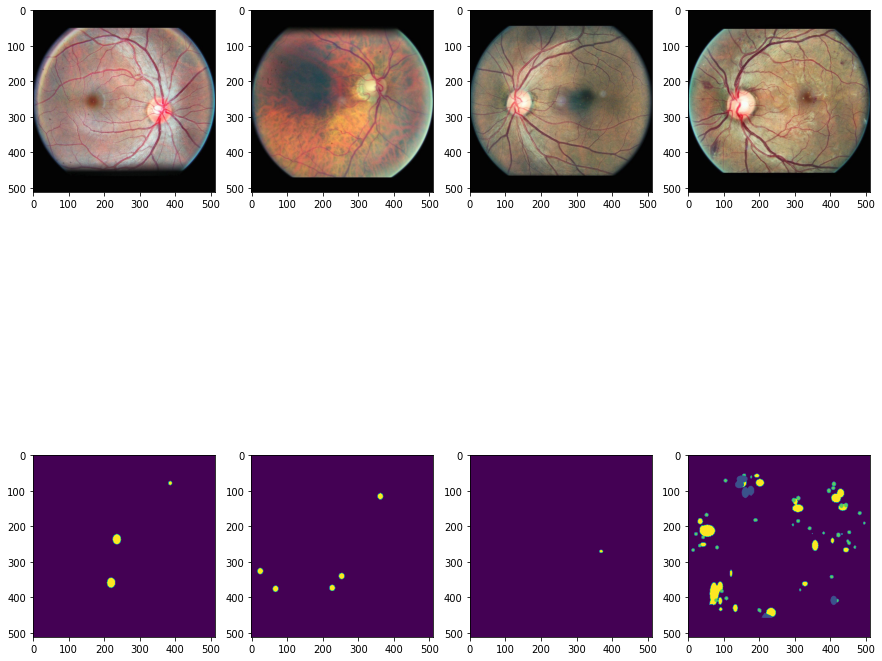

In [44]:
num_imgs = x.shape[0]
fig, ax = plt.subplots(2, num_imgs, figsize=(15, 15))

x_np = x.numpy()
y_np = y.numpy()

for i, (img, ann) in enumerate(zip(x_np, y_np)):
    
    img = np.transpose(img, (1,2,0))
    ax[0, i].imshow(img)
    ann = np.argmax(ann, axis=0)
    ax[1, i].imshow(ann)
    
plt.show()  
    

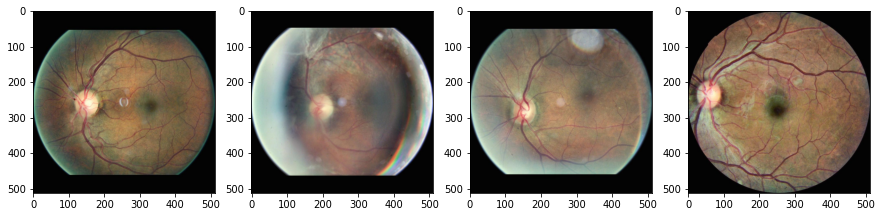

In [56]:
num_imgs = x.shape[0]
fig, ax = plt.subplots(1, num_imgs, figsize=(15, 15))

x_np = x.numpy()


for i, img in enumerate(x_np):
    
    img = np.transpose(img, (1,2,0))
    ax[i].imshow(img)
    
plt.show()  
    

## Metrics

In [37]:
class Dice(nn.Module):
    def __init__(self, num_classes):
        super(Dice, self).__init__()
        self.num_classes = num_classes

    def forward(self, prediction, target):
        prediction = torch.softmax(prediction, dim=1)
        prediction = prediction.view(prediction.size(0), self.num_classes, -1)
        target = target.view(target.size(0), self.num_classes, -1)
        intersection = (prediction * target).sum(dim=-1)
        union = prediction.sum(dim=-1) + target.sum(dim=-1)
        dice = 2 * intersection / union

        return dice.mean()

## Start of Training

### Declarations

The following will be instantiated:

- The U-Net
- The loss function
- The optimizer
- The scheduler

In [26]:
unet = UNet(3, 5, [64, 128, 256, 512, 1024], simple=False).to(device)

In [43]:
vgg_unet = VGGUNet(5, simple=True, attention=0, subtractive=False).to(device)

In [38]:
res_unet = ResNetUNet(5, simple=True, attention=0, subtractive=False).to(device)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [56]:
b4_unet = EfficientNetUNet(5, simple=True, attention=0, subtractive=True).to(device)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-7eb33cd5.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-7eb33cd5.pth


  0%|          | 0.00/74.5M [00:00<?, ?B/s]

In [40]:
pos_weight = torch.Tensor([1, 30, 7, 5, 10]).to(device)
loss_function = CrossEntropy4D(class_weights=pos_weight)
#loss_function = DiceBCELoss()
#loss_function = WeightedCrossEntropy(class_weights=pos_weight)
#loss_function = CrossEntropyLoss(weight=pos_weight, sigmoid=True)
#loss_function = DiceLoss(num_classes=5)
#loss_function = DiceCE(num_classes=5)
# loss_function = CompoundLoss(l1=True, lamb=1)
binary_loss = DiceBCELoss()
bcm_params = (3, binary_loss, 0.5)
optimizer = torch.optim.Adam(res_unet.parameters(), lr=1.5e-4)
#optimizer = torch.optim.SGD(res_unet.parameters(), lr=0.0001, momentum=0.95)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="max", factor=0.5, patience=2)

In [41]:
trainer = Trainer(res_unet, train_dl, 5,50, loss_function, optimizer, scheduler, patience=5)

Starting epoch : 1 -------------------------------------------------------------------


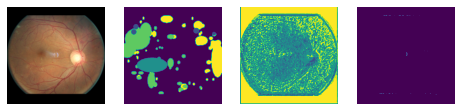

Plotting Activations


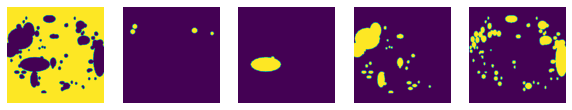

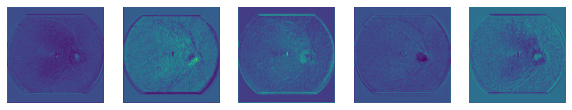

The loss on the first batch is : 2.490248918533325
Loss at epoch : 1 : 1.605
Running Validation Step


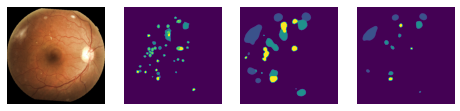

The loss on the first batch for validation is : 1.2168607711791992
Validation Loss at epoch : 1 : 1.211
Validation Dice Score at epoch : 1 : 0.207
Saved model at val dice : 0.207
Epoch : 1 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 2 -------------------------------------------------------------------


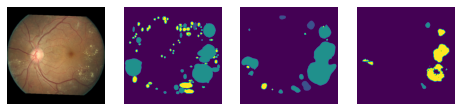

Plotting Activations


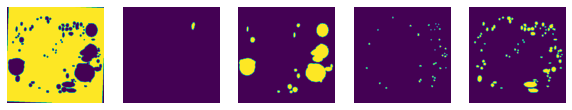

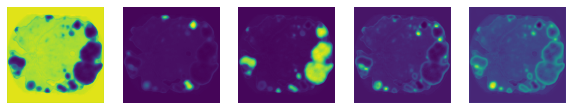

The loss on the first batch is : 1.489800214767456
Loss at epoch : 2 : 1.222
Running Validation Step


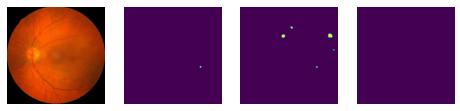

The loss on the first batch for validation is : 0.8274461030960083
Validation Loss at epoch : 2 : 1.007
Validation Dice Score at epoch : 2 : 0.244
Saved model at val dice : 0.244
Epoch : 2 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 3 -------------------------------------------------------------------


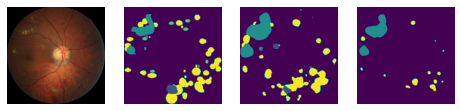

Plotting Activations


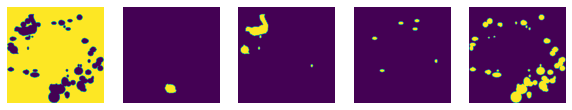

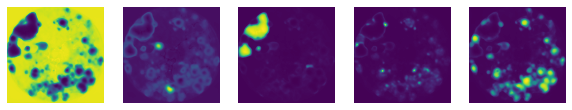

The loss on the first batch is : 0.9900047779083252
Loss at epoch : 3 : 1.122
Running Validation Step


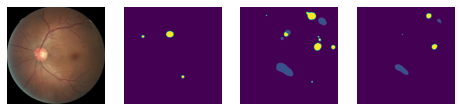

The loss on the first batch for validation is : 0.7613576650619507
Validation Loss at epoch : 3 : 0.939
Validation Dice Score at epoch : 3 : 0.261
Saved model at val dice : 0.261
Epoch : 3 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 4 -------------------------------------------------------------------


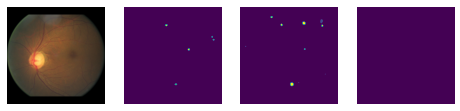

Plotting Activations


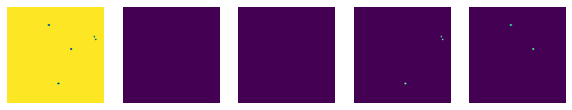

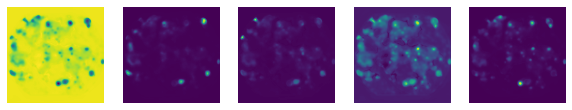

The loss on the first batch is : 0.8959860801696777
Loss at epoch : 4 : 1.07
Running Validation Step


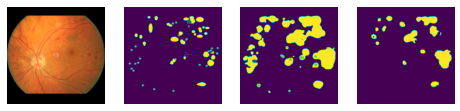

The loss on the first batch for validation is : 0.9813088178634644
Validation Loss at epoch : 4 : 0.895
Validation Dice Score at epoch : 4 : 0.276
Saved model at val dice : 0.276
Epoch : 4 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 5 -------------------------------------------------------------------


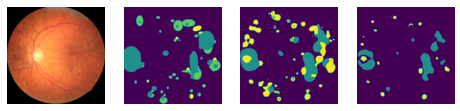

Plotting Activations


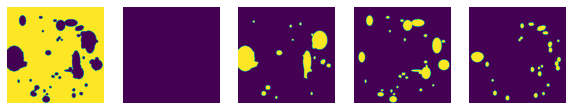

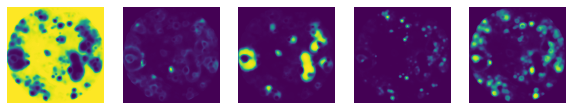

The loss on the first batch is : 1.0680660009384155
Loss at epoch : 5 : 1.044
Running Validation Step


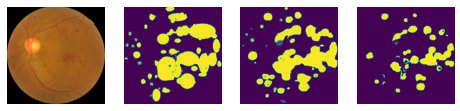

The loss on the first batch for validation is : 0.9956449866294861
Validation Loss at epoch : 5 : 0.849
Validation Dice Score at epoch : 5 : 0.298
Saved model at val dice : 0.298
Epoch : 5 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 6 -------------------------------------------------------------------


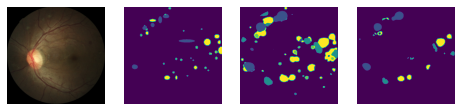

Plotting Activations


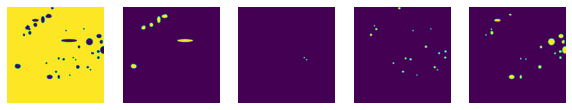

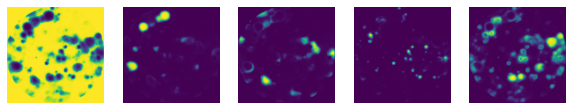

The loss on the first batch is : 0.907451868057251
Loss at epoch : 6 : 1.019
Running Validation Step


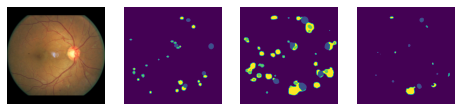

The loss on the first batch for validation is : 0.7075490951538086
Validation Loss at epoch : 6 : 0.844
Validation Dice Score at epoch : 6 : 0.294
Epoch : 6 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 7 -------------------------------------------------------------------


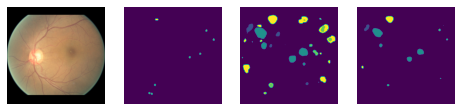

Plotting Activations


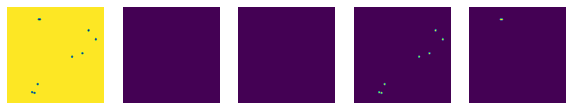

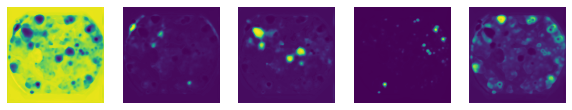

The loss on the first batch is : 1.0698529481887817
Loss at epoch : 7 : 0.998
Running Validation Step


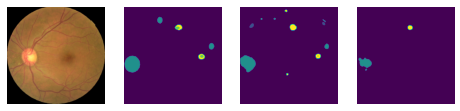

The loss on the first batch for validation is : 0.7105231881141663
Validation Loss at epoch : 7 : 0.811
Validation Dice Score at epoch : 7 : 0.313
Saved model at val dice : 0.313
Epoch : 7 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 8 -------------------------------------------------------------------


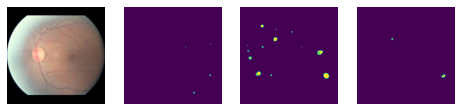

Plotting Activations


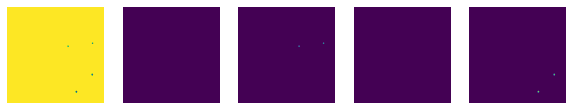

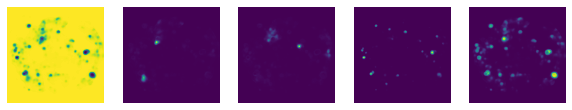

The loss on the first batch is : 0.9982205033302307
Loss at epoch : 8 : 1.001
Running Validation Step


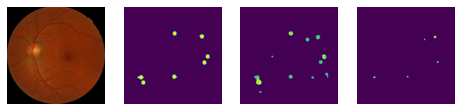

The loss on the first batch for validation is : 0.8445709347724915
Validation Loss at epoch : 8 : 0.788
Validation Dice Score at epoch : 8 : 0.311
Epoch : 8 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 9 -------------------------------------------------------------------


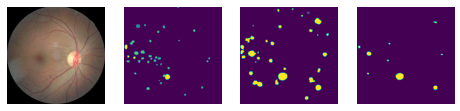

Plotting Activations


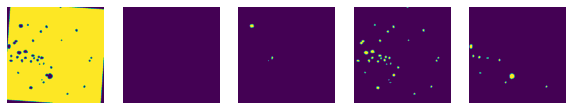

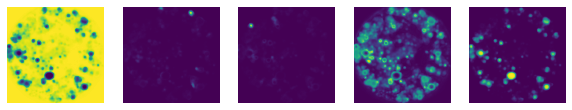

The loss on the first batch is : 1.2811272144317627
Loss at epoch : 9 : 0.995
Running Validation Step


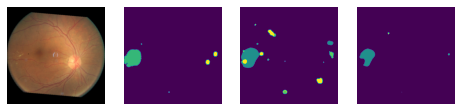

The loss on the first batch for validation is : 0.5912853479385376
Validation Loss at epoch : 9 : 0.819
Validation Dice Score at epoch : 9 : 0.315
Saved model at val dice : 0.315
Epoch : 9 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 10 -------------------------------------------------------------------


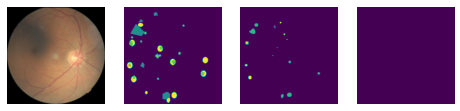

Plotting Activations


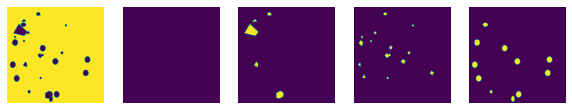

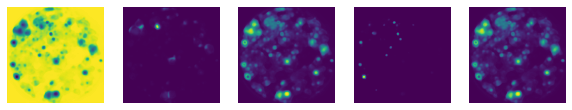

The loss on the first batch is : 1.08656907081604
Loss at epoch : 10 : 0.974
Running Validation Step


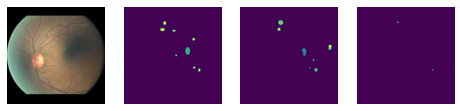

The loss on the first batch for validation is : 0.6059861779212952
Validation Loss at epoch : 10 : 0.774
Validation Dice Score at epoch : 10 : 0.318
Saved model at val dice : 0.318
Epoch : 10 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 11 -------------------------------------------------------------------


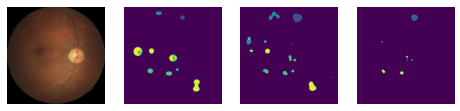

Plotting Activations


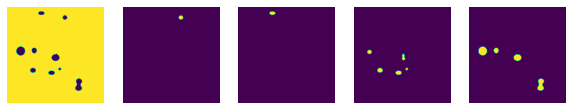

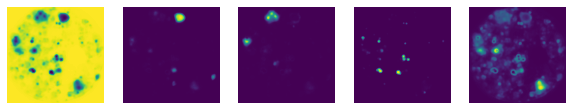

The loss on the first batch is : 1.030308723449707
Loss at epoch : 11 : 0.946
Running Validation Step


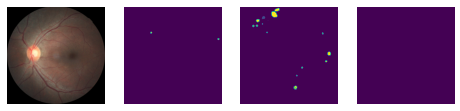

The loss on the first batch for validation is : 0.6663510203361511
Validation Loss at epoch : 11 : 0.787
Validation Dice Score at epoch : 11 : 0.324
Saved model at val dice : 0.324
Epoch : 11 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 12 -------------------------------------------------------------------


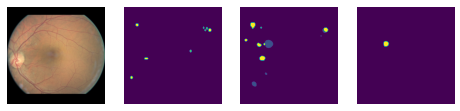

Plotting Activations


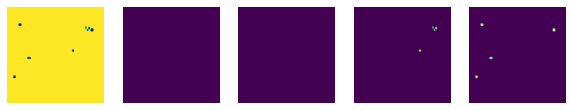

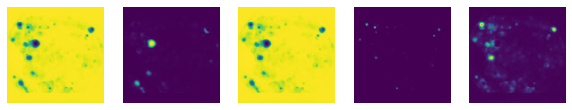

The loss on the first batch is : 1.1244540214538574
Loss at epoch : 12 : 0.964
Running Validation Step


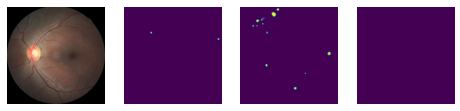

The loss on the first batch for validation is : 0.8884681463241577
Validation Loss at epoch : 12 : 0.76
Validation Dice Score at epoch : 12 : 0.317
Epoch : 12 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 13 -------------------------------------------------------------------


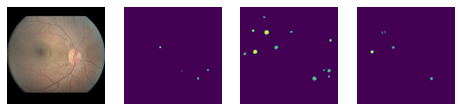

Plotting Activations


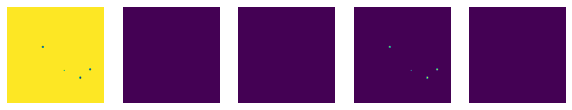

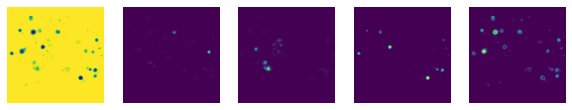

The loss on the first batch is : 0.6379841566085815
Loss at epoch : 13 : 0.943
Running Validation Step


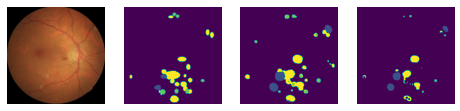

The loss on the first batch for validation is : 0.8676793575286865
Validation Loss at epoch : 13 : 0.76
Validation Dice Score at epoch : 13 : 0.326
Saved model at val dice : 0.326
Epoch : 13 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 14 -------------------------------------------------------------------


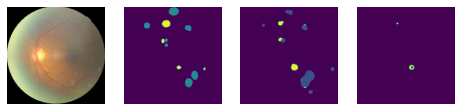

Plotting Activations


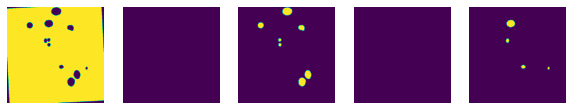

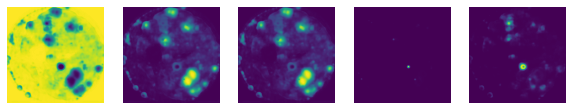

The loss on the first batch is : 0.794765055179596
Loss at epoch : 14 : 0.932
Running Validation Step


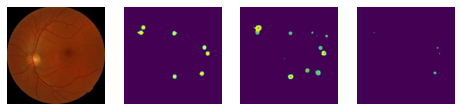

The loss on the first batch for validation is : 0.5105003714561462
Validation Loss at epoch : 14 : 0.779
Validation Dice Score at epoch : 14 : 0.32
Epoch : 14 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 15 -------------------------------------------------------------------


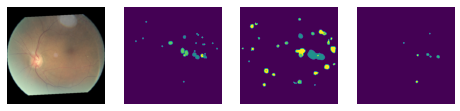

Plotting Activations


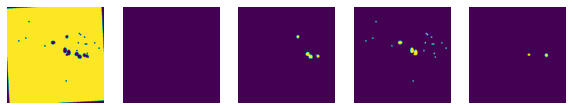

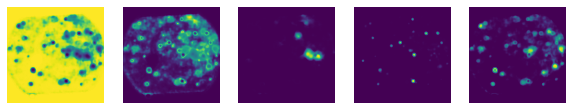

The loss on the first batch is : 0.7659335136413574
Loss at epoch : 15 : 0.924
Running Validation Step


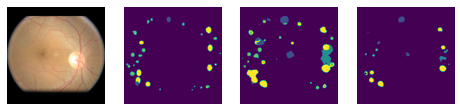

The loss on the first batch for validation is : 0.5540749430656433
Validation Loss at epoch : 15 : 0.76
Validation Dice Score at epoch : 15 : 0.334
Saved model at val dice : 0.334
Epoch : 15 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 16 -------------------------------------------------------------------


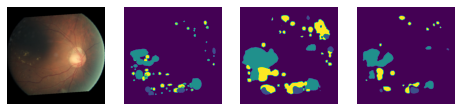

Plotting Activations


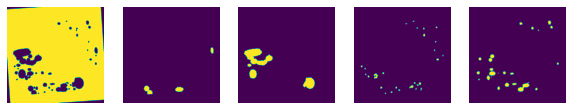

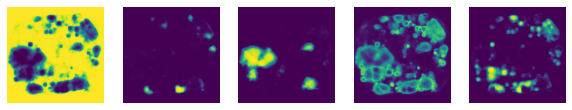

The loss on the first batch is : 0.9358745813369751
Loss at epoch : 16 : 0.933
Running Validation Step


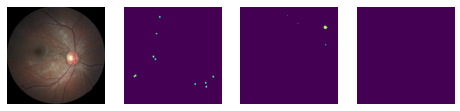

The loss on the first batch for validation is : 0.7608121633529663
Validation Loss at epoch : 16 : 0.768
Validation Dice Score at epoch : 16 : 0.325
Epoch : 16 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 17 -------------------------------------------------------------------


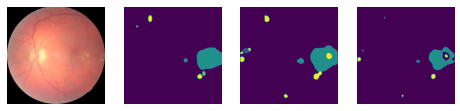

Plotting Activations


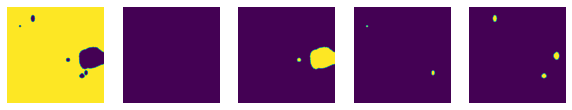

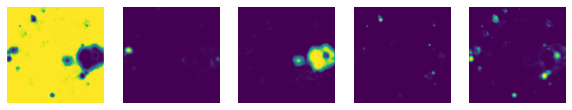

The loss on the first batch is : 1.1548244953155518
Loss at epoch : 17 : 0.905
Running Validation Step


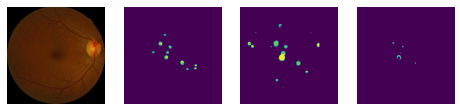

The loss on the first batch for validation is : 0.9364858865737915
Validation Loss at epoch : 17 : 0.765
Validation Dice Score at epoch : 17 : 0.336
Saved model at val dice : 0.336
Epoch : 17 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 18 -------------------------------------------------------------------


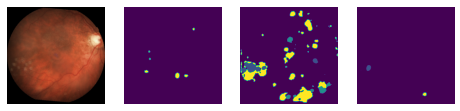

Plotting Activations


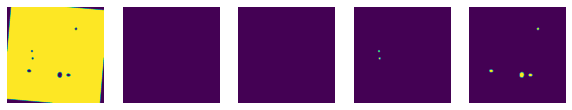

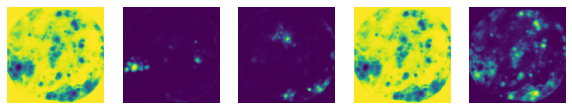

The loss on the first batch is : 0.9749472737312317
Loss at epoch : 18 : 0.909
Running Validation Step


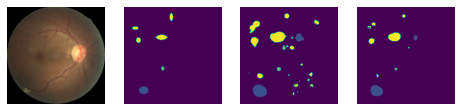

The loss on the first batch for validation is : 0.6335659027099609
Validation Loss at epoch : 18 : 0.756
Validation Dice Score at epoch : 18 : 0.323
Epoch : 18 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 19 -------------------------------------------------------------------


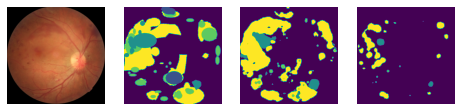

Plotting Activations


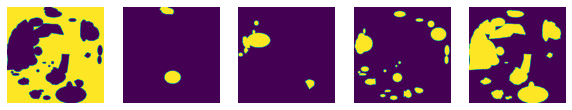

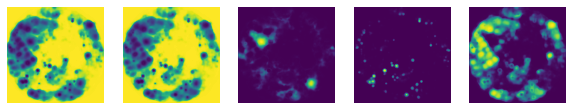

The loss on the first batch is : 1.552593469619751
Loss at epoch : 19 : 0.914
Running Validation Step


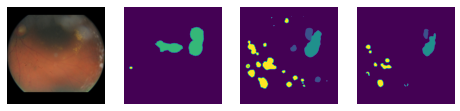

The loss on the first batch for validation is : 0.9023319482803345
Validation Loss at epoch : 19 : 0.828
Validation Dice Score at epoch : 19 : 0.31
Epoch : 19 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 20 -------------------------------------------------------------------


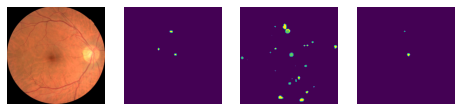

Plotting Activations


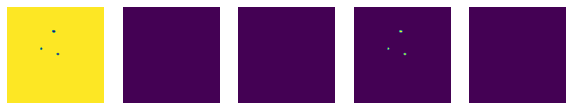

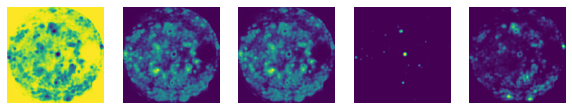

The loss on the first batch is : 0.8025463819503784
Loss at epoch : 20 : 0.906
Running Validation Step


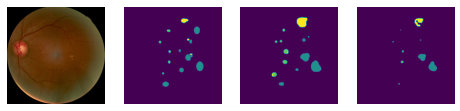

The loss on the first batch for validation is : 0.6976715922355652
Validation Loss at epoch : 20 : 0.785
Validation Dice Score at epoch : 20 : 0.343
Saved model at val dice : 0.343
Epoch : 20 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 21 -------------------------------------------------------------------


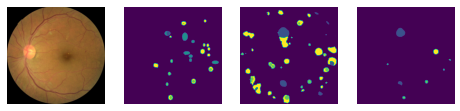

Plotting Activations


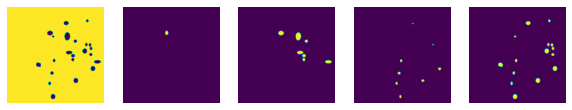

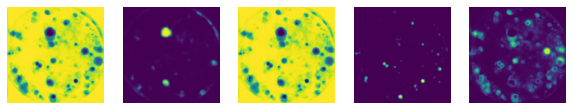

The loss on the first batch is : 0.9072880744934082
Loss at epoch : 21 : 0.898
Running Validation Step


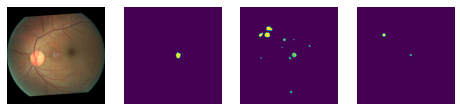

The loss on the first batch for validation is : 0.6727645397186279
Validation Loss at epoch : 21 : 0.777
Validation Dice Score at epoch : 21 : 0.317
Epoch : 21 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 22 -------------------------------------------------------------------


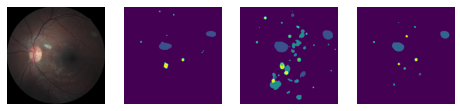

Plotting Activations


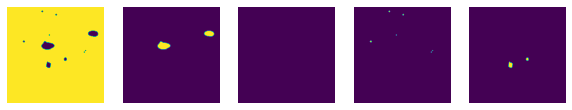

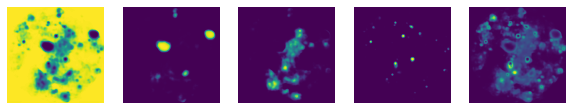

The loss on the first batch is : 0.8999103903770447
Loss at epoch : 22 : 0.91
Running Validation Step


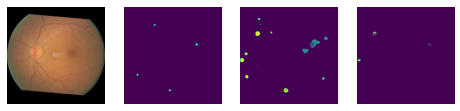

The loss on the first batch for validation is : 0.7596840858459473
Validation Loss at epoch : 22 : 0.789
Validation Dice Score at epoch : 22 : 0.344
Saved model at val dice : 0.344
Epoch : 22 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 23 -------------------------------------------------------------------


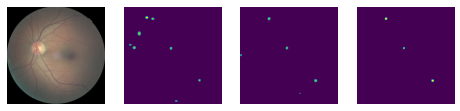

Plotting Activations


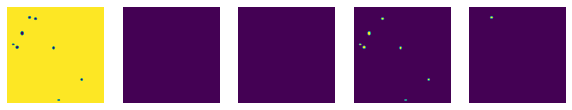

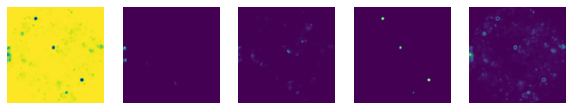

The loss on the first batch is : 0.9419915080070496
Loss at epoch : 23 : 0.889
Running Validation Step


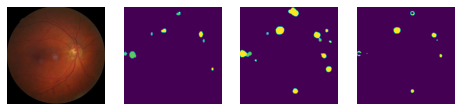

The loss on the first batch for validation is : 0.5219984650611877
Validation Loss at epoch : 23 : 0.777
Validation Dice Score at epoch : 23 : 0.327
Epoch : 23 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 24 -------------------------------------------------------------------


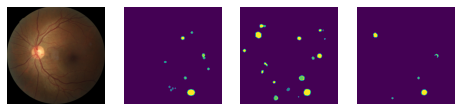

Plotting Activations


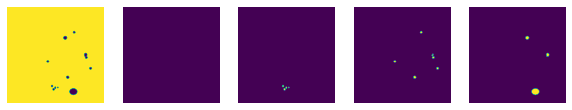

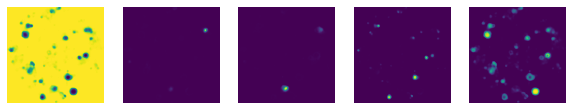

The loss on the first batch is : 0.5687833428382874
Loss at epoch : 24 : 0.887
Running Validation Step


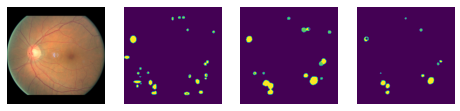

The loss on the first batch for validation is : 0.9231918454170227
Validation Loss at epoch : 24 : 0.799
Validation Dice Score at epoch : 24 : 0.35
Saved model at val dice : 0.35
Epoch : 24 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 25 -------------------------------------------------------------------


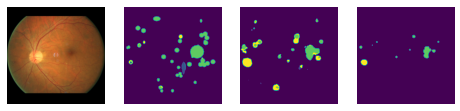

Plotting Activations


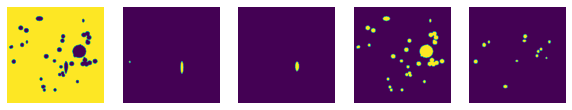

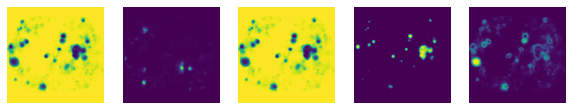

The loss on the first batch is : 1.2917383909225464
Loss at epoch : 25 : 0.878
Running Validation Step


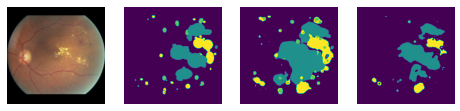

The loss on the first batch for validation is : 1.009217381477356
Validation Loss at epoch : 25 : 0.772
Validation Dice Score at epoch : 25 : 0.332
Epoch : 25 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 26 -------------------------------------------------------------------


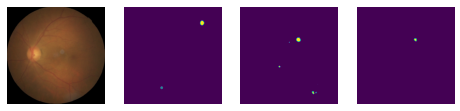

Plotting Activations


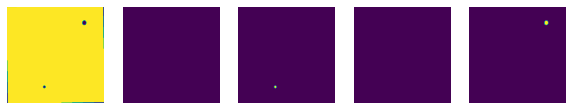

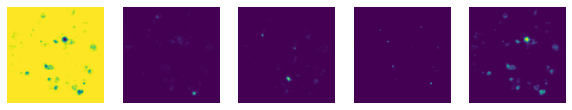

The loss on the first batch is : 0.7127367854118347
Loss at epoch : 26 : 0.865
Running Validation Step


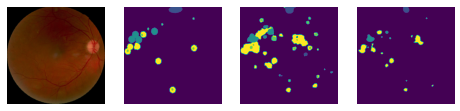

The loss on the first batch for validation is : 0.6823140978813171
Validation Loss at epoch : 26 : 0.779
Validation Dice Score at epoch : 26 : 0.353
Saved model at val dice : 0.353
Epoch : 26 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 27 -------------------------------------------------------------------


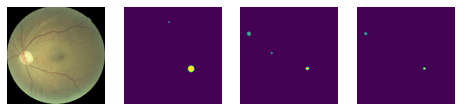

Plotting Activations


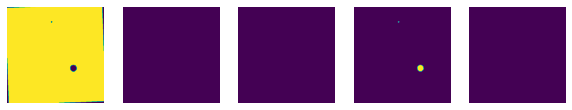

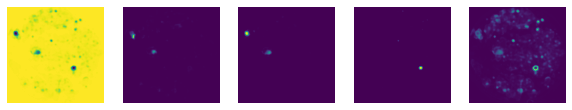

The loss on the first batch is : 0.7747126221656799
Loss at epoch : 27 : 0.864
Running Validation Step


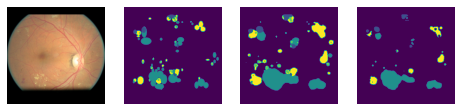

The loss on the first batch for validation is : 0.9467856884002686
Validation Loss at epoch : 27 : 0.769
Validation Dice Score at epoch : 27 : 0.351
Epoch : 27 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 28 -------------------------------------------------------------------


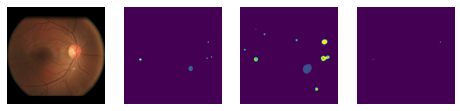

Plotting Activations


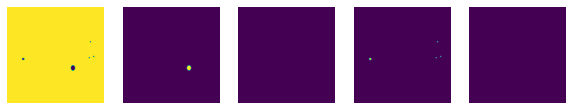

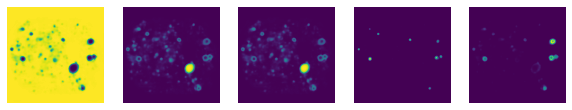

The loss on the first batch is : 0.7765703201293945
Loss at epoch : 28 : 0.857
Running Validation Step


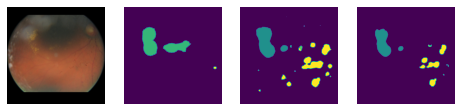

The loss on the first batch for validation is : 0.9445644617080688
Validation Loss at epoch : 28 : 0.805
Validation Dice Score at epoch : 28 : 0.354
Saved model at val dice : 0.354
Epoch : 28 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 29 -------------------------------------------------------------------


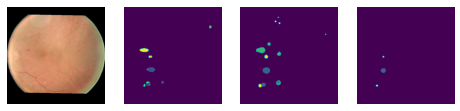

Plotting Activations


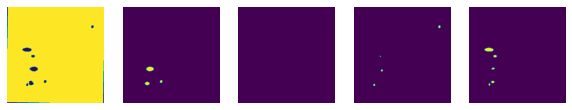

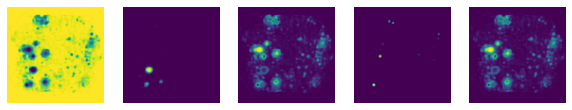

The loss on the first batch is : 0.7797901034355164
Loss at epoch : 29 : 0.861
Running Validation Step


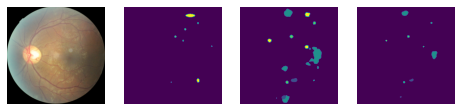

The loss on the first batch for validation is : 0.8250160217285156
Validation Loss at epoch : 29 : 0.795
Validation Dice Score at epoch : 29 : 0.354
Epoch : 29 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 30 -------------------------------------------------------------------


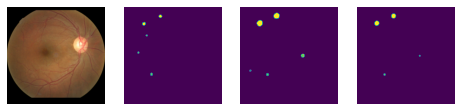

Plotting Activations


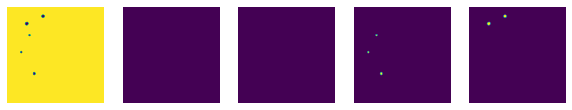

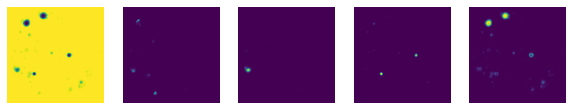

The loss on the first batch is : 0.8864260315895081
Loss at epoch : 30 : 0.847
Running Validation Step


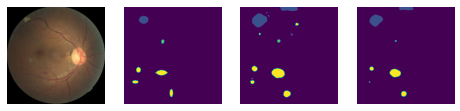

The loss on the first batch for validation is : 0.5506991147994995
Validation Loss at epoch : 30 : 0.82
Validation Dice Score at epoch : 30 : 0.34
Epoch : 30 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 31 -------------------------------------------------------------------


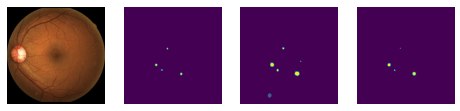

Plotting Activations


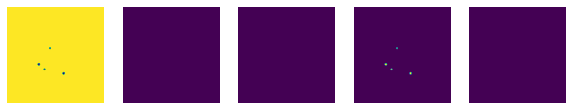

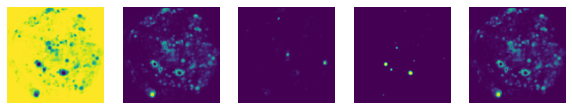

The loss on the first batch is : 0.3846461772918701
Loss at epoch : 31 : 0.864
Running Validation Step


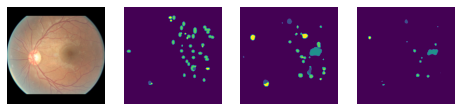

The loss on the first batch for validation is : 0.7029114961624146
Validation Loss at epoch : 31 : 0.77
Validation Dice Score at epoch : 31 : 0.343
Epoch : 31 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 32 -------------------------------------------------------------------


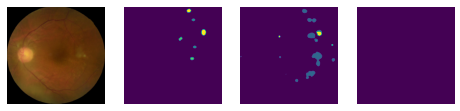

Plotting Activations


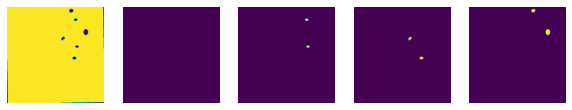

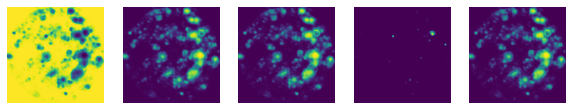

The loss on the first batch is : 0.6700836420059204
Loss at epoch : 32 : 0.822
Running Validation Step


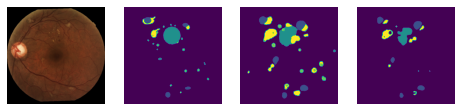

The loss on the first batch for validation is : 0.6473277807235718
Validation Loss at epoch : 32 : 0.797
Validation Dice Score at epoch : 32 : 0.348
Epoch : 32 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 33 -------------------------------------------------------------------


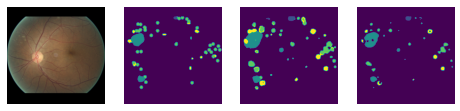

Plotting Activations


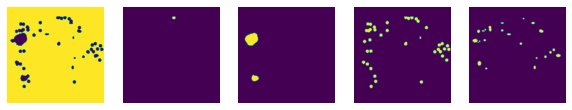

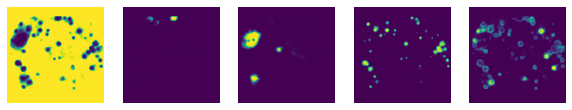

The loss on the first batch is : 1.1909945011138916
Loss at epoch : 33 : 0.828
Running Validation Step


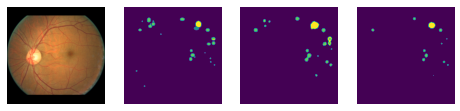

The loss on the first batch for validation is : 0.6412258148193359
Validation Loss at epoch : 33 : 0.792
Validation Dice Score at epoch : 33 : 0.356
Saved model at val dice : 0.356
Epoch : 33 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 34 -------------------------------------------------------------------


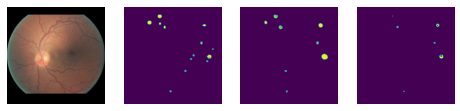

Plotting Activations


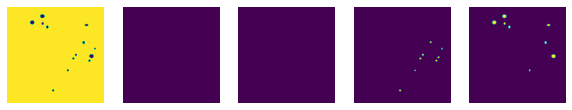

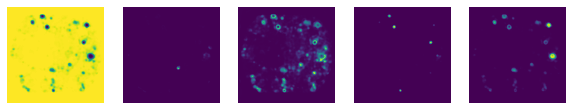

The loss on the first batch is : 0.9983280897140503
Loss at epoch : 34 : 0.803
Running Validation Step


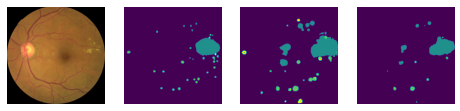

The loss on the first batch for validation is : 0.8551657199859619
Validation Loss at epoch : 34 : 0.823
Validation Dice Score at epoch : 34 : 0.358
Saved model at val dice : 0.358
Epoch : 34 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 35 -------------------------------------------------------------------


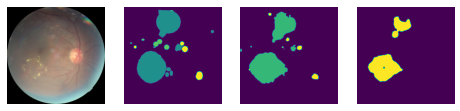

Plotting Activations


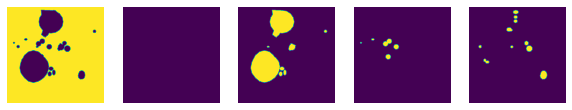

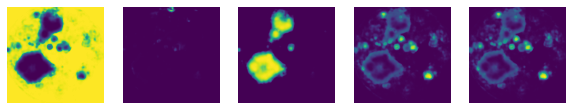

The loss on the first batch is : 1.232147455215454
Loss at epoch : 35 : 0.817
Running Validation Step


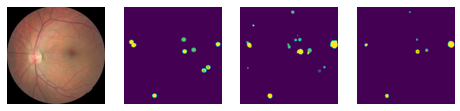

The loss on the first batch for validation is : 0.7590395212173462
Validation Loss at epoch : 35 : 0.822
Validation Dice Score at epoch : 35 : 0.346
Epoch : 35 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 36 -------------------------------------------------------------------


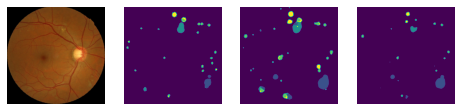

Plotting Activations


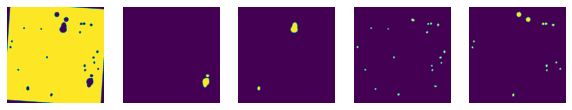

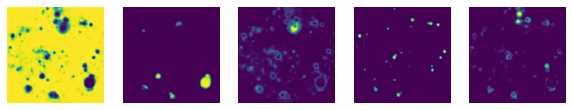

The loss on the first batch is : 1.0974900722503662
Loss at epoch : 36 : 0.808
Running Validation Step


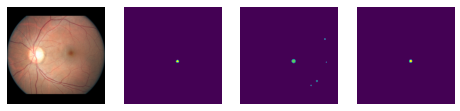

The loss on the first batch for validation is : 0.6861591339111328
Validation Loss at epoch : 36 : 0.828
Validation Dice Score at epoch : 36 : 0.36
Saved model at val dice : 0.36
Epoch : 36 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 37 -------------------------------------------------------------------


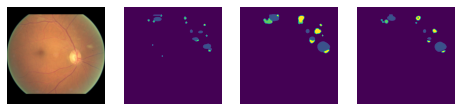

Plotting Activations


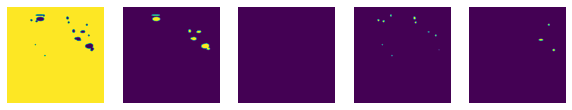

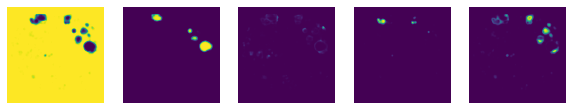

The loss on the first batch is : 0.8096160292625427
Loss at epoch : 37 : 0.804
Running Validation Step


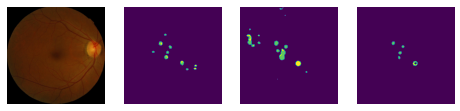

The loss on the first batch for validation is : 0.7984820008277893
Validation Loss at epoch : 37 : 0.844
Validation Dice Score at epoch : 37 : 0.36
Epoch : 37 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 38 -------------------------------------------------------------------


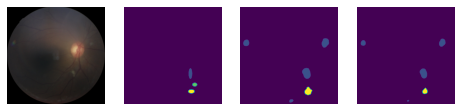

Plotting Activations


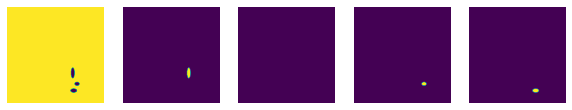

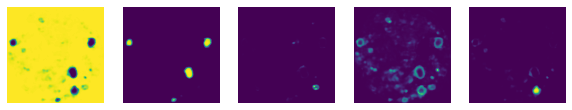

The loss on the first batch is : 0.8045854568481445
Loss at epoch : 38 : 0.817
Running Validation Step


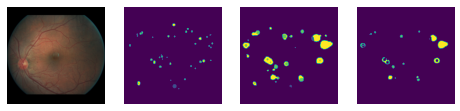

The loss on the first batch for validation is : 0.7140709757804871
Validation Loss at epoch : 38 : 0.804
Validation Dice Score at epoch : 38 : 0.368
Saved model at val dice : 0.368
Epoch : 38 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 39 -------------------------------------------------------------------


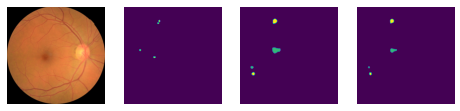

Plotting Activations


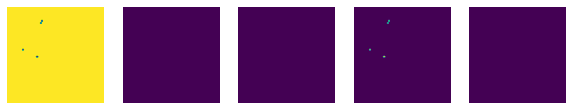

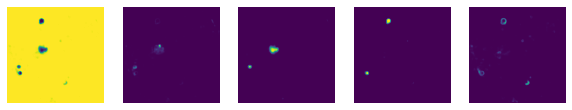

The loss on the first batch is : 0.7063186764717102
Loss at epoch : 39 : 0.79
Running Validation Step


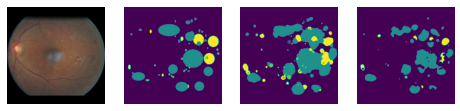

The loss on the first batch for validation is : 0.8664032220840454
Validation Loss at epoch : 39 : 0.82
Validation Dice Score at epoch : 39 : 0.358
Epoch : 39 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 40 -------------------------------------------------------------------


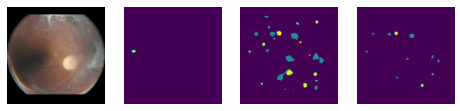

Plotting Activations


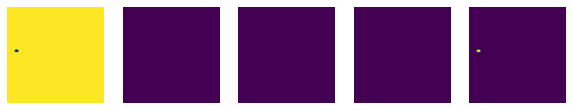

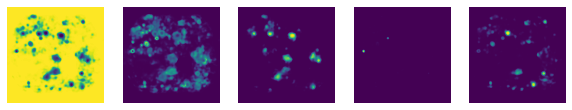

The loss on the first batch is : 0.5816198587417603
Loss at epoch : 40 : 0.811
Running Validation Step


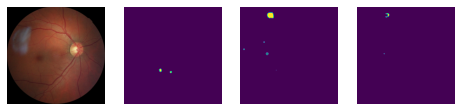

The loss on the first batch for validation is : 0.6323274970054626
Validation Loss at epoch : 40 : 0.846
Validation Dice Score at epoch : 40 : 0.358
Epoch : 40 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 41 -------------------------------------------------------------------


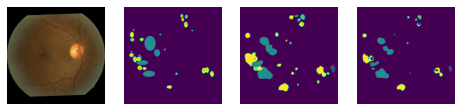

Plotting Activations


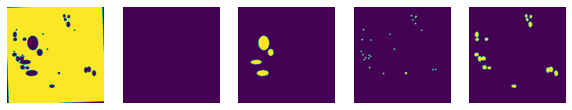

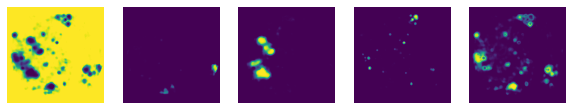

The loss on the first batch is : 0.7164083123207092
Loss at epoch : 41 : 0.792
Running Validation Step


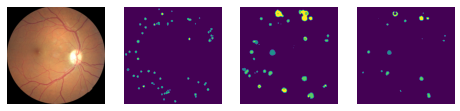

The loss on the first batch for validation is : 1.05099618434906
Validation Loss at epoch : 41 : 0.814
Validation Dice Score at epoch : 41 : 0.351
Epoch : 41 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 42 -------------------------------------------------------------------


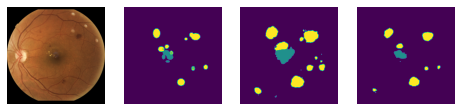

Plotting Activations


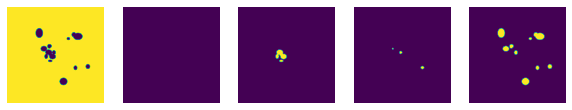

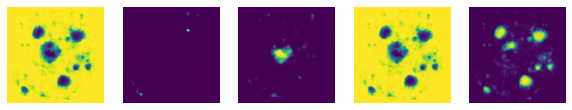

The loss on the first batch is : 1.0116087198257446
Loss at epoch : 42 : 0.771
Running Validation Step


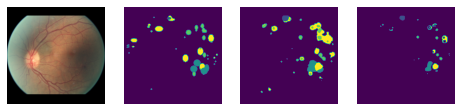

The loss on the first batch for validation is : 1.1047992706298828
Validation Loss at epoch : 42 : 0.832
Validation Dice Score at epoch : 42 : 0.359
Epoch : 42 took 1 mins : 15 seconds


------------------------------------------------------------------------------------------






Starting epoch : 43 -------------------------------------------------------------------


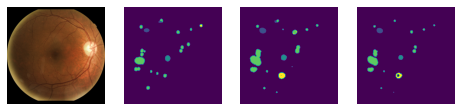

Plotting Activations


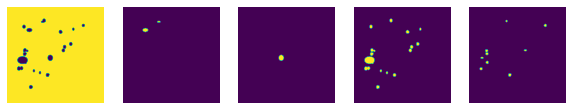

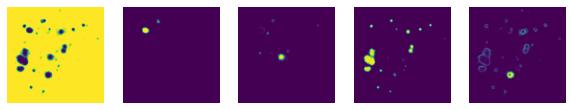

The loss on the first batch is : 0.9174284934997559
Loss at epoch : 43 : 0.773
Running Validation Step


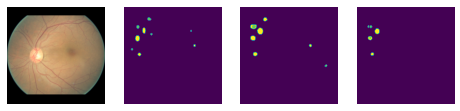

The loss on the first batch for validation is : 0.5742975473403931
Validation Loss at epoch : 43 : 0.887
Validation Dice Score at epoch : 43 : 0.367
Epoch : 43 took 1 mins : 16 seconds


------------------------------------------------------------------------------------------






Starting epoch : 44 -------------------------------------------------------------------


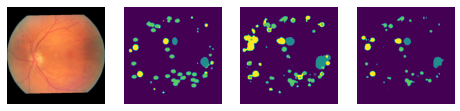

Plotting Activations


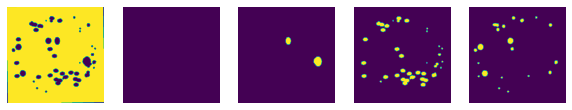

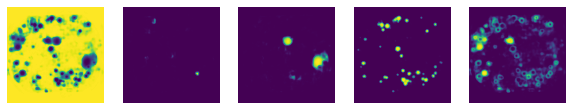

The loss on the first batch is : 0.5380264520645142
Loss at epoch : 44 : 0.773
Running Validation Step


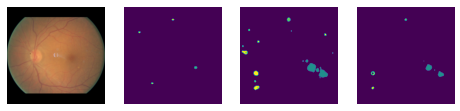

The loss on the first batch for validation is : 0.4984385073184967
Validation Loss at epoch : 44 : 0.855
Validation Dice Score at epoch : 44 : 0.364
Early Stopping kicked in : Stopping at epoch 44


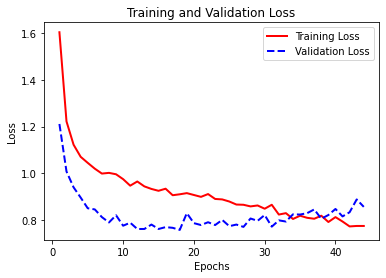

In [42]:
trainer.fit(log=True, validation=True, valid_dl=valid_dl, model_checkpoint=True, bcm_params=bcm_params,model_save_path="./model_weights/stage_15_bcm/simple_res_05.pth")



### Multi-Task Training

In [39]:
vgg_unet = VGGUNet(5, simple=True, attention=0).to(device)

In [49]:
res_unet = ResNetUNet(5, simple=True, attention=0).to(device)

In [43]:
b4_unet = EfficientNetUNet(5, simple=True, attention=1).to(device)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-7eb33cd5.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-7eb33cd5.pth


  0%|          | 0.00/74.5M [00:00<?, ?B/s]

In [40]:
pos_weight = torch.Tensor([1, 35, 7, 5, 12]).to(device)
seg_loss_function = CrossEntropy4D(class_weights=pos_weight)
#seg_loss_function = DiceLoss(num_classes=5)
# seg_loss_function = DiceCE(5)
#seg_loss_function = CompoundLoss(l1=False, lamb=0.1)
#seg_loss_function = WeightedCrossEntropy(class_weights=pos_weight)
#clf_loss_function = DiceCLFLoss()
clf_loss_function = MultiLabelBCEWithLogitsLoss()
loss_function = MultiTaskLoss(seg_loss=seg_loss_function, clf_loss=clf_loss_function, beta=0.5)
#loss_function = DiceLoss(num_classes=5)
#loss_function = DiceCE(num_classes=5, class_weights=pos_weight)
# binary_loss = DiceBCELoss()
# bcm_params = (3, binary_loss, 0.15)
optimizer = torch.optim.Adam(vgg_unet.parameters(), lr=1.5e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.5, patience=2)

In [41]:
trainer = Trainer(vgg_unet, train_dl, 5,50, loss_function, optimizer, scheduler, patience=5)

Starting epoch : 1 -------------------------------------------------------------------


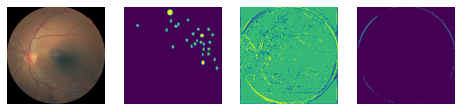

Plotting Activations


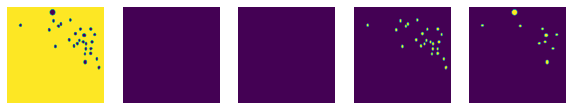

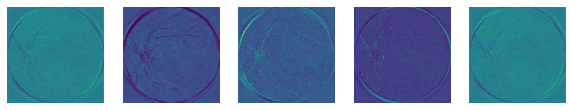

The loss on the first batch is : 2.005683183670044
Loss at epoch : 1 : 1.247
Running Validation Step


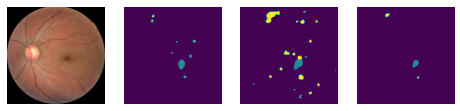

The loss on the first batch for validation is : 0.6759558916091919
Validation Loss at epoch : 1 : 0.916
Validation Dice Score at epoch : 1 : 0.207
Saved model at val dice : 0.207
Epoch : 1 took 2 mins : 9 seconds


------------------------------------------------------------------------------------------






Starting epoch : 2 -------------------------------------------------------------------


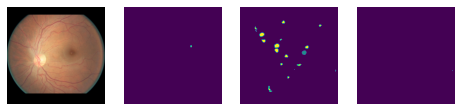

Plotting Activations


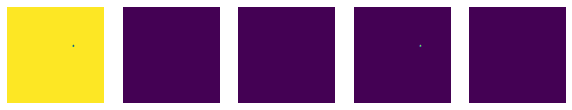

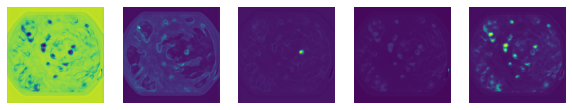

The loss on the first batch is : 0.964009165763855
Loss at epoch : 2 : 0.981
Running Validation Step


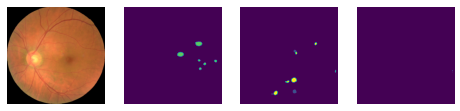

The loss on the first batch for validation is : 0.6211546659469604
Validation Loss at epoch : 2 : 0.807
Validation Dice Score at epoch : 2 : 0.235
Saved model at val dice : 0.235
Epoch : 2 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 3 -------------------------------------------------------------------


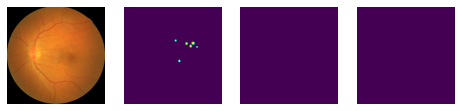

Plotting Activations


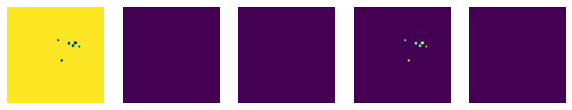

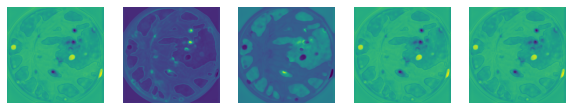

The loss on the first batch is : 0.977764368057251
Loss at epoch : 3 : 0.921
Running Validation Step


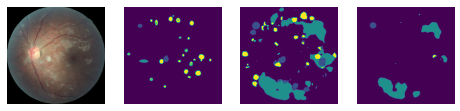

The loss on the first batch for validation is : 0.7077246904373169
Validation Loss at epoch : 3 : 0.777
Validation Dice Score at epoch : 3 : 0.248
Saved model at val dice : 0.248
Epoch : 3 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 4 -------------------------------------------------------------------


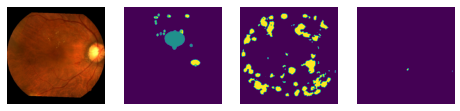

Plotting Activations


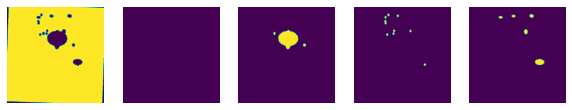

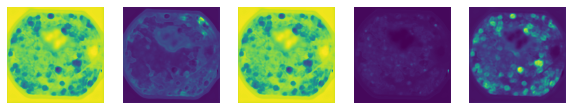

The loss on the first batch is : 1.05877685546875
Loss at epoch : 4 : 0.864
Running Validation Step


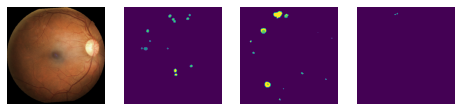

The loss on the first batch for validation is : 0.6714503765106201
Validation Loss at epoch : 4 : 0.791
Validation Dice Score at epoch : 4 : 0.249
Saved model at val dice : 0.249
Epoch : 4 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 5 -------------------------------------------------------------------


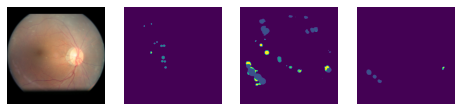

Plotting Activations


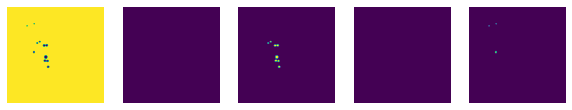

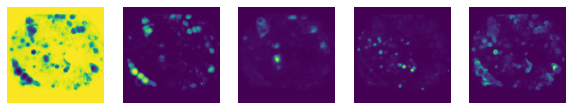

The loss on the first batch is : 0.9313421249389648
Loss at epoch : 5 : 0.841
Running Validation Step


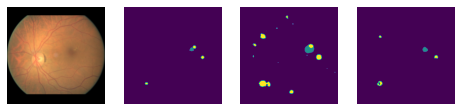

The loss on the first batch for validation is : 0.7091437578201294
Validation Loss at epoch : 5 : 0.725
Validation Dice Score at epoch : 5 : 0.268
Saved model at val dice : 0.268
Epoch : 5 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 6 -------------------------------------------------------------------


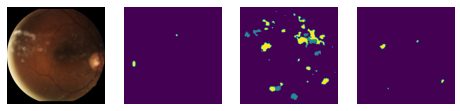

Plotting Activations


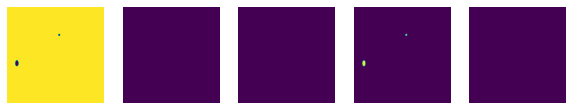

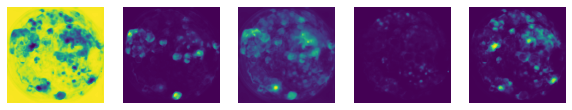

The loss on the first batch is : 0.7571883201599121
Loss at epoch : 6 : 0.821
Running Validation Step


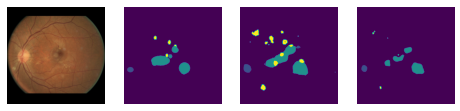

The loss on the first batch for validation is : 0.8588961362838745
Validation Loss at epoch : 6 : 0.732
Validation Dice Score at epoch : 6 : 0.27
Saved model at val dice : 0.27
Epoch : 6 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 7 -------------------------------------------------------------------


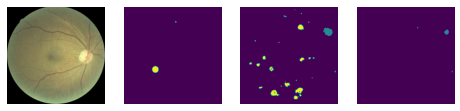

Plotting Activations


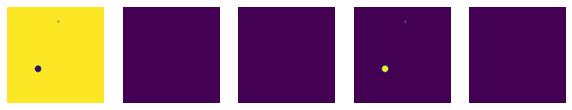

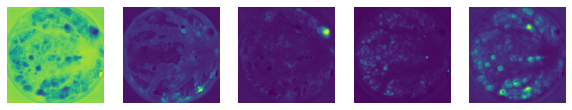

The loss on the first batch is : 0.6708132028579712
Loss at epoch : 7 : 0.801
Running Validation Step


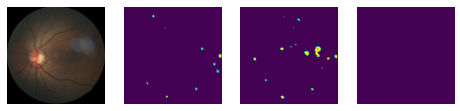

The loss on the first batch for validation is : 0.5790871381759644
Validation Loss at epoch : 7 : 0.722
Validation Dice Score at epoch : 7 : 0.26
Epoch : 7 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 8 -------------------------------------------------------------------


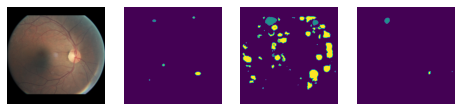

Plotting Activations


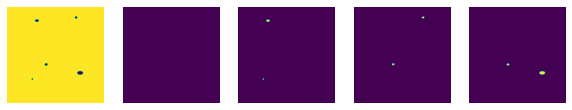

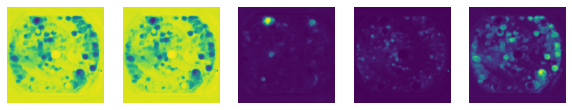

The loss on the first batch is : 0.7728992700576782
Loss at epoch : 8 : 0.784
Running Validation Step


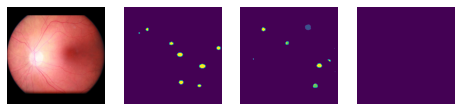

The loss on the first batch for validation is : 0.7216477394104004
Validation Loss at epoch : 8 : 0.695
Validation Dice Score at epoch : 8 : 0.281
Saved model at val dice : 0.281
Epoch : 8 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 9 -------------------------------------------------------------------


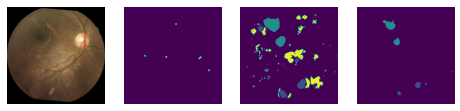

Plotting Activations


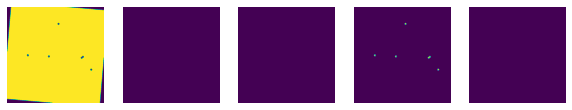

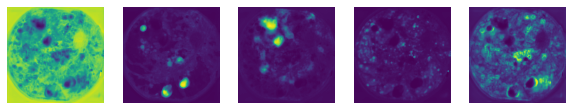

The loss on the first batch is : 0.9217394590377808
Loss at epoch : 9 : 0.765
Running Validation Step


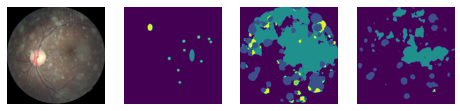

The loss on the first batch for validation is : 0.771314263343811
Validation Loss at epoch : 9 : 0.687
Validation Dice Score at epoch : 9 : 0.277
Epoch : 9 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 10 -------------------------------------------------------------------


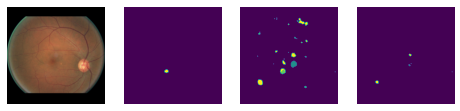

Plotting Activations


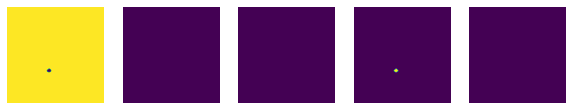

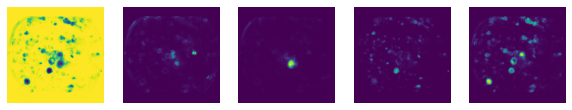

The loss on the first batch is : 0.5756410956382751
Loss at epoch : 10 : 0.765
Running Validation Step


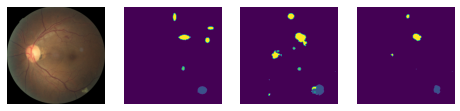

The loss on the first batch for validation is : 0.5086638927459717
Validation Loss at epoch : 10 : 0.704
Validation Dice Score at epoch : 10 : 0.287
Saved model at val dice : 0.287
Epoch : 10 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 11 -------------------------------------------------------------------


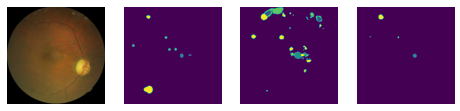

Plotting Activations


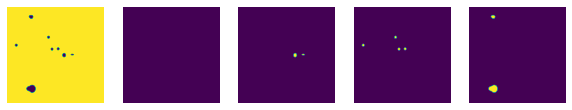

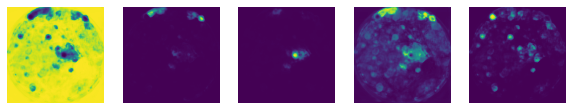

The loss on the first batch is : 0.6748424768447876
Loss at epoch : 11 : 0.749
Running Validation Step


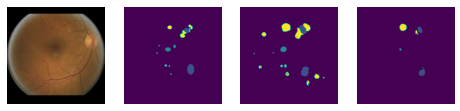

The loss on the first batch for validation is : 0.5224721431732178
Validation Loss at epoch : 11 : 0.691
Validation Dice Score at epoch : 11 : 0.283
Epoch : 11 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 12 -------------------------------------------------------------------


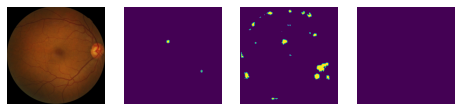

Plotting Activations


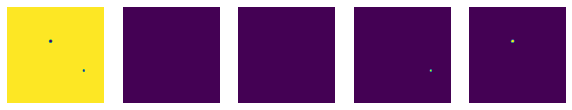

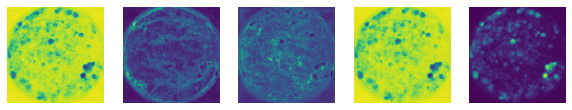

The loss on the first batch is : 1.1306819915771484
Loss at epoch : 12 : 0.753
Running Validation Step


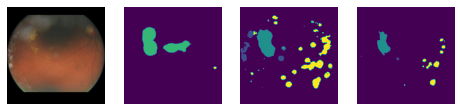

The loss on the first batch for validation is : 1.2074103355407715
Validation Loss at epoch : 12 : 0.695
Validation Dice Score at epoch : 12 : 0.285
Epoch : 12 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 13 -------------------------------------------------------------------


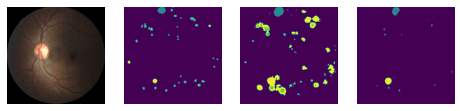

Plotting Activations


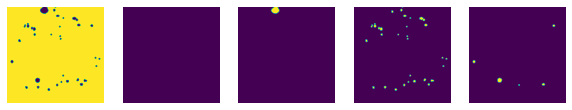

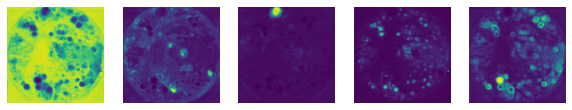

The loss on the first batch is : 0.7311971187591553
Loss at epoch : 13 : 0.726
Running Validation Step


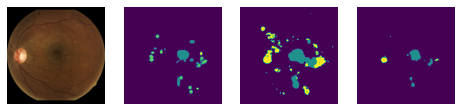

The loss on the first batch for validation is : 0.5983513593673706
Validation Loss at epoch : 13 : 0.685
Validation Dice Score at epoch : 13 : 0.29
Saved model at val dice : 0.29
Epoch : 13 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 14 -------------------------------------------------------------------


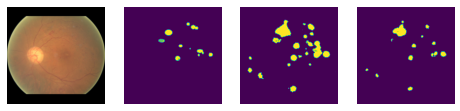

Plotting Activations


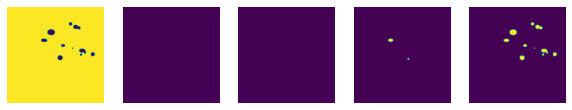

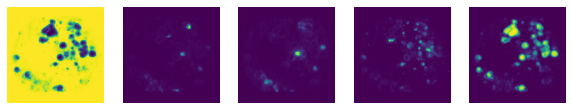

The loss on the first batch is : 0.5129221677780151
Loss at epoch : 14 : 0.729
Running Validation Step


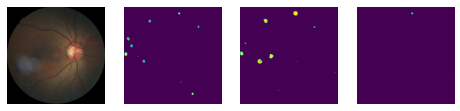

The loss on the first batch for validation is : 0.912724494934082
Validation Loss at epoch : 14 : 0.705
Validation Dice Score at epoch : 14 : 0.291
Saved model at val dice : 0.291
Epoch : 14 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 15 -------------------------------------------------------------------


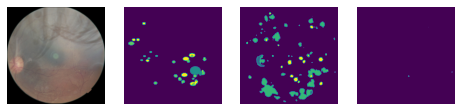

Plotting Activations


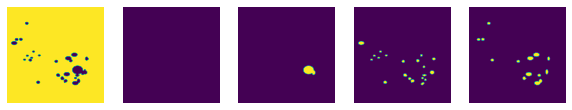

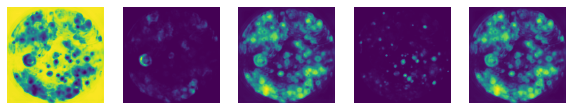

The loss on the first batch is : 0.7980528473854065
Loss at epoch : 15 : 0.723
Running Validation Step


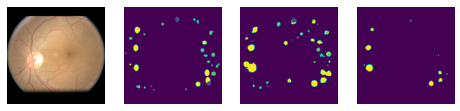

The loss on the first batch for validation is : 0.6766997575759888
Validation Loss at epoch : 15 : 0.677
Validation Dice Score at epoch : 15 : 0.291
Epoch : 15 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 16 -------------------------------------------------------------------


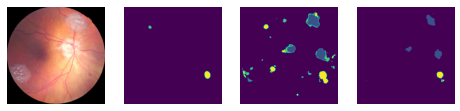

Plotting Activations


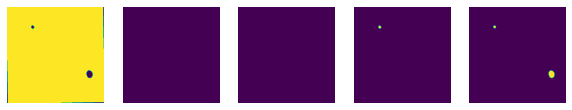

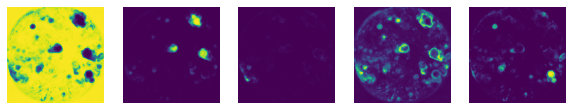

The loss on the first batch is : 0.7101783752441406
Loss at epoch : 16 : 0.726
Running Validation Step


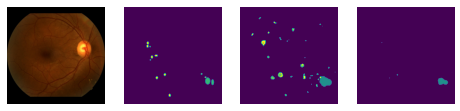

The loss on the first batch for validation is : 0.5684815645217896
Validation Loss at epoch : 16 : 0.687
Validation Dice Score at epoch : 16 : 0.286
Epoch : 16 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 17 -------------------------------------------------------------------


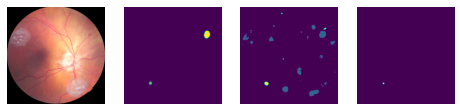

Plotting Activations


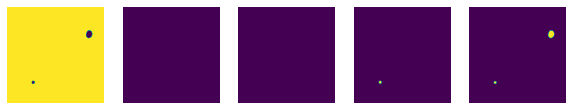

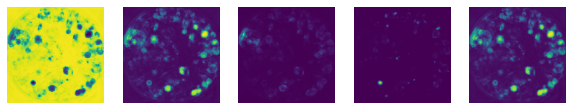

The loss on the first batch is : 0.5619035959243774
Loss at epoch : 17 : 0.715
Running Validation Step


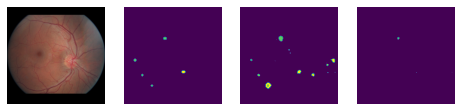

The loss on the first batch for validation is : 0.9888254404067993
Validation Loss at epoch : 17 : 0.685
Validation Dice Score at epoch : 17 : 0.29
Epoch : 17 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 18 -------------------------------------------------------------------


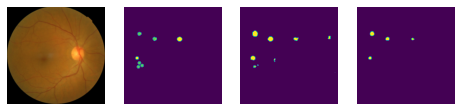

Plotting Activations


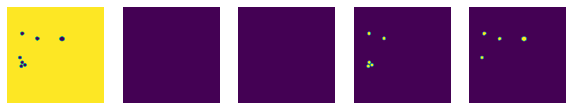

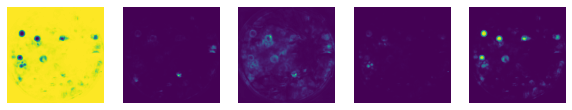

The loss on the first batch is : 0.7430331707000732
Loss at epoch : 18 : 0.709
Running Validation Step


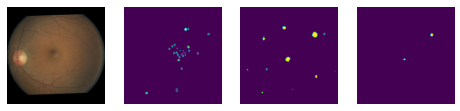

The loss on the first batch for validation is : 0.696510374546051
Validation Loss at epoch : 18 : 0.694
Validation Dice Score at epoch : 18 : 0.288
Epoch : 18 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 19 -------------------------------------------------------------------


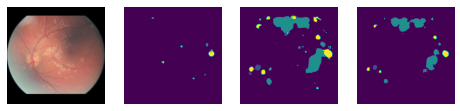

Plotting Activations


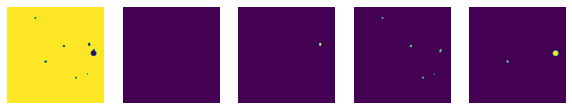

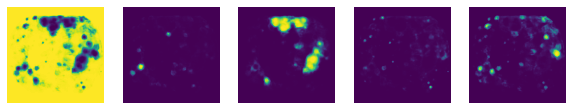

The loss on the first batch is : 0.6573731899261475
Loss at epoch : 19 : 0.706
Running Validation Step


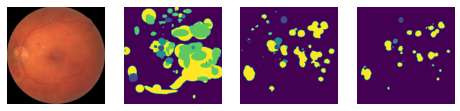

The loss on the first batch for validation is : 1.622340202331543
Validation Loss at epoch : 19 : 0.691
Validation Dice Score at epoch : 19 : 0.292
Saved model at val dice : 0.292
Epoch : 19 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 20 -------------------------------------------------------------------


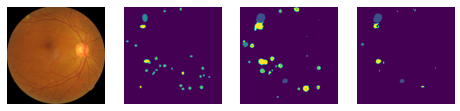

Plotting Activations


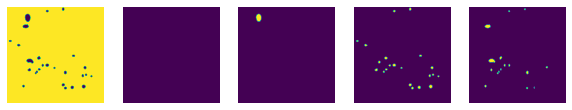

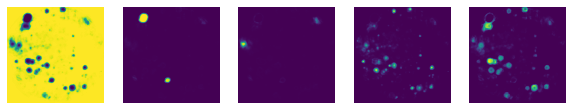

The loss on the first batch is : 0.994294285774231
Loss at epoch : 20 : 0.711
Running Validation Step


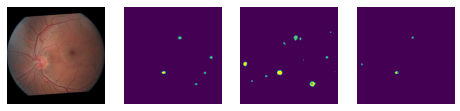

The loss on the first batch for validation is : 0.8198658227920532
Validation Loss at epoch : 20 : 0.683
Validation Dice Score at epoch : 20 : 0.29
Epoch : 20 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 21 -------------------------------------------------------------------


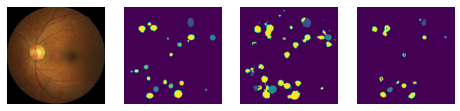

Plotting Activations


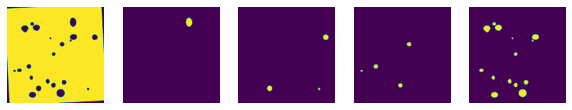

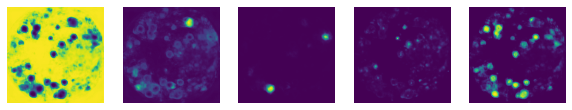

The loss on the first batch is : 0.5115882158279419
Loss at epoch : 21 : 0.71
Running Validation Step


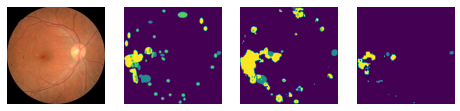

The loss on the first batch for validation is : 0.5169661045074463
Validation Loss at epoch : 21 : 0.698
Validation Dice Score at epoch : 21 : 0.29
Epoch : 21 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 22 -------------------------------------------------------------------


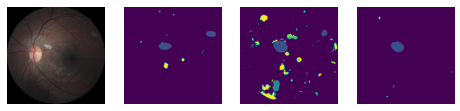

Plotting Activations


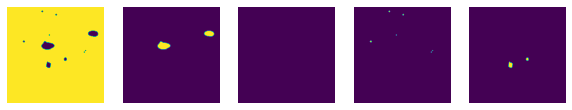

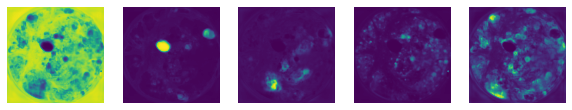

The loss on the first batch is : 0.7036275267601013
Loss at epoch : 22 : 0.718
Running Validation Step


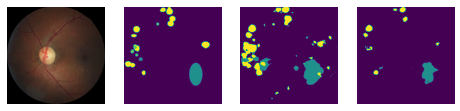

The loss on the first batch for validation is : 0.5594097375869751
Validation Loss at epoch : 22 : 0.682
Validation Dice Score at epoch : 22 : 0.29
Epoch : 22 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 23 -------------------------------------------------------------------


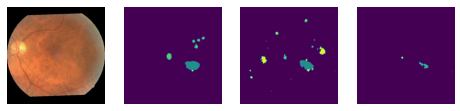

Plotting Activations


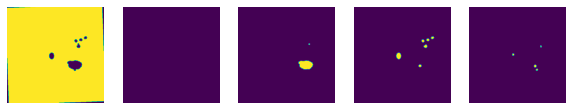

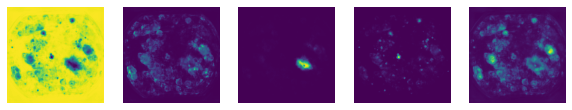

The loss on the first batch is : 0.7657014727592468
Loss at epoch : 23 : 0.712
Running Validation Step


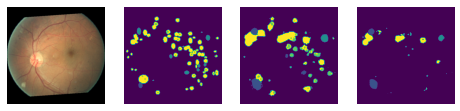

The loss on the first batch for validation is : 0.6410430669784546
Validation Loss at epoch : 23 : 0.703
Validation Dice Score at epoch : 23 : 0.292
Epoch : 23 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 24 -------------------------------------------------------------------


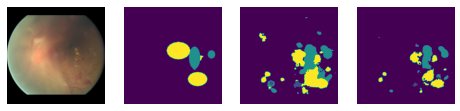

Plotting Activations


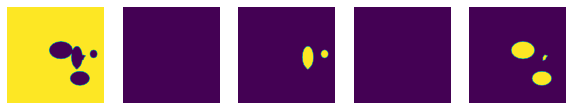

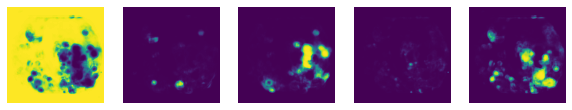

The loss on the first batch is : 0.7257083654403687
Loss at epoch : 24 : 0.711
Running Validation Step


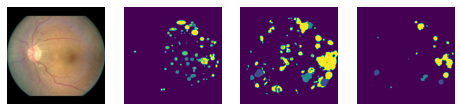

The loss on the first batch for validation is : 0.5789880752563477
Validation Loss at epoch : 24 : 0.697
Validation Dice Score at epoch : 24 : 0.292
Epoch : 24 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 25 -------------------------------------------------------------------


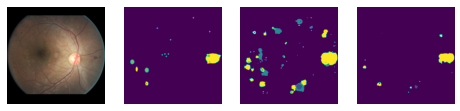

Plotting Activations


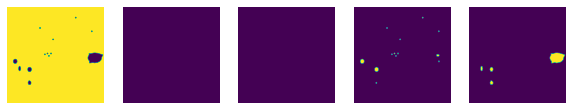

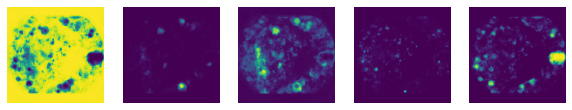

The loss on the first batch is : 0.6012861728668213
Loss at epoch : 25 : 0.715
Running Validation Step


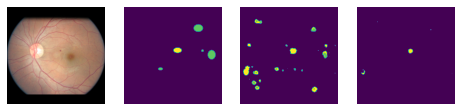

The loss on the first batch for validation is : 1.652382493019104
Validation Loss at epoch : 25 : 0.689
Validation Dice Score at epoch : 25 : 0.294
Saved model at val dice : 0.294
Epoch : 25 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 26 -------------------------------------------------------------------


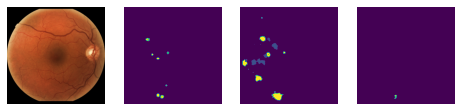

Plotting Activations


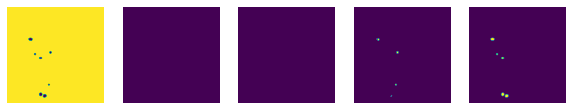

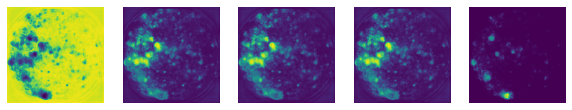

The loss on the first batch is : 0.7439441680908203
Loss at epoch : 26 : 0.71
Running Validation Step


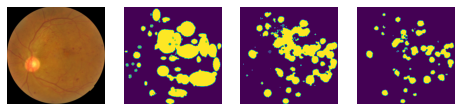

The loss on the first batch for validation is : 0.8237601518630981
Validation Loss at epoch : 26 : 0.687
Validation Dice Score at epoch : 26 : 0.292
Epoch : 26 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 27 -------------------------------------------------------------------


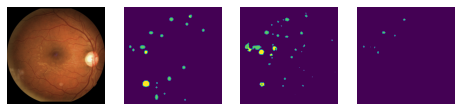

Plotting Activations


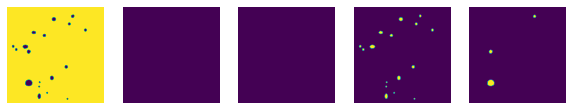

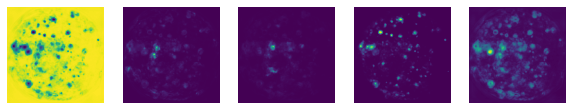

The loss on the first batch is : 0.6791592836380005
Loss at epoch : 27 : 0.709
Running Validation Step


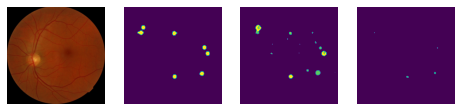

The loss on the first batch for validation is : 1.8126752376556396
Validation Loss at epoch : 27 : 0.698
Validation Dice Score at epoch : 27 : 0.289
Epoch : 27 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 28 -------------------------------------------------------------------


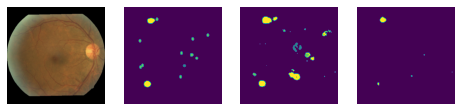

Plotting Activations


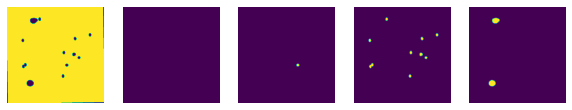

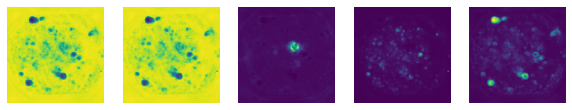

The loss on the first batch is : 0.7846370935440063
Loss at epoch : 28 : 0.694
Running Validation Step


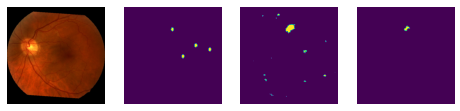

The loss on the first batch for validation is : 0.61859530210495
Validation Loss at epoch : 28 : 0.682
Validation Dice Score at epoch : 28 : 0.291
Epoch : 28 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 29 -------------------------------------------------------------------


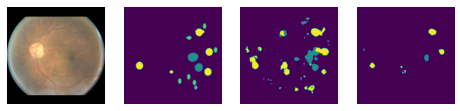

Plotting Activations


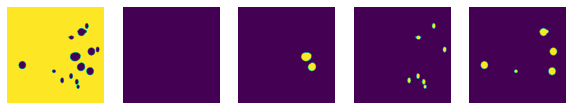

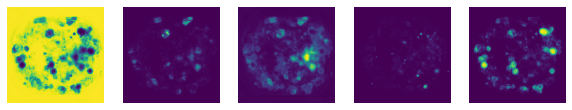

The loss on the first batch is : 0.8853979110717773
Loss at epoch : 29 : 0.708
Running Validation Step


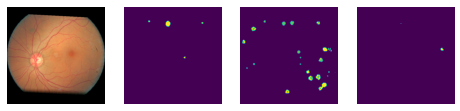

The loss on the first batch for validation is : 0.6374240517616272
Validation Loss at epoch : 29 : 0.692
Validation Dice Score at epoch : 29 : 0.296
Saved model at val dice : 0.296
Epoch : 29 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 30 -------------------------------------------------------------------


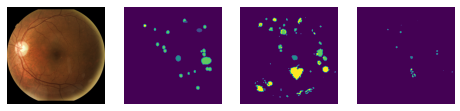

Plotting Activations


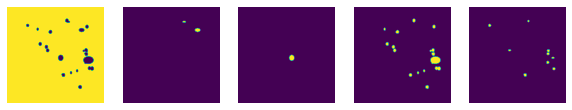

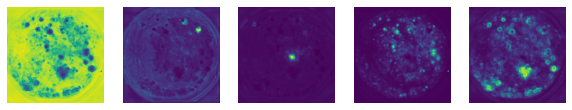

The loss on the first batch is : 0.6939358115196228
Loss at epoch : 30 : 0.701
Running Validation Step


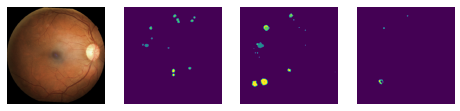

The loss on the first batch for validation is : 0.4534077048301697
Validation Loss at epoch : 30 : 0.682
Validation Dice Score at epoch : 30 : 0.293
Epoch : 30 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 31 -------------------------------------------------------------------


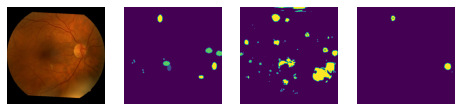

Plotting Activations


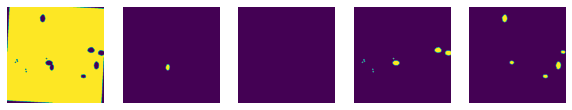

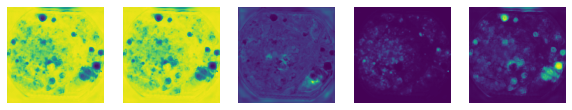

The loss on the first batch is : 0.912057638168335
Loss at epoch : 31 : 0.703
Running Validation Step


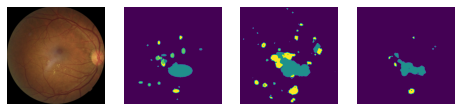

The loss on the first batch for validation is : 0.6557002067565918
Validation Loss at epoch : 31 : 0.693
Validation Dice Score at epoch : 31 : 0.296
Epoch : 31 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 32 -------------------------------------------------------------------


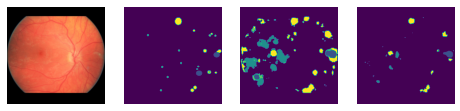

Plotting Activations


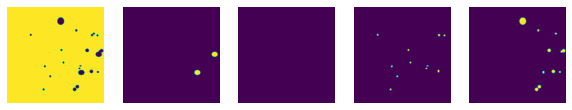

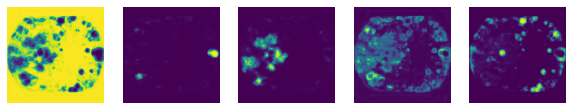

The loss on the first batch is : 0.6767153143882751
Loss at epoch : 32 : 0.716
Running Validation Step


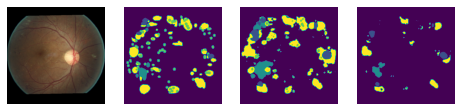

The loss on the first batch for validation is : 0.7783153057098389
Validation Loss at epoch : 32 : 0.689
Validation Dice Score at epoch : 32 : 0.295
Epoch : 32 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 33 -------------------------------------------------------------------


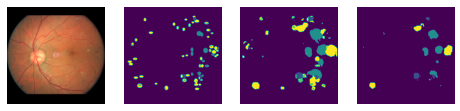

Plotting Activations


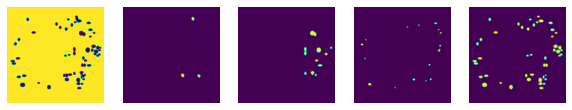

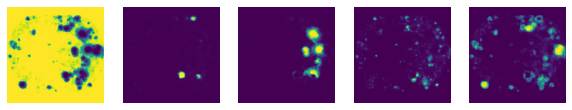

The loss on the first batch is : 0.7016443014144897
Loss at epoch : 33 : 0.698
Running Validation Step


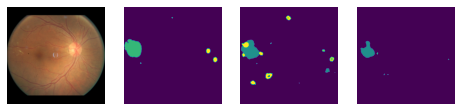

The loss on the first batch for validation is : 0.5518990755081177
Validation Loss at epoch : 33 : 0.695
Validation Dice Score at epoch : 33 : 0.293
Epoch : 33 took 2 mins : 3 seconds


------------------------------------------------------------------------------------------






Starting epoch : 34 -------------------------------------------------------------------


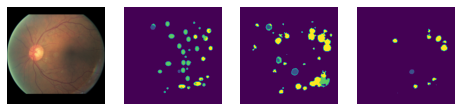

Plotting Activations


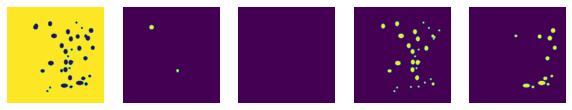

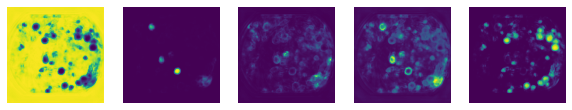

The loss on the first batch is : 0.5847213268280029
Loss at epoch : 34 : 0.703
Running Validation Step


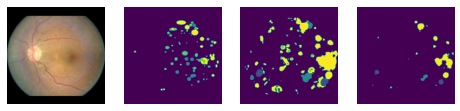

The loss on the first batch for validation is : 0.583325982093811
Validation Loss at epoch : 34 : 0.68
Validation Dice Score at epoch : 34 : 0.289
Epoch : 34 took 2 mins : 4 seconds


------------------------------------------------------------------------------------------






Starting epoch : 35 -------------------------------------------------------------------


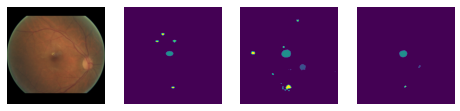

Plotting Activations


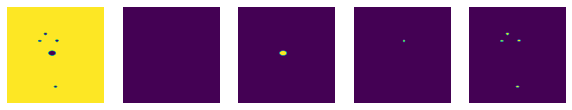

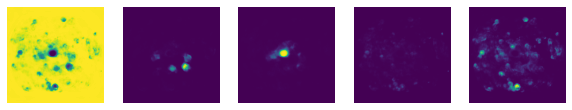

The loss on the first batch is : 0.6592795252799988
Loss at epoch : 35 : 0.706
Running Validation Step


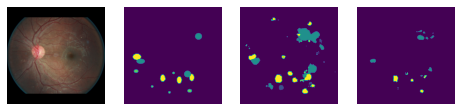

The loss on the first batch for validation is : 0.6374843120574951
Validation Loss at epoch : 35 : 0.674
Validation Dice Score at epoch : 35 : 0.29
Early Stopping kicked in : Stopping at epoch 35


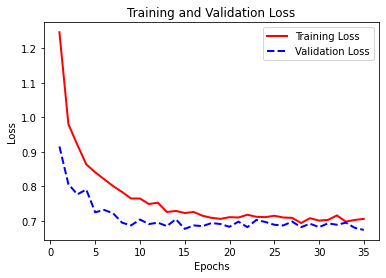

In [42]:
trainer.fit(log=True, validation=True, valid_dl=valid_dl, model_checkpoint=True,clf_loss=loss_function,model_save_path="./model_weights/stage_5/mtt_vgg_bce.pth")


In [ ]:
"model_weights/stage_1/simple_unet.pth"

### Reversed Fine Tuning

In [42]:
#Loading the model

model_spec = {
    "vgg_simple" : (1,1,0, "./model_weights/stage_1/vgg_simple.pth"),
    "vgg_complex" : (1,0,0, "./model_weights/stage_1/complex_vgg_best.pth")
}
model_dict = model_loader(model_spec, 5)


Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

In [43]:
simple_vgg = model_dict["vgg_simple"]
complex_vgg = model_dict["vgg_complex"]

In [48]:
def add_commas(num):
    num_str = str(num)
    if len(num_str) <= 3:
        return num_str
    else:
        return add_commas(num_str[:-3]) + ',' + num_str[-3:]

In [51]:
count=0
for param in complex_vgg.decoder.parameters():
    count+=param.view(-1).shape[0]

    
print(f"Complex decoder : {add_commas(count)}")

Complex decoder : 11,144,069


In [110]:
count=0

for name, param in res_unet.decoder.named_parameters():
        if 'weight' in name and param.dim() > 1:
            torch.nn.init.kaiming_uniform_(param, nonlinearity='relu')
            count+=1
        elif 'bias' in name and param.dim() > 1:
            torch.nn.init.constant_(param, 0.0)
            count+=1
print(count)

13


In [96]:
for param in res_unet.dual_attention.parameters():
    param.requires_grad = False
for param in res_unet.dual_attention_2.parameters():
    param.requires_grad = False

In [98]:
pos_weight = torch.Tensor([1, 35, 7, 5, 12]).to(device)
#seg_loss_function = CrossEntropy4D(class_weights=pos_weight)
#seg_loss_function = DiceLoss(num_classes=5)
#seg_loss_function = DiceCE(5)
#seg_loss_function = CompoundLoss(l1=False, lamb=0.1)
#seg_loss_function = WeightedCrossEntropy(class_weights=pos_weight)
#clf_loss_function = DiceCLFLoss()
#clf_loss_function = MultiLabelBCEWithLogitsLoss()
#loss_function = MultiTaskLoss(seg_loss=seg_loss_function, clf_loss=clf_loss_function)
#loss_function = DiceLoss(num_classes=5)
loss_function = DiceCE(num_classes=5)
binary_loss = DiceBCELoss()
bcm_params = (3, binary_loss, 0.15)
optimizer = torch.optim.Adam(res_unet.parameters(), lr=1.5e-4)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="max", factor=0.5, patience=2)

In [99]:
trainer = Trainer(res_unet, train_dl, 5,50, loss_function, optimizer, scheduler, patience=5)

Starting epoch : 1 -------------------------------------------------------------------


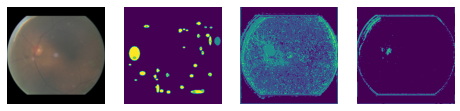

Plotting Activations


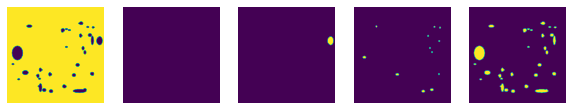

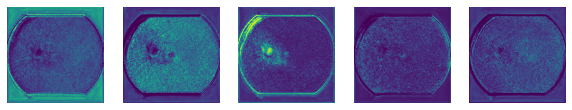

The loss on the first batch is : 2.643592119216919
Loss at epoch : 1 : 1.408
Running Validation Step


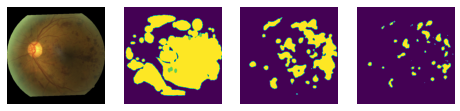

The loss on the first batch for validation is : 1.2889224290847778
Validation Loss at epoch : 1 : 1.094
Validation Dice Score at epoch : 1 : 0.253
Saved model at val dice : 0.253
Epoch : 1 took 1 mins : 20 seconds


------------------------------------------------------------------------------------------






Starting epoch : 2 -------------------------------------------------------------------


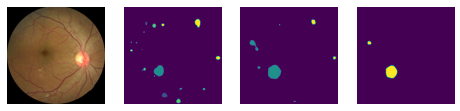

Plotting Activations


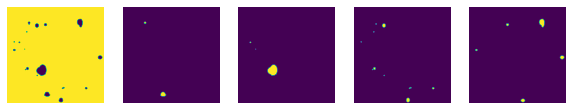

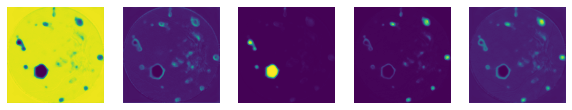

The loss on the first batch is : 1.3525662422180176
Loss at epoch : 2 : 1.179
Running Validation Step


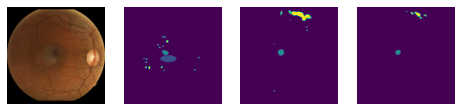

The loss on the first batch for validation is : 1.0231355428695679
Validation Loss at epoch : 2 : 0.98
Validation Dice Score at epoch : 2 : 0.316
Saved model at val dice : 0.316
Epoch : 2 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 3 -------------------------------------------------------------------


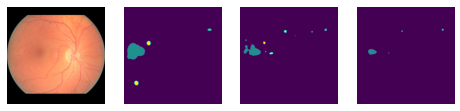

Plotting Activations


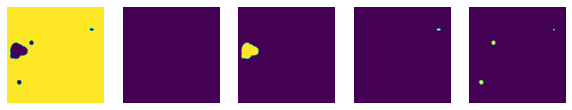

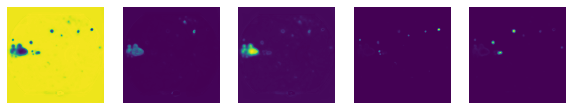

The loss on the first batch is : 0.974851131439209
Loss at epoch : 3 : 1.101
Running Validation Step


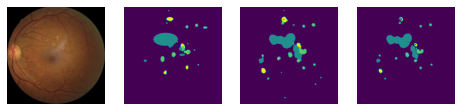

The loss on the first batch for validation is : 0.9070519804954529
Validation Loss at epoch : 3 : 0.94
Validation Dice Score at epoch : 3 : 0.349
Saved model at val dice : 0.349
Epoch : 3 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 4 -------------------------------------------------------------------


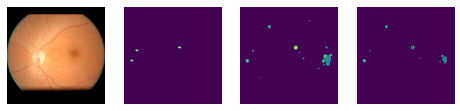

Plotting Activations


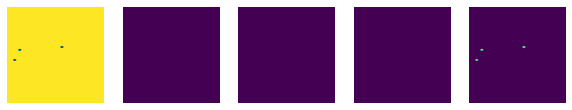

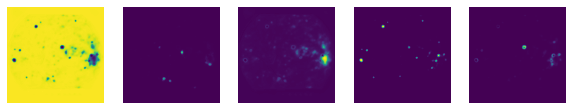

The loss on the first batch is : 1.261665940284729
Loss at epoch : 4 : 1.071
Running Validation Step


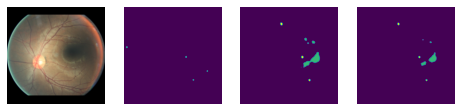

The loss on the first batch for validation is : 0.9224109649658203
Validation Loss at epoch : 4 : 0.919
Validation Dice Score at epoch : 4 : 0.352
Saved model at val dice : 0.352
Epoch : 4 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 5 -------------------------------------------------------------------


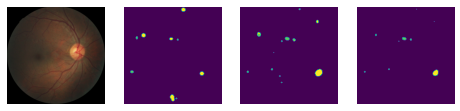

Plotting Activations


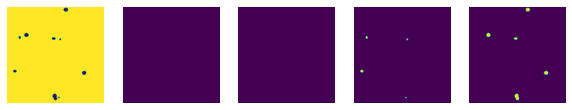

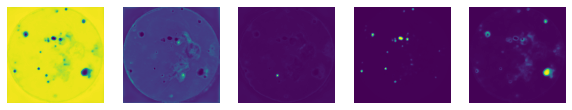

The loss on the first batch is : 0.9048805236816406
Loss at epoch : 5 : 1.049
Running Validation Step


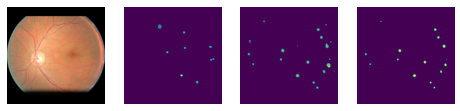

The loss on the first batch for validation is : 0.828353762626648
Validation Loss at epoch : 5 : 0.884
Validation Dice Score at epoch : 5 : 0.373
Saved model at val dice : 0.373
Epoch : 5 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 6 -------------------------------------------------------------------


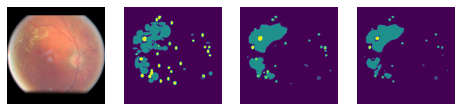

Plotting Activations


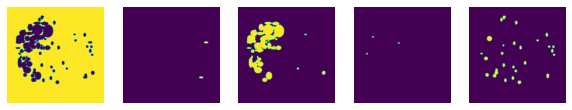

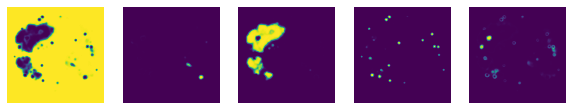

The loss on the first batch is : 1.3975812196731567
Loss at epoch : 6 : 1.049
Running Validation Step


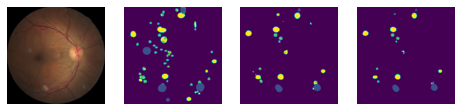

The loss on the first batch for validation is : 0.8169053792953491
Validation Loss at epoch : 6 : 0.88
Validation Dice Score at epoch : 6 : 0.379
Saved model at val dice : 0.379
Epoch : 6 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 7 -------------------------------------------------------------------


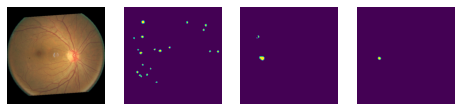

Plotting Activations


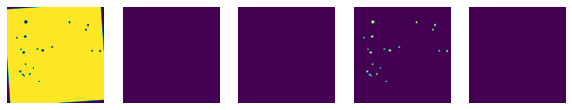

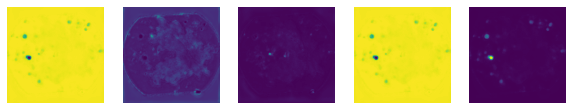

The loss on the first batch is : 1.2581905126571655
Loss at epoch : 7 : 1.04
Running Validation Step


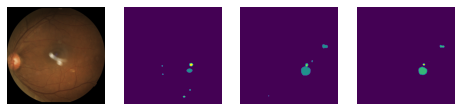

The loss on the first batch for validation is : 0.8609298467636108
Validation Loss at epoch : 7 : 0.878
Validation Dice Score at epoch : 7 : 0.38
Saved model at val dice : 0.38
Epoch : 7 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 8 -------------------------------------------------------------------


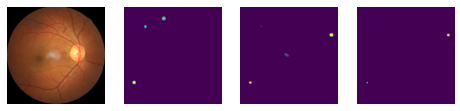

Plotting Activations


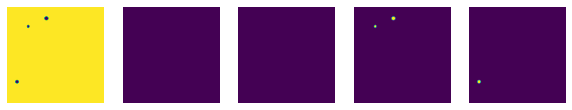

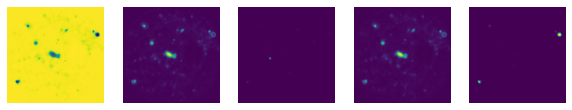

The loss on the first batch is : 1.11667799949646
Loss at epoch : 8 : 1.03
Running Validation Step


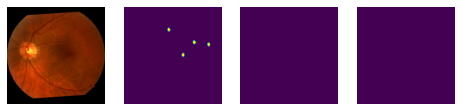

The loss on the first batch for validation is : 0.7974505424499512
Validation Loss at epoch : 8 : 0.872
Validation Dice Score at epoch : 8 : 0.389
Saved model at val dice : 0.389
Epoch : 8 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 9 -------------------------------------------------------------------


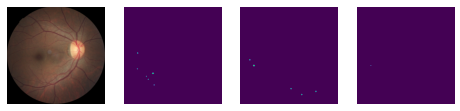

Plotting Activations


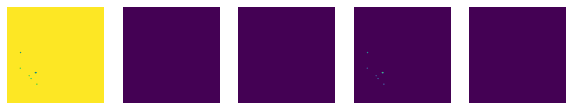

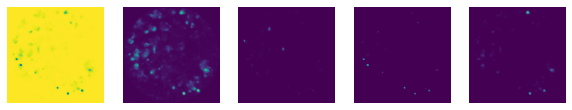

The loss on the first batch is : 1.2345722913742065
Loss at epoch : 9 : 1.023
Running Validation Step


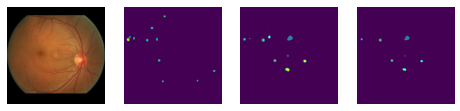

The loss on the first batch for validation is : 0.8942603468894958
Validation Loss at epoch : 9 : 0.865
Validation Dice Score at epoch : 9 : 0.392
Saved model at val dice : 0.392
Epoch : 9 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 10 -------------------------------------------------------------------


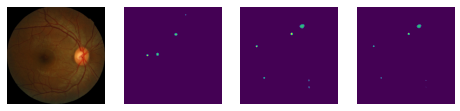

Plotting Activations


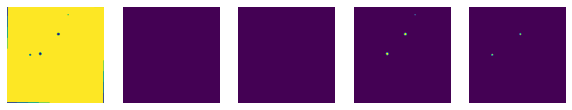

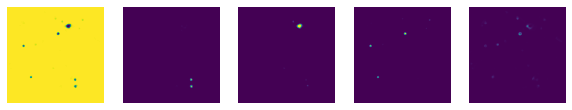

The loss on the first batch is : 1.0462809801101685
Loss at epoch : 10 : 0.996
Running Validation Step


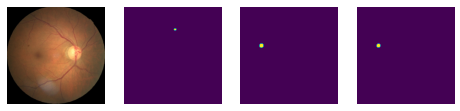

The loss on the first batch for validation is : 0.8958948254585266
Validation Loss at epoch : 10 : 0.867
Validation Dice Score at epoch : 10 : 0.4
Saved model at val dice : 0.4
Epoch : 10 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 11 -------------------------------------------------------------------


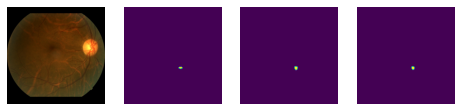

Plotting Activations


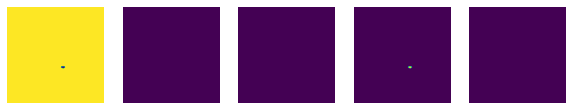

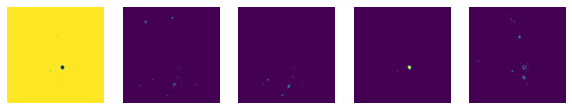

The loss on the first batch is : 1.1703895330429077
Loss at epoch : 11 : 1.0
Running Validation Step


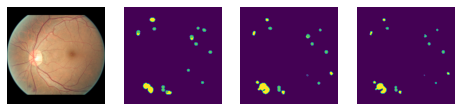

The loss on the first batch for validation is : 0.7272214293479919
Validation Loss at epoch : 11 : 0.861
Validation Dice Score at epoch : 11 : 0.393
Epoch : 11 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 12 -------------------------------------------------------------------


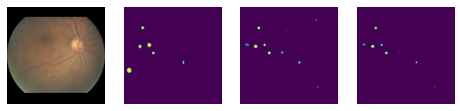

Plotting Activations


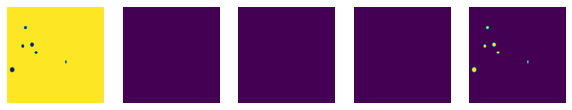

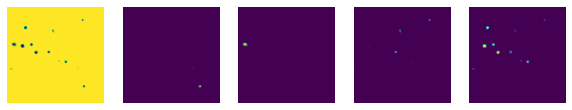

The loss on the first batch is : 0.82100510597229
Loss at epoch : 12 : 0.995
Running Validation Step


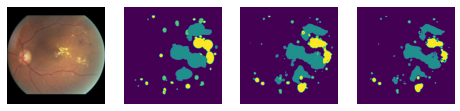

The loss on the first batch for validation is : 0.9917052984237671
Validation Loss at epoch : 12 : 0.858
Validation Dice Score at epoch : 12 : 0.393
Epoch : 12 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 13 -------------------------------------------------------------------


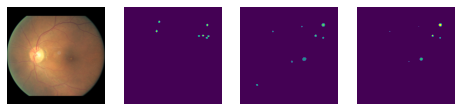

Plotting Activations


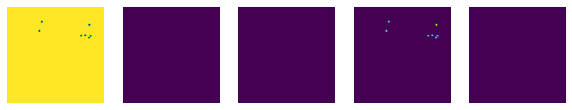

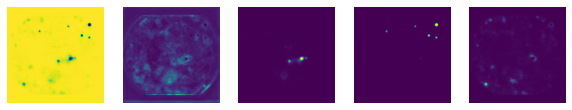

The loss on the first batch is : 1.1245783567428589
Loss at epoch : 13 : 0.99
Running Validation Step


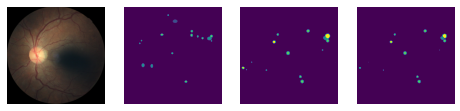

The loss on the first batch for validation is : 0.8453995585441589
Validation Loss at epoch : 13 : 0.863
Validation Dice Score at epoch : 13 : 0.396
Epoch : 13 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 14 -------------------------------------------------------------------


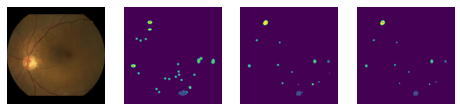

Plotting Activations


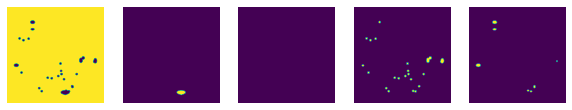

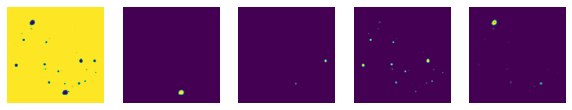

The loss on the first batch is : 0.7590880990028381
Loss at epoch : 14 : 0.98
Running Validation Step


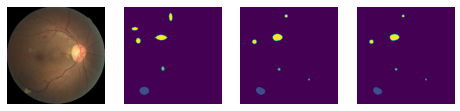

The loss on the first batch for validation is : 0.6944853067398071
Validation Loss at epoch : 14 : 0.844
Validation Dice Score at epoch : 14 : 0.402
Saved model at val dice : 0.402
Epoch : 14 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 15 -------------------------------------------------------------------


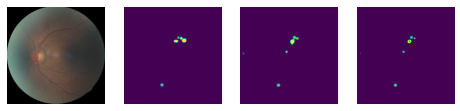

Plotting Activations


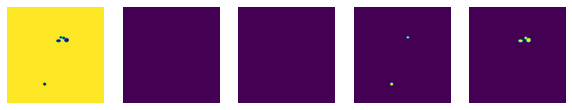

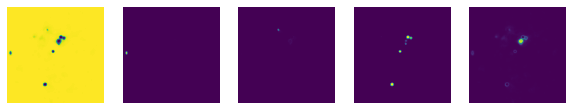

The loss on the first batch is : 0.7979046106338501
Loss at epoch : 15 : 0.95
Running Validation Step


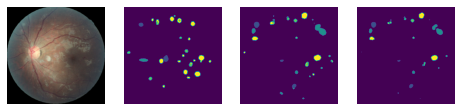

The loss on the first batch for validation is : 0.8306811451911926
Validation Loss at epoch : 15 : 0.847
Validation Dice Score at epoch : 15 : 0.401
Epoch : 15 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 16 -------------------------------------------------------------------


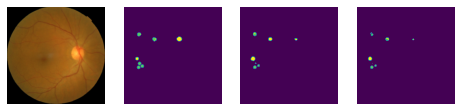

Plotting Activations


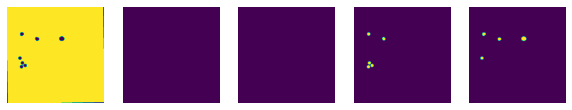

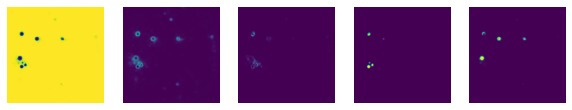

The loss on the first batch is : 1.2283439636230469
Loss at epoch : 16 : 0.98
Running Validation Step


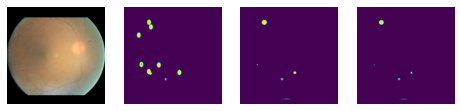

The loss on the first batch for validation is : 0.8155760765075684
Validation Loss at epoch : 16 : 0.849
Validation Dice Score at epoch : 16 : 0.399
Epoch : 16 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 17 -------------------------------------------------------------------


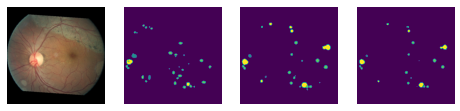

Plotting Activations


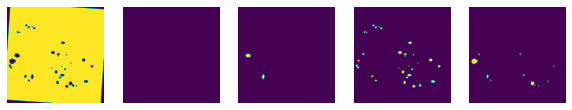

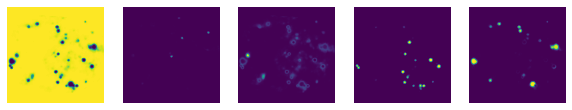

The loss on the first batch is : 0.9612019062042236
Loss at epoch : 17 : 0.962
Running Validation Step


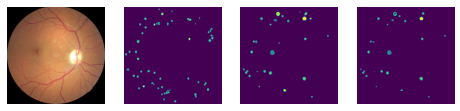

The loss on the first batch for validation is : 0.891569972038269
Validation Loss at epoch : 17 : 0.841
Validation Dice Score at epoch : 17 : 0.403
Saved model at val dice : 0.403
Epoch : 17 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 18 -------------------------------------------------------------------


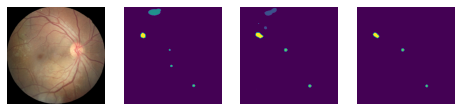

Plotting Activations


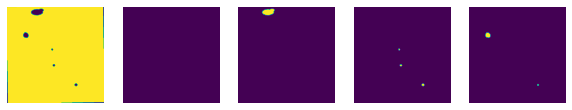

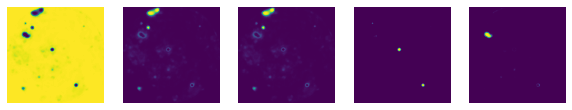

The loss on the first batch is : 0.779356837272644
Loss at epoch : 18 : 0.947
Running Validation Step


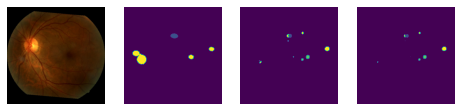

The loss on the first batch for validation is : 0.8028181791305542
Validation Loss at epoch : 18 : 0.845
Validation Dice Score at epoch : 18 : 0.408
Saved model at val dice : 0.408
Epoch : 18 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 19 -------------------------------------------------------------------


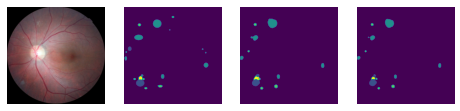

Plotting Activations


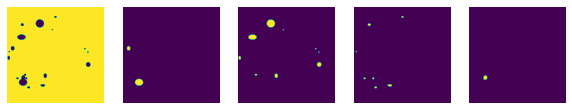

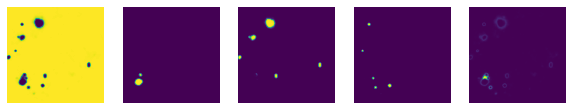

The loss on the first batch is : 1.246781349182129
Loss at epoch : 19 : 0.973
Running Validation Step


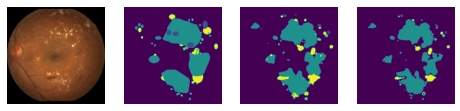

The loss on the first batch for validation is : 0.7884191274642944
Validation Loss at epoch : 19 : 0.844
Validation Dice Score at epoch : 19 : 0.401
Epoch : 19 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 20 -------------------------------------------------------------------


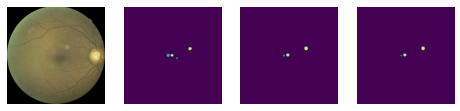

Plotting Activations


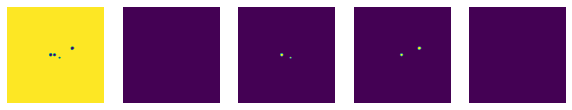

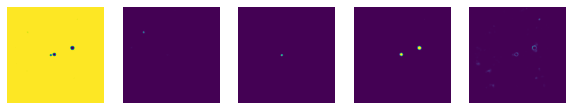

The loss on the first batch is : 0.8294308185577393
Loss at epoch : 20 : 0.968
Running Validation Step


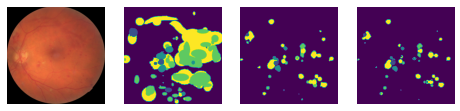

The loss on the first batch for validation is : 1.3358060121536255
Validation Loss at epoch : 20 : 0.857
Validation Dice Score at epoch : 20 : 0.397
Epoch : 20 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 21 -------------------------------------------------------------------


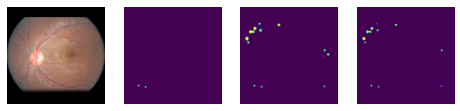

Plotting Activations


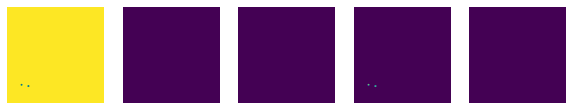

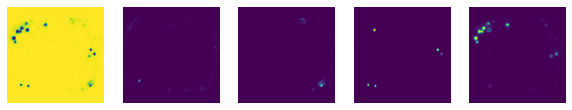

The loss on the first batch is : 0.7907564043998718
Loss at epoch : 21 : 0.945
Running Validation Step


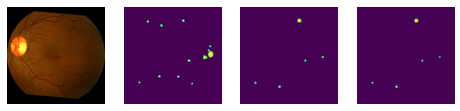

The loss on the first batch for validation is : 0.9019274711608887
Validation Loss at epoch : 21 : 0.867
Validation Dice Score at epoch : 21 : 0.403
Epoch : 21 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 22 -------------------------------------------------------------------


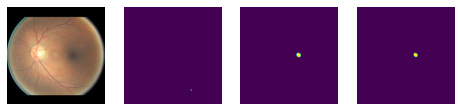

Plotting Activations


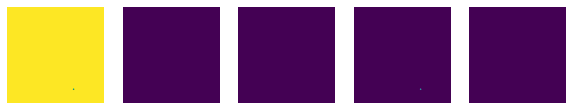

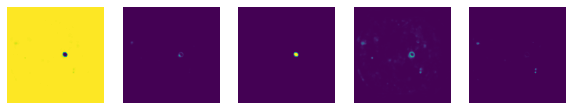

The loss on the first batch is : 0.9152892827987671
Loss at epoch : 22 : 0.943
Running Validation Step


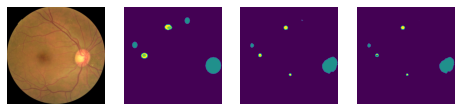

The loss on the first batch for validation is : 0.9693849682807922
Validation Loss at epoch : 22 : 0.845
Validation Dice Score at epoch : 22 : 0.403
Epoch : 22 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 23 -------------------------------------------------------------------


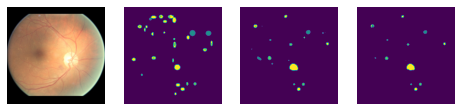

Plotting Activations


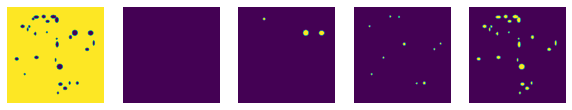

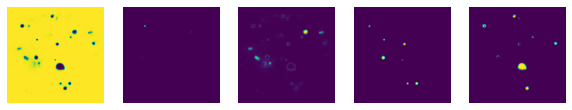

The loss on the first batch is : 0.8556796312332153
Loss at epoch : 23 : 0.944
Running Validation Step


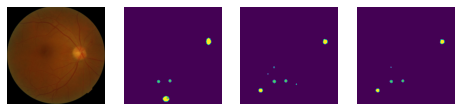

The loss on the first batch for validation is : 1.0315208435058594
Validation Loss at epoch : 23 : 0.843
Validation Dice Score at epoch : 23 : 0.403
Epoch : 23 took 1 mins : 21 seconds


------------------------------------------------------------------------------------------






Starting epoch : 24 -------------------------------------------------------------------


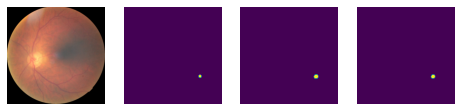

Plotting Activations


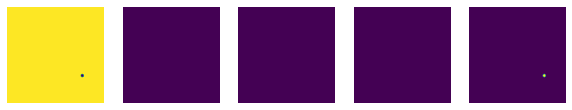

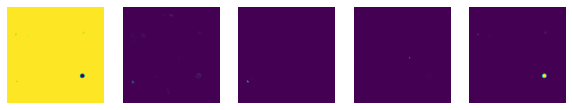

The loss on the first batch is : 0.8820713758468628
Loss at epoch : 24 : 0.931
Running Validation Step


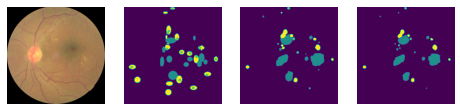

The loss on the first batch for validation is : 0.8912442922592163
Validation Loss at epoch : 24 : 0.854
Validation Dice Score at epoch : 24 : 0.402
Early Stopping kicked in : Stopping at epoch 24


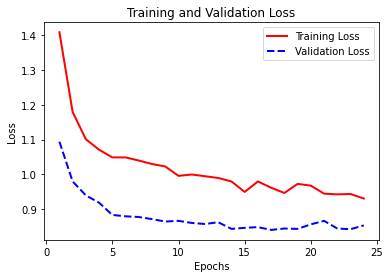

In [100]:
trainer.fit(log=True, validation=True, valid_dl=valid_dl, model_checkpoint=True,bcm_params=(bcm_params),model_save_path="./model_weights/stage_17_rft/csa_resnet_bcm_3.pth")


### Classification Training

In [61]:
clf_model = DRClassifier(5).to(device)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [62]:
loss_function = Poly1CrossEntropyLoss(num_classes=5, reduction="mean")
optimizer = torch.optim.Adam(clf_model.parameters())
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="max", factor=0.5, patience=2)

In [63]:
trainer = Trainer(network=clf_model, train_dl=train_dl, n_classes=5,epochs=20, loss_function=loss_function, optimizer=optimizer, scheduler=scheduler)


Starting epoch : 1 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 1 : 1.623
Training Metric at epoch : 1 : 0.539
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.78it/s]


Validation Loss at epoch : 1 : 1.183
Validation Metric at epoch : 1 : 0.756
Saved model at val dice : 1.183
Epoch : 1 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 2 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 2 : 1.405
Training Metric at epoch : 2 : 0.59
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.60it/s]


Validation Loss at epoch : 2 : 1.016
Validation Metric at epoch : 2 : 0.738
Saved model at val dice : 1.016
Epoch : 2 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 3 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 3 : 1.406
Training Metric at epoch : 3 : 0.59
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.73it/s]


Validation Loss at epoch : 3 : 1.034
Validation Metric at epoch : 3 : 0.762
Epoch : 3 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 4 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 4 : 1.339
Training Metric at epoch : 4 : 0.625
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.67it/s]


Validation Loss at epoch : 4 : 1.123
Validation Metric at epoch : 4 : 0.75
Epoch : 4 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 5 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 5 : 1.283
Training Metric at epoch : 5 : 0.635
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.72it/s]


Validation Loss at epoch : 5 : 1.084
Validation Metric at epoch : 5 : 0.744
Epoch : 5 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 6 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 6 : 1.24
Training Metric at epoch : 6 : 0.639
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.71it/s]


Validation Loss at epoch : 6 : 1.245
Validation Metric at epoch : 6 : 0.688
Epoch : 6 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 7 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 7 : 1.188
Training Metric at epoch : 7 : 0.659
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.77it/s]


Validation Loss at epoch : 7 : 1.068
Validation Metric at epoch : 7 : 0.762
Epoch : 7 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 8 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 8 : 1.196
Training Metric at epoch : 8 : 0.661
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.79it/s]


Validation Loss at epoch : 8 : 0.969
Validation Metric at epoch : 8 : 0.806
Saved model at val dice : 0.969
Epoch : 8 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 9 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 9 : 1.176
Training Metric at epoch : 9 : 0.652
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.70it/s]


Validation Loss at epoch : 9 : 1.02
Validation Metric at epoch : 9 : 0.775
Epoch : 9 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 10 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 10 : 1.082
Training Metric at epoch : 10 : 0.674
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.84it/s]


Validation Loss at epoch : 10 : 1.105
Validation Metric at epoch : 10 : 0.688
Epoch : 10 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 11 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 11 : 1.094
Training Metric at epoch : 11 : 0.667
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.78it/s]


Validation Loss at epoch : 11 : 1.219
Validation Metric at epoch : 11 : 0.675
Epoch : 11 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 12 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 12 : 1.095
Training Metric at epoch : 12 : 0.667
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.86it/s]


Validation Loss at epoch : 12 : 1.127
Validation Metric at epoch : 12 : 0.719
Epoch : 12 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 13 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 13 : 1.002
Training Metric at epoch : 13 : 0.696
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.69it/s]


Validation Loss at epoch : 13 : 1.047
Validation Metric at epoch : 13 : 0.756
Epoch : 13 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 14 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 14 : 0.998
Training Metric at epoch : 14 : 0.685
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.80it/s]


Validation Loss at epoch : 14 : 1.09
Validation Metric at epoch : 14 : 0.738
Epoch : 14 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 15 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 15 : 0.93
Training Metric at epoch : 15 : 0.706
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.78it/s]


Validation Loss at epoch : 15 : 1.223
Validation Metric at epoch : 15 : 0.706
Epoch : 15 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 16 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 16 : 0.939
Training Metric at epoch : 16 : 0.698
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.65it/s]


Validation Loss at epoch : 16 : 1.064
Validation Metric at epoch : 16 : 0.756
Epoch : 16 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 17 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.00it/s]


Training Loss at epoch : 17 : 0.864
Training Metric at epoch : 17 : 0.734
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.62it/s]


Validation Loss at epoch : 17 : 1.266
Validation Metric at epoch : 17 : 0.675
Epoch : 17 took 1 mins : 49 seconds


------------------------------------------------------------------------------------------






Starting epoch : 18 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 18 : 0.858
Training Metric at epoch : 18 : 0.733
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.71it/s]


Validation Loss at epoch : 18 : 1.345
Validation Metric at epoch : 18 : 0.719
Epoch : 18 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 19 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 19 : 0.794
Training Metric at epoch : 19 : 0.752
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.69it/s]


Validation Loss at epoch : 19 : 1.154
Validation Metric at epoch : 19 : 0.731
Epoch : 19 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------






Starting epoch : 20 -------------------------------------------------------------------


100%|██████████| 315/315 [01:44<00:00,  3.01it/s]


Training Loss at epoch : 20 : 0.781
Training Metric at epoch : 20 : 0.745
Running Validation Step


100%|██████████| 40/40 [00:04<00:00,  9.55it/s]


Validation Loss at epoch : 20 : 1.279
Validation Metric at epoch : 20 : 0.688
Epoch : 20 took 1 mins : 48 seconds


------------------------------------------------------------------------------------------








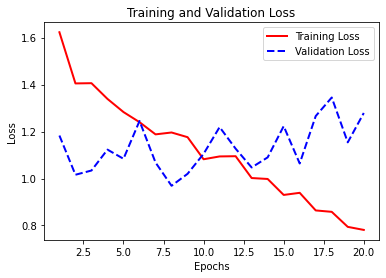

In [64]:
trainer.fit_classify(validation=True, valid_dl=valid_dl, model_checkpoint=True, model_save_path="./model_weights/classification_models/segmaps_only.pth")



# Evaluation

This stage will carry out evaluation of various stages.

### Compressing Results

In [41]:
!zip -r experiment_results.zip ./experiment_results/

  adding: experiment_results/ (stored 0%)
  adding: experiment_results/stage_2/ (stored 0%)
  adding: experiment_results/stage_2/vgg_s5.png (deflated 17%)
  adding: experiment_results/stage_2/res_s1.csv (deflated 25%)
  adding: experiment_results/stage_2/b4_s1.csv (deflated 23%)
  adding: experiment_results/stage_2/res_s2.csv (deflated 59%)
  adding: experiment_results/stage_2/resnet_ev1.csv (deflated 33%)
  adding: experiment_results/stage_2/vgg_s2.json (deflated 58%)
  adding: experiment_results/stage_2/res_s2.json (deflated 58%)
  adding: experiment_results/stage_2/res_s5.csv (deflated 30%)
  adding: experiment_results/stage_2/vgg_s1.csv (deflated 21%)
  adding: experiment_results/stage_2/vgg.png (deflated 17%)
  adding: experiment_results/stage_2/b4_s5.png (deflated 17%)
  adding: experiment_results/stage_2/b4_s5.csv (deflated 30%)
  adding: experiment_results/stage_2/resnet.png (deflated 17%)
  adding: experiment_results/stage_2/effnet.png (deflated 17%)
  adding: experiment_resul

### Initialization

#### Model Loader

In [39]:
def model_loader(model_specifications, num_classes):
    """This function returns a dictionary of loaded models.
    The model specification needs to be off the following form {\"name of model\" : (model_base, type, weights_path)}"""

    model_dict = {}

    for model_name in model_specifications.keys():

        base, simplicity, attention, subtractive, path = model_specifications[model_name]

        if base == 0:
            model = UNet(num_classes=num_classes, d_in=3,filters=[64, 128, 256, 512, 1024], simple=simplicity, attention=attention, subtractive=subtractive).to(device)
        elif base == 1:
            model = VGGUNet(num_classes, simplicity, attention=attention, subtractive=subtractive).to(device)
        elif base == 2:
            model = ResNetUNet(num_classes, simplicity, attention=attention, subtractive=subtractive).to(device)
        elif base == 3:
            model = EfficientNetUNet(num_classes, simplicity, attention=attention, subtractive=subtractive).to(device)
        elif base == 4:
            model = ArcEfficientNetUNet(num_classes, simplicity, attention, subtractive=subtractive).to(device)
        else:
            print("Unknown model base selected")
            return -1
        
        state_dict = torch.load(path, map_location=device)
        model.load_state_dict(state_dict)

        model_dict[model_name] = model
    
    return model_dict


#### Evaluation Pipeline

In [40]:
import json
class EvalPipeline:
    
    def __init__(self, dataloader, n,model_dict, class_dict, color_dict):
        
        """"This is an evaluation pipeline which can be used to determine the evaluation metrics for a group of segmentation models."""

        self.dl = dataloader
        self.img, self.gt = zip(*[(data[0].numpy(), data[1].numpy()) for data in dataloader])
        self.img = np.concatenate(self.img)
        #For the methods defined below, the ground-truths need to be in the following shape : (B, H, W, 1)
        self.gt = np.concatenate(self.gt)
            
        self.clf_gt = torch.from_numpy(self.gt)
        self.clf_gt = f.max_pool2d(self.clf_gt, self.clf_gt.shape[2:])
        self.clf_gt = torch.squeeze(torch.squeeze(self.clf_gt, dim=-1), dim=-1).to(torch.int)
        
        self.gt = np.transpose(self.gt, (0, 2, 3, 1))
        self.gt = np.argmax(self.gt, axis=3)
        self.gt = np.expand_dims(self.gt, axis=-1)
        
        self.model_dict = model_dict
        self.n = n
        self.class_dict = class_dict
        self.color_dict = color_dict
        self.prediction_gen()
        
    def prediction_gen(self):

        """Generates predictions for each segmentation model"""
        
        predictions = {}
        profiles = {}
        
        for m in self.model_dict.keys():
            model = self.model_dict[m]

            #For the methods below, the predictions need to be in the following shape : (B, H, W, 1)
            pred = model.predict(self.dl)
            
            #Getting the lesion profiles from predictions
            profile = torch.from_numpy(pred)
            profile = profile.permute(0,3,1,2)
            clf_pred = f.max_pool2d(profile, profile.shape[2:])
            clf_pred = torch.squeeze(torch.squeeze(clf_pred, dim=-1), dim=-1)
            clf_pred = torch.round(clf_pred).to(torch.int)
            
            profiles[m] = clf_pred
            
            pred = np.argmax(pred, axis=-1)
            pred = np.expand_dims(pred, axis=-1)
            
            predictions[m] = pred
            
        self.pred = predictions
        self.clf_preds = profiles
    
    def exact_match_ratio(self, predictions, targets, threshold=0.5):
        """
        :param predictions: tensor of shape (batch_size, num_classes) with predicted scores
        :param targets: tensor of shape (batch_size, num_classes) with target scores
        :return: exact match ratio
        """
        # binarize predictions using threshold
        binary_predictions = torch.where(predictions > threshold, 1, 0)
        # calculate element-wise equality between binary predictions and targets
        equality = torch.eq(binary_predictions, targets)
        # calculate row-wise sums of element-wise equality
        row_sums = torch.sum(equality, dim=1)
        # calculate exact match ratio
        exact_match_ratio = torch.mean(torch.eq(row_sums, targets.shape[1]).float())
        return exact_match_ratio
    
    def jaccard(self, predictions, targets, threshold=0.5):

        binary_predictions = torch.where(predictions > threshold, 1, 0)
        #Calculate the intersection between predictions and targets, sum in the class dimension
        intersection = torch.sum(binary_predictions * targets, dim=1)
        union = torch.sum((binary_predictions | targets), dim=1)

        jaccard_score = torch.mean(intersection.float() / union.float())
        return jaccard_score
    #This function swaps colors from a class map
    def color_swap(self, img):
    
        for key in self.color_dict.keys():

            c = np.where(img[:, :, [0,1,2]] == [key, key, key])
            img[c[0], c[1], :] = self.color_dict[key]

        return img
    
    def image_overlay(self, img, ann):
        
        """This function overlays the annotation over the image
        This function assumes that the background color is pixel value (0,0,0) in RGB
        img : numpy array in the shape : (height, width, color, alpha)
        ann : numpy array in the shape : (height, width, color, alpha)"""
        
        c = np.where(ann[:,:,[0,1,2]] == [0,0,0])
        c_2 = np.where(ann[:,:,[0,1,2]] != [0,0,0])
        ann[c[0], c[1],-1] = 0
        ann[c_2[0], c_2[1],-1] = 100
        
        img = Image.fromarray(img)
        ann = Image.fromarray(ann)
        
        #Overlaying the annotation on the image
        img.paste(ann, (0,0), ann)
        img = np.array(img)
        
        return img
            
    
    def stage_one(self, metrics=["SENS", "SPEC", "IoU", "DSC"], model_keys=[], path="stage_1.csv"):
        
        scores = {}
        
        #First evaluate the same metric for all sets of predictions
        print(metrics)
        for metric in metrics:
            
            scores[metric] = []
            for p in model_keys:
                
                
                current_pred = self.pred[p]
                #Evaluate for the current prediction
                score = evaluate(self.gt, current_pred, metric=metric, multi_class=True, n_classes=self.n)
                score = np.round(np.mean(score), 3)
                scores[metric].append(score)
                
        with open(path, "w") as f:
            f.write("model,")
            for m in metrics:
                f.write(m)
                f.write(",")
            f.write("\n") 
            for i in range(len(scores[m])):
                f.write(model_keys[i])
                f.write(",")
                for m in metrics:

                    f.write(str(round(scores[m][i],3)))
                    f.write(",")
                f.write("\n")
            
            
        return scores
    
    def stage_two(self, metrics=["SENS", "SPEC", "IoU", "DSC"], model_keys=[], path="stage_2.json", csv_path="stage_2.csv"):
        
        scores = {}
        
        # Have to change all of done_pred instances into self.pred
        for p in model_keys:
            scores[p] = []
            print(f"Working on : {p}...")
            for metric in metrics:
                
                current_pred = self.pred[p]
                #Evaluate for the current prediction
                score = evaluate(self.gt, current_pred, metric=metric, multi_class=True, n_classes=self.n)
                scores[p].append(np.round(score, 3))
            
            scores[p] = np.array(scores[p]).T
        
        scores_2 = {}
        
        print("Creating final dict")
        with open(csv_path, "w") as csv_file:
            
            #Writing the csv headers
            csv_file.write("model_name")
            csv_file.write(",")
            csv_file.write("class")
            csv_file.write(",")
            
            for metric in metrics:
                csv_file.write(metric)
                csv_file.write(",")
            
            csv_file.write("\n")
            
            for p in model_keys:
                scores_2[p] = {}
                
                for i, c in enumerate(self.class_dict):
                    scores_2[p][c] = {}
                    
                    #Starting off the row
                    csv_file.write(p)
                    csv_file.write(",")
                    csv_file.write(c)
                    csv_file.write(",")
                    
                    for n, m in enumerate(metrics):

                        #p : model type
                        #c : class
                        #m : metric
                        
                        #Writing in each metric
                        csv_file.write(str(round(scores[p][i][n],3)))
                        csv_file.write(",")
                        
                        scores_2[p][c][m] = scores[p][i][n]
                    
                    csv_file.write("\n")
                        
                    
        
        

        with open(path, "w") as json_file:
            json.dump(scores_2, json_file)
        
        
        return scores_2
    
    def stage_three(self, img_dir, gt_dir, img_files, gt_files, model_keys=[],path="stage_3.png"):
        
        assert len(img_files) == len(gt_files)
        n_cols = len(img_files)
        n_rows = len(model_keys) + 1
        
        #Defining the figure
        fig, ax = plt.subplots(n_cols, n_rows, figsize=(n_rows*3,n_cols*3))
        
        #Plotting the ground truth overlayed on the image
        for i, (img, ann) in enumerate(zip(img_files, gt_files)):
            
            
            
            img_path = os.path.join(img_dir, img)
            image = cv2.imread(img_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGBA)
            
            gt_path = os.path.join(gt_dir, ann)
            gt = cv2.imread(gt_path)
            gt = cv2.cvtColor(gt, cv2.COLOR_BGR2RGBA)
            
            overlay_img = self.image_overlay(image, gt)
            overlay_img = cv2.cvtColor(overlay_img, cv2.COLOR_RGBA2RGB)
            ax[i, 0].imshow(overlay_img)
            ax[i, 0].set_xlabel("ground truth")
            ax[i, 0].set_xticks([])
            ax[i, 0].set_yticks([])
        
        for i, model_name in enumerate(model_keys):
            
            i = i+1
            model = self.model_dict[model_name]
            
            for n, img in enumerate(img_files):
                
                img_path = os.path.join(img_dir, img)
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, (512, 512))
                image = image / 255.0
                image = np.transpose(image, (2, 0, 1))
                image = torch.from_numpy(image).float()
                
                pred = model.predict_image(image)
                pred = np.clip(pred, a_min=0.5, a_max=1)
                pred = np.argmax(pred, axis=-1)
                pred = np.transpose(pred, (1,2,0))
                pred = np.repeat(pred, repeats=3,axis=-1)
                pred = self.color_swap(pred)
                pred = np.uint8(pred)
                pred = cv2.cvtColor(pred, cv2.COLOR_RGB2RGBA)

                
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGBA) 
                image = cv2.resize(image, (512, 512))
                
                overlayed_prediction = self.image_overlay(image, pred)
                overlayed_prediction = cv2.cvtColor(overlayed_prediction, cv2.COLOR_RGBA2RGB)
                
                ax[n, i].imshow(overlayed_prediction)
                ax[n, i].set_xticks([])
                ax[n, i].set_yticks([])
                ax[n, i].set_xlabel(model_name)
        
        plt.subplots_adjust(left=0.2,
                    right=0.9,
                    wspace=0.4,
                    hspace=0.4)
            
        plt.savefig(path, dpi=100)
                    
    
    def stage_four(self, img_dir, gt_dir, img_files, gt_files, model_keys=[],path="stage_4.png"):
        
        """This method is used to compare the predictions of the models passed in with the ground truth for all the images passed in as arguments into this function.
        img_dir : this is the directory of the images : string
        gt_dir : this is the directory where the ground truth images are present : string
        img_files : the specific image file names choosen to plot : list of strings
        gt_files : the corresponding ground truth files choosen to comapare against : list of strings
        The img_files and gt_files must be present within the img_dir and gt_dir respectively.
        Furthermore, the same number of image files and ground truth files should be passed in.
        """
        
        #Number of images should be the same as G.T
        assert len(img_files) == len(gt_files)
        print(img_dir)
        print(gt_dir)
        print(img_files)
        print(gt_files)
        
        n_cols = len(img_files)
        n_rows = len(model_keys) +2
        
        #Defining the figure
        fig, ax = plt.subplots(n_rows, n_cols, figsize=(n_cols*3,n_rows*3))
        
        ax[0, 0].set_ylabel("images")
        ax[1, 0].set_ylabel("ground_truth")
        
        #Plotting the images first
        for i, img in enumerate(img_files):
            
            img_path = os.path.join(img_dir, img)
            image = cv2.imread(img_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            ax[0, i].imshow(image)
            
            ax[0,i].set_xticks([])
            ax[0, i].set_yticks([])
        
        #Plotting the ground truth
        for i, ann in enumerate(gt_files):
            
            gt_path = os.path.join(gt_dir, ann)
            gt = cv2.imread(gt_path)
            gt = cv2.cvtColor(gt, cv2.COLOR_BGR2RGB)
            #gt = cv2.resize(gt, (512, 512))

            ax[1, i].imshow(gt)
            
            ax[1,i].set_xticks([])
            ax[1, i].set_yticks([])
        
        for i, model_name in enumerate(model_keys):
            
            i = i+2
            model = self.model_dict[model_name]
            ax[i, 0].set_ylabel(model_name)
            
            for n, img in enumerate(img_files):
                
                img_path = os.path.join(img_dir, img)
                image = cv2.imread(img_path)
                image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                image = cv2.resize(image, (512, 512))
                image = image / 255.0
                image = np.transpose(image, (2, 0, 1))
                image = torch.from_numpy(image).float()
                
                pred = model.predict_image(image)
                pred = np.clip(pred, a_min=0.5, a_max=1)
                pred = np.argmax(pred, axis=-1)
                pred = np.transpose(pred, (1,2,0))
                pred = np.repeat(pred, repeats=3,axis=-1)
                pred = self.color_swap(pred)
                
                ax[i, n].imshow(pred)
                ax[i,n].set_xticks([])
                ax[i,n].set_yticks([])
            
        plt.subplots_adjust(left=0.2,
                    right=0.9,
                    wspace=0.4,
                    hspace=0.4)
            
        plt.savefig(path, dpi=100)
    ### Stage 5 : F1 score plots per model per class
    
    def stage_five(self, model_keys=[],path="stage_5.png", csv_path="stage_5.csv"):
        
        f1_scores = {}
        
        markers = ["x", "+", ".", "1", "*", "d"]
        colors = ["lime", "fuchsia", "darkorange", "gold", "salmon", "indigo"]
        
        model_names = model_keys
        
        
        if len(model_names) <= 6:
            
            fig, ax = plt.subplots(1,1, figsize=(6,self.n))
            ys = range(self.n)
        
        for i, model_name in enumerate(model_names):
            
            pred = self.pred[model_name]
            
            prec = evaluate(self.gt, pred, metric="PREC", multi_class=True, n_classes=self.n)
            recall = evaluate(self.gt, pred, metric="Recall", multi_class=True, n_classes=self.n)
            
            f1 = (2 * prec * recall) / (prec + recall)
            f1_scores[model_name] = np.round(f1, 3)
            
            some_num = np.random.uniform(0.1, 0.3, 1)
            
            if len(model_names) <= 6:
                ax.scatter(x=f1, y=ys, color=colors[i], marker=markers[i], label=model_name)
                ax.set_yticks(ticks=list(range(self.n)),labels=self.class_dict)
                ax.legend(loc="best")
                ax.grid()

        
        with open(csv_path, "w") as f:
            
            f.write("Model,")
            for class_name in self.class_dict:
                f.write(class_name)
                f.write(",")
                
            f.write("\n")
            
            for i, model_name in enumerate(model_names):
                
                f.write(model_name)
                f.write(",")
                
                f1_score = f1_scores[model_name]
                
                for f1 in f1_score:
                    f.write(str(round(f1,3)))
                    f.write(",")
                    
                f.write("\n")
                
        if len(model_names) <= 6:            
            plt.savefig(path, dpi=100, bbox_inches="tight")

    
    
    def stage_six(self, model_keys=[], path="./stage_6.csv"):
        scores = {}
        for i, model_name in enumerate(model_keys):
            
            clf_pred = self.clf_preds[model_name]

            js = np.round(self.jaccard(clf_pred, self.clf_gt).numpy(), 3)
            emr_score = np.round(self.exact_match_ratio(clf_pred, self.clf_gt).numpy(), 3) 

            scores[model_name] = [js, emr_score]
        
        with open(path, "w") as s6:

            s6.write("Model")
            s6.write(",")
            s6.write("Jaccard")
            s6.write(",")
            s6.write("Exact Match Ratio")
            s6.write(",")
            s6.write("\n")

            for i, model_name in enumerate(model_keys):

                s6.write(model_name)
                s6.write(",")

                #Write the jaccard score and exact match ratio
                for metric in scores[model_name]:
                    s6.write(str(round(metric,3)))
                    s6.write(",")

                s6.write("\n")
    def stage_seven(self, model_key, path="./s7.png"):
        
        gt = self.gt.reshape(-1)
        model_pred = self.pred[model_key].reshape(-1)
        
        fig, ax = plt.subplots(1,1, figsize=(12,12))
        
        ConfusionMatrixDisplay.from_predictions(
                                        gt
                                        , model_pred
                                        , display_labels=self.class_dict
                                        , xticks_rotation=45
                                        , normalize='true'
                                        , values_format= ".3%"
                                        , cmap="YlGnBu"
                                        ,ax=ax)

        plt.savefig(path, bbox_inches="tight")
        
        
        

        
        
        


#### Evaluation Runner

In [41]:
class Evaluator:
    
    def __init__(self, eval_pipeline, results_dir):
        
        self.eval_pipeline = eval_pipeline
        self.results_dir = results_dir
    
    def handle_one_or_six(self, routine, args):
        
        if len(args) == 2:
            keys, path = args
            path = os.path.join(self.results_dir, path)
            #Either stage 1 of evaluation or stage 6
            if routine == 1:
                self.eval_pipeline.stage_one(model_keys=keys, path=path)
            else:
                self.eval_pipeline.stage_six(keys, path)
        else:
            mets, keys, path = args
            path = os.path.join(self.results_dir, path)
            self.eval_pipeline.stage_one(mets, keys, path)
    
    def handle_two_or_five(self, routine, args):
        
        if len(args) == 3:
            keys, path, csv_path = args
            path = os.path.join(self.results_dir, path)
            csv_path = os.path.join(self.results_dir, csv_path)
            if routine == 2:
                self.eval_pipeline.stage_two(model_keys=keys, path=path, csv_path=csv_path)
            else:
                self.eval_pipeline.stage_five(keys, path, csv_path)
        else:
            mets, keys, path, csv_path = args
            path = os.path.join(self.results_dir, path)
            csv_path = os.path.join(self.results_dir, csv_path)
            self.eval_pipeline.stage_two(mets, keys, path, csv_path)
            
            
    def handle_three_or_four(self, routine, args):
        
        img_dir, gt_dir, img_files, gt_files, keys, path = args    
        path = os.path.join(self.results_dir, path)
        
        if routine == 3:
            self.eval_pipeline.stage_three(img_dir, gt_dir, img_files, gt_files, keys, path)
        else:
            self.eval_pipeline.stage_four(img_dir, gt_dir, img_files, gt_files, keys, path)

    def quantative(self, stub_name, model_keys):

        s1_ext = stub_name + "_s1.csv"     
        s2_ext = stub_name + "_s2.json"
        s2_csv_ext = stub_name + "_s2.csv"
        s5_ext = stub_name + "_s5.png"
        s5_csv_ext = stub_name + "_s5.csv"
        s6_ext = stub_name + "_s6.csv"

        quant_routine = {

            1 : (model_keys, s1_ext),
            2 : (model_keys, s2_ext, s2_csv_ext),
            5 : (model_keys, s5_ext, s5_csv_ext),
            6 : (model_keys, s6_ext)
        }

        self.evaluate(quant_routine)
    
    def qualitative(self, stub_name, model_keys, args):

        img_dir, gt_dir, img_files, gt_files = args
        
        s3_ext = stub_name + "_s3.png"
        s4_ext = stub_name + "_s4.png"

        qual_routine = {
            3: (img_dir, gt_dir, img_files, gt_files, model_keys, s3_ext),
            4 : (img_dir, gt_dir, img_files, gt_files, model_keys, s4_ext)
        }

        self.evaluate(qual_routine)
    
    def all_routines(self, stub_name, model_keys, args):

        self.quantative(stub_name, model_keys)
        self.qualitative(stub_name, model_keys, args)
    
    def evaluate(self, eval_routines):
        
        """This function will run the specified evaluation routines that are present in the evaluation pipeline, it is a helper class.
        eval_routines : dictionary, the keys are numbers from 1-5 specifying which evaluation routines should be run, the values to the keys are the arguments required for that function in the evaluation pipeline"""
        
        for routine in eval_routines.keys():
            
            args = eval_routines[routine]
            if routine == 1 or routine == 6:
                
                self.handle_one_or_six(routine, args)

            elif routine == 2 or routine == 5:
                
                self.handle_two_or_five(routine, args)            
                    
            elif routine == 3 or routine == 4:
                
                self.handle_three_or_four(routine, args)
            
            else:
                
                print("Invalid routine")
                return -1

                

## Experiments on Model Architectures

### Stage 0 - Tests

This stage just tests the functioning of the evaluation pipeline

#### Testing

In [41]:
simple_vgg = VGGUNet(5, simple=True).to(device)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

In [42]:
simple_vgg_state_dict = torch.load("./model_weights/stage_1/vgg_simple.pth", map_location=device)

In [110]:
simple_vgg.load_state_dict(simple_vgg_state_dict)

<All keys matched successfully>

In [82]:
test_predictions = simple_vgg.predict(test_dl)

100%|██████████| 40/40 [00:06<00:00,  6.44it/s]


In [261]:
test_predictions_a = np.argmax(test_predictions, axis=-1)
test_predictions_a = np.expand_dims(test_predictions_a, axis=-1)

In [262]:
test_predictions_a.shape

(158, 512, 512, 1)

In [244]:
test_img_file = test_img[1]
print(test_img_file)

./fundus_images/5652_left.jpg


In [245]:
test_im = cv2.imread(test_img_file)
test_im = cv2.resize(test_im, (512, 512))
test_im = test_im / 255.0
test_im = np.transpose(test_im, (2, 0, 1))
test_im = torch.from_numpy(test_im).float()

test_prediction = simple_vgg.predict_image(test_im)

In [246]:
test_gt = np.argmax(test_prediction, axis=-1)
test_gt = np.transpose(test_gt, (1, 2, 0))


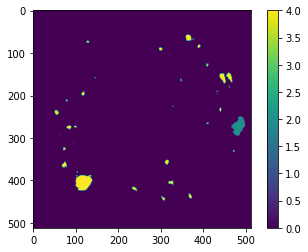

In [247]:
plt.imshow(test_gt)
plt.colorbar()

In [248]:
print(test_gt.shape)
np.unique(test_gt)

(512, 512, 1)


array([0, 1, 2, 3, 4])

In [249]:
test_gt = np.repeat(test_gt, repeats=3,axis=-1)

In [250]:
test_gt.shape

(512, 512, 3)

In [251]:
np.unique(test_gt)
#1 cotton wool spots
#2 hard_exudates
#3 microaneurysm
#4 retinal haemorrhage



array([0, 1, 2, 3, 4])

In [234]:
c = np.where(test_gt[:,:, [0,1,2]] == [2, 2, 2])
test_gt[c[0], c[1], :] = np.array([[245, 234, 133]])

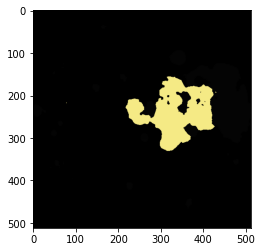

In [235]:
plt.imshow(test_gt)

In [236]:
np.unique(test_gt)

array([  0,   1,   3,   4, 133, 234, 245])

In [237]:
c = np.where(test_gt[:,:, [0,1,2]] == [4,4,4])
test_gt[c[0], c[1], :] = np.array([[133, 213, 245]])

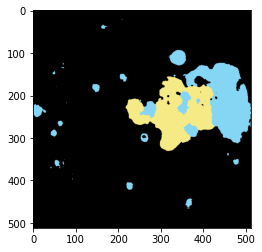

In [238]:
plt.imshow(test_gt)

In [239]:
c = np.where(test_gt[:, :, [0,1,2]] == [3, 3, 3])
test_gt[c[0], c[1], :] = np.array([[245, 128, 128]])

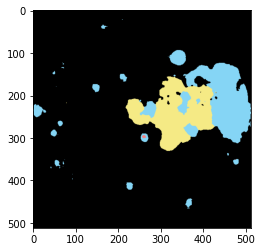

In [240]:
plt.imshow(test_gt)

In [242]:
c_dict =  {
    1 : np.array([[128, 242, 128]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[245, 128, 128]]),
    4 : np.array([[133, 213, 245]])
}

In [243]:
def color_swap(img, color_dict):
    
    for key in color_dict.keys():
        
        c = np.where(img[:, :, [0,1,2]] == [key, key, key])
        img[c[0], c[1], :] = color_dict[key]
    
    return img

In [252]:
test_gt = color_swap(test_gt, c_dict)

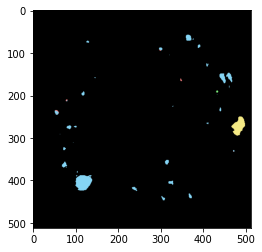

In [253]:
plt.imshow(test_gt)

#### Stage 1 Processing

In [37]:
simple_vgg = VGGUNet(5, simple=True).to(device)
complex_vgg = VGGUNet(5, simple=False).to(device)

In [38]:
simple_vgg_state_dict = torch.load("./model_weights/stage_1/vgg_simple.pth", map_location=device)
complex_vgg_state_dict = torch.load("./model_weights/stage_1/complex_vgg_best.pth", map_location=device)

simple_vgg.load_state_dict(simple_vgg_state_dict)
complex_vgg.load_state_dict(complex_vgg_state_dict)

<All keys matched successfully>

In [40]:
["background"] + classes

['background',
 'cotton_wool_spots',
 'hard_exudate',
 'microaneurysm',
 'retinal_hemorrhage']

In [142]:
c_dict =  {
    1 : np.array([[128, 242, 128]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[245, 128, 128]]),
    4 : np.array([[133, 213, 245]])
}
models_stage_1 = {
    "simple_vgg" : simple_vgg,
    "complex_vgg" : complex_vgg
}

evaluator = EvalPipeline(test_dl, 5, models_stage_1, ["background"] + classes, c_dict)

100%|██████████| 40/40 [00:12<00:00,  3.33it/s]


In [84]:
evaluator.gt.shape

(158, 512, 512, 1)

#### Error Diagnosis Break

In [74]:
test_eimg = evaluator.img[1]
test_eimg = np.transpose(test_eimg, (1,2,0))

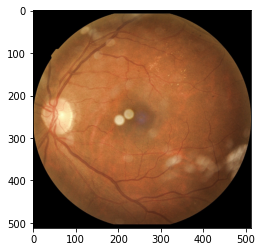

In [75]:
plt.imshow(test_eimg)

In [76]:
test_egt = evaluator.gt[1]
test_egt = np.squeeze(test_egt)

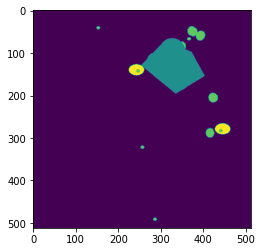

In [77]:
plt.imshow(test_egt)

In [78]:
preds_1 = evaluator.pred["simple_vgg"][1]
preds_1 = np.squeeze(preds_1)
preds_2 = evaluator.pred["complex_vgg"][1]
preds_2 = np.squeeze(preds_2)

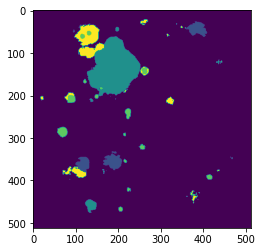

In [79]:
plt.imshow(preds_1)

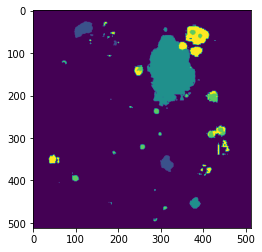

In [80]:
plt.imshow(preds_2)

#### Processing Continued

In [89]:
evaluator.stage_one(path="./experiment_results/stage_1/eval_stage_1.csv")

['SENS', 'SPEC', 'IoU', 'DSC']


{'SENS': [0.6095010349571208, 0.6246471409185574],
 'SPEC': [0.9274897255611411, 0.9294952774863106],
 'IoU': [0.3899786519541073, 0.386949272571875],
 'DSC': [0.5059734391122913, 0.5025449050252997]}

In [90]:
evaluator.stage_two(path="./experiment_results/stage_1/eval_stage_2.json")

Working on : simple_vgg...
Working on : complex_vgg...
Creating final dict


{'simple_vgg': {'background': {'SENS': 0.9691433287449751,
   'SPEC': 0.6719228586862899,
   'IoU': 0.9575845304405799,
   'DSC': 0.9783327519706779},
  'cotton_wool_spots': {'SENS': 0.5553718407616695,
   'SPEC': 0.9969914452799996,
   'IoU': 0.17030120012034633,
   'DSC': 0.2910382388787325},
  'hard_exudate': {'SENS': 0.708577735588849,
   'SPEC': 0.9917204602040746,
   'IoU': 0.4027227451908517,
   'DSC': 0.5742014900258255},
  'microaneurysm': {'SENS': 0.1859912384141163,
   'SPEC': 0.9983621882663858,
   'IoU': 0.15427302996670367,
   'DSC': 0.2673076923076923},
  'retinal_hemorrhage': {'SENS': 0.6284210312759938,
   'SPEC': 0.9784516753689547,
   'IoU': 0.2650117540520548,
   'DSC': 0.41898702237852825}},
 'complex_vgg': {'background': {'SENS': 0.9663571715187366,
   'SPEC': 0.6847625086575109,
   'IoU': 0.9552774970118607,
   'DSC': 0.977127285995729},
  'cotton_wool_spots': {'SENS': 0.6073005432708904,
   'SPEC': 0.9964052310098356,
   'IoU': 0.16406027585529867,
   'DSC': 0.2

In [108]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "3637_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "3637_right.png", "1008_right.png"]

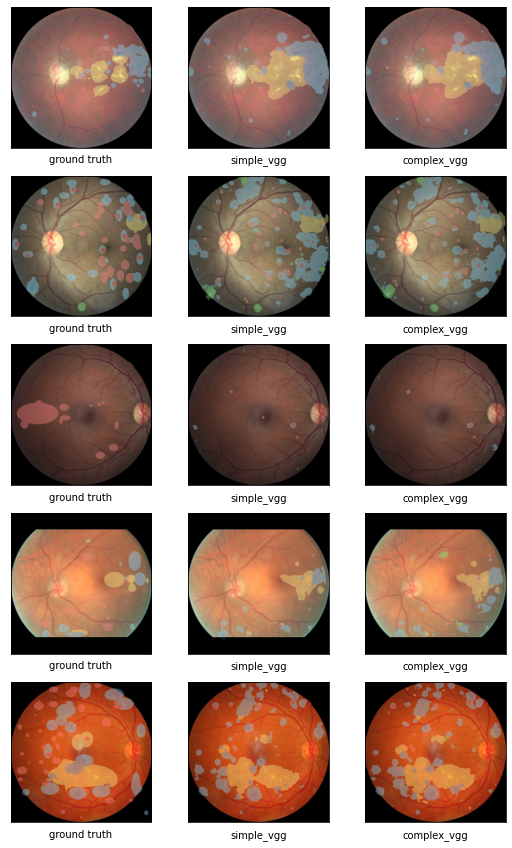

In [143]:
evaluator.stage_three(img_dir=img_dir, gt_dir=gt_dir, img_files=img_files, gt_files=gt_files, path="./experiment_results/stage_1/eval_stage_3.png")

./fundus_images/
./lesion_annotations_color/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


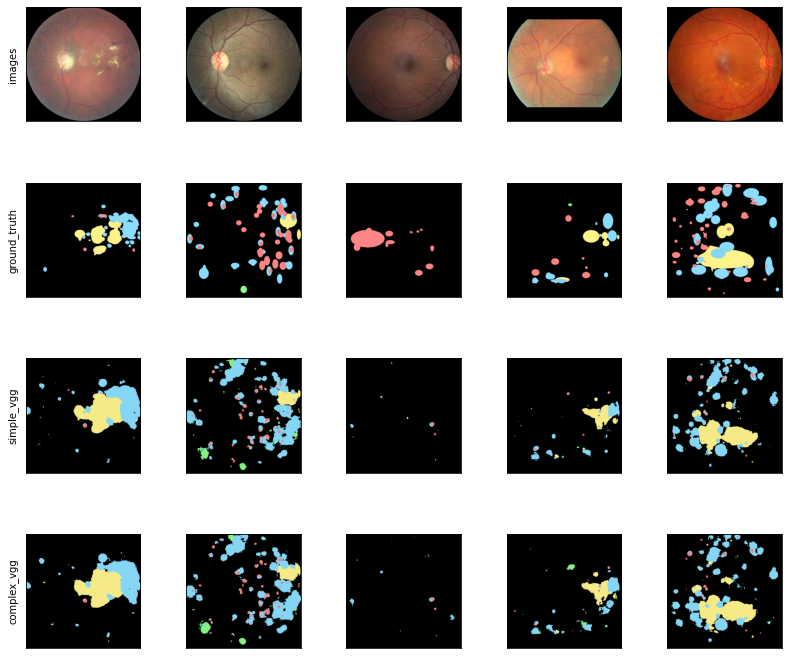

In [98]:
evaluator.stage_four(img_dir=img_dir, gt_dir=gt_dir, img_files=img_files, gt_files=gt_files, path="./experiment_results/stage_1/eval_stage_4.png")

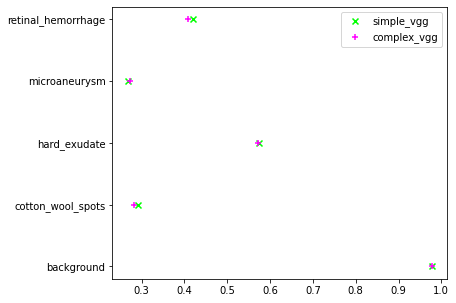

In [93]:
evaluator.stage_five(path="./experiment_results/stage_1/eval_stage_5.png")

### Stage 1

This stage will test whether to train the U-Net's encoder and decoder from scratch, or to use a pre-trained network as the encoder.

The experiments will consist of the following:

- Comparing a U-Net trained from scratch (using a simple decoder) with a U-Net using a VGG network as the pretrained encoder
- Comparing a U-Net trained from scratch (using a simple decoder) with a U-Net using a Resnet as the pretrained encoder
- Comparing a U-Net trained from scratch (using a simple decoder) with a U-Net using a Efficient-Net B4 as a pretrained encoder

<i>All the U-Nets that are being tested consist of the simple decoder</i>

In [30]:
os.listdir("./model_weights/stage_1/")

['simple_unet.pth',
 'complex_vgg_best.pth',
 'complex_effunet.pth',
 'vgg_simple.pth',
 'simple_effunet.pth',
 'complex_unet.pth',
 '.ipynb_checkpoints',
 'complex_resunet.pth',
 'simple_resunet.pth']

In [63]:
a, b, c, d = (1, 2, _, 4)

In [42]:
model_specifications = {
    #Vggs
    "simple_vgg_unet" : (1, 1, 0,"./model_weights/stage_1/vgg_simple.pth"),
    "complex_vgg_unet" : (1, 0, 0,"./model_weights/stage_1/complex_vgg_best.pth"),
    #Resnets
    "simple_resnet_unet" : (2, 1, 0,"./model_weights/stage_1/simple_resunet.pth"),
    "complex_resnet_unet" : (2, 0, 0,"./model_weights/stage_1/complex_resunet.pth"),
    #Efficientnets
    "simple_efficientnet_unet" : (3, 1, 0,"./model_weights/stage_1/simple_effunet.pth"),
    "complex_efficientnet_unet" : (3, 0, 0,"./model_weights/stage_1/complex_effunet.pth")
                            
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

class_dict = ["background"] + classes

model_dict = model_loader(model_specifications, 5)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-7eb33cd5.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-7eb33cd5.pth


  0%|          | 0.00/74.5M [00:00<?, ?B/s]

In [46]:
class_dict = ["background"] + classes

In [47]:
color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

In [45]:
evaluator = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:05<00:00,  7.56it/s]


In [86]:
runner = Evaluator(evaluator, "./experiment_results/stage_3/")

#### VGG Comparison

In [70]:
eval_specs = {
    1 : (["simple_unet", "simple_vgg_unet"], "vgg_vs_scratch_s1.csv"),
    2 : (["simple_unet", "simple_vgg_unet"], "vgg_vs_scratch_s2.json", "vgg_vs_scratch_s2.csv"),
    5 : (["simple_unet", "simple_vgg_unet"], "vgg_vs_scratch_s5.png", "vgg_vs_scratch_s5.csv")
}

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_unet...
Working on : simple_vgg_unet...
Creating final dict


/tmp/ipykernel_58/1225158377.py:355: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


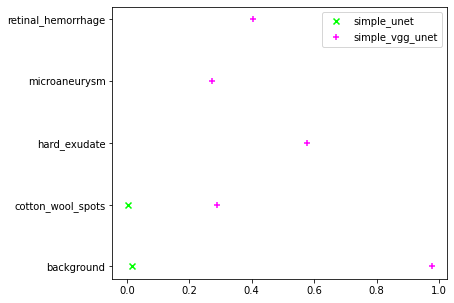

In [71]:
runner.evaluate(eval_specs)

#### Resnet Comparison

In [72]:
eval_specs = {
    1 : (["simple_unet", "simple_resnet_unet"], "res_vs_scratch_s1.csv"),
    2 : (["simple_unet", "simple_resnet_unet"], "res_vs_scratch_s2.json", "res_vs_scratch_s2.csv"),
    5 : (["simple_unet", "simple_resnet_unet"], "res_vs_scratch_s5.png", "res_vs_scratch_s5.csv")
}

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_unet...
Working on : simple_resnet_unet...
Creating final dict


/tmp/ipykernel_58/1225158377.py:355: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


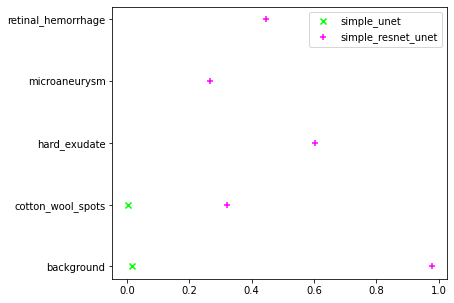

In [73]:
runner.evaluate(eval_specs)

#### Efficient Net Comparison

In [74]:
eval_specs = {
    1 : (["simple_unet", "simple_efficientnet_unet"], "b4_vs_scratch_s1.csv"),
    2 : (["simple_unet", "simple_efficientnet_unet"], "b4_vs_scratch_s2.json", "b4_vs_scratch_s2.csv"),
    5 : (["simple_unet", "simple_efficientnet_unet"], "b4_vs_scratch_s5.png", "b4_vs_scratch_s5.csv")
}

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_unet...
Working on : simple_efficientnet_unet...
Creating final dict


/tmp/ipykernel_58/1225158377.py:355: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


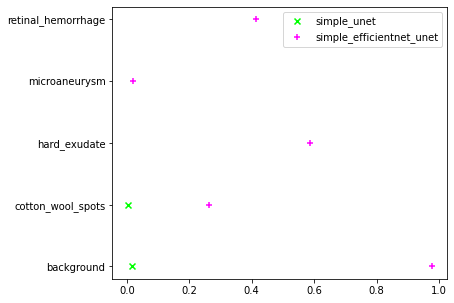

In [75]:
runner.evaluate(eval_specs)

### Stage 2

This experiment determines whether to use a simpler form of upsampling such as bilinear interpolation or whether to opt for using transposed convolutions.

In [35]:
model_specifications = {
    #Vggs
    "simple_vgg_unet" : (1, 1, 0,"./model_weights/stage_1/vgg_simple.pth"),
    "complex_vgg_unet" : (1, 0, 0,"./model_weights/stage_1/complex_vgg_best.pth"),
    #Resnets
    "simple_resnet_unet" : (2, 1, 0,"./model_weights/stage_1/simple_resunet.pth"),
    "complex_resnet_unet" : (2, 0, 0,"./model_weights/stage_1/complex_resunet.pth"),
    #Efficientnets
    "simple_efficientnet_unet" : (3, 1, 0,"./model_weights/stage_1/simple_effunet.pth"),
    "complex_efficientnet_unet" : (3, 0, 0,"./model_weights/stage_1/complex_effunet.pth")
                            
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

class_dict = ["background"] + classes

model_dict = model_loader(model_specifications, 5)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [36]:
ev = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)
runner = Evaluator(ev, "./experiment_results/stage_2/")

100%|██████████| 40/40 [00:06<00:00,  6.35it/s]


#### VGG comparison

In [37]:
eval_specs = {
    1 : (["simple_vgg_unet", "complex_vgg_unet"], "vgg_s1.csv"),
    2 : (["simple_vgg_unet", "complex_vgg_unet"], "vgg_s2.json", "vgg_s2.csv"),
    5 : (["simple_vgg_unet", "complex_vgg_unet"], "vgg_s5.png", "vgg_s5.csv")
}

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : complex_vgg_unet...
Creating final dict


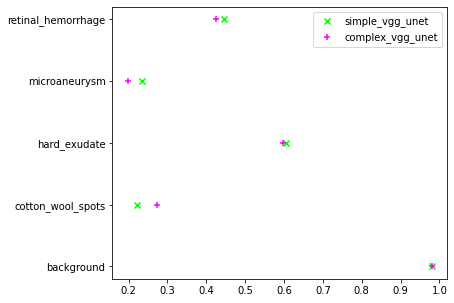

In [38]:
runner.evaluate(eval_specs)

#### Resnet Comparison

In [39]:
eval_specs = {
    1 : (["simple_resnet_unet", "complex_resnet_unet"], "res_s1.csv"),
    2 : (["simple_resnet_unet", "complex_resnet_unet"], "res_s2.json", "res_s2.csv"),
    5 : (["simple_resnet_unet", "complex_resnet_unet"], "res_s5.png", "res_s5.csv")
}

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_resnet_unet...
Working on : complex_resnet_unet...
Creating final dict


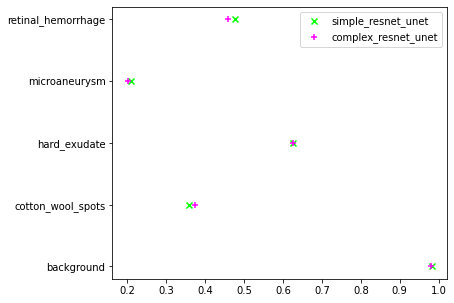

In [40]:
runner.evaluate(eval_specs)

#### Efficient Net Comparison

In [41]:
eval_specs = {
    1 : (["simple_efficientnet_unet", "complex_efficientnet_unet"], "b4_s1.csv"),
    2 : (["simple_efficientnet_unet", "complex_efficientnet_unet"], "b4_s2.json", "b4_s2.csv"),
    5 : (["simple_efficientnet_unet", "complex_efficientnet_unet"], "b4_s5.png", "b4_s5.csv")
}

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_efficientnet_unet...
Working on : complex_efficientnet_unet...
Creating final dict


/tmp/ipykernel_57/1225158377.py:355: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


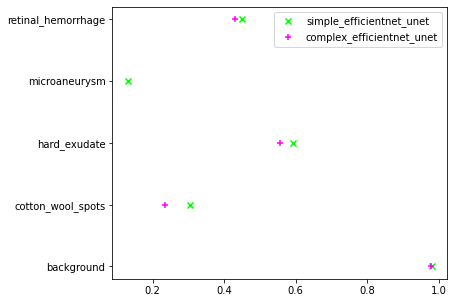

In [42]:
runner.evaluate(eval_specs)

### Stage 3

This experiment compares each of the three different UNets with each other

In [64]:
model_specifications = {
    #Vggs
    "simple_vgg_unet" : (1, 1, 0,"./model_weights/stage_1/vgg_simple.pth"),
    #Resnets
    "simple_resnet_unet" : (2, 1, 0,"./model_weights/stage_1/simple_resunet.pth"),
    #Efficientnets
    "simple_efficientnet_unet" : (3, 1, 0,"./model_weights/stage_1/simple_effunet.pth"),
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 


model_dict = model_loader(model_specifications, 5)

In [65]:
ev = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)
runner = Evaluator(ev, "./experiment_results/stage_3/")

100%|██████████| 40/40 [00:06<00:00,  5.90it/s]


In [67]:
test_preds = ev.clf_preds["simple_vgg_unet"]
#test_preds = np.argmax(test_preds, axis=-1)
test_gt = ev.clf_gt


In [74]:
mbce = MultiLabelBCEWithLogitsLoss()
dclf = DiceCLFLoss()

In [77]:
good = 0
total = 0
for p, gt in zip(test_preds, test_gt):
    if torch.equal(p, gt):
        good += 1
    total += 1

print(good / total)

0.22784810126582278


In [65]:
len(list(ev.model_dict.keys()))

3

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : simple_resnet_unet...
Working on : simple_efficientnet_unet...
Creating final dict


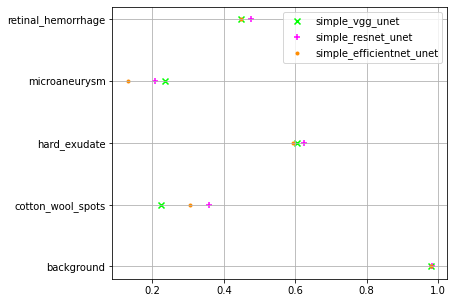

In [52]:
runner.quantative("exp3", list(model_specifications.keys()))

In [66]:
ev.stage_six(model_keys=list(model_specifications.keys()), path="./experiment_results/stage_3/exp3_s6.csv")

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : simple_resnet_unet...
Working on : simple_efficientnet_unet...
Working on : bcm_simple_vgg_unet...
Creating final dict


/tmp/ipykernel_57/3685435587.py:355: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


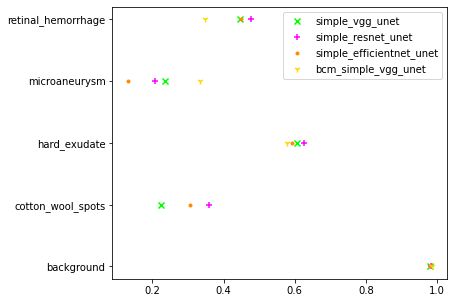

In [45]:
runner.quantative("bcm", list(model_specifications.keys()))

### Stage 4

This stage of the experiment compares the effect of using attention

#### Stage 4 Part 1 

This sub-experiment is used to determine whether to use the ReLU non-linearity in the spatial attention module.

In [36]:
stage_4_path = "./model_weights/stage_4/"
os.listdir(stage_4_path)

['simple_vgg_attention.pth', 'simple_vgg_attention_relu.pth']

In [ ]:
simple_attention_path = "./model_weights/stage_4/simple_vgg_attention.pth"
relu_attention_path = "./model_weights/stage_4/simple_vgg_attention_relu.pth"

simple_attention_state_dict = torch.load(simple_attention_path, map_location=device)
relu_attention_state_dict = torch.load(relu_attention_path, map_location=device)

simple_attention = VGGUNet(5, simple=True, attention=True, relu=False).to(device)
relu_attention = VGGUNet(5, simple=True, attention=True, relu=True).to(device)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

In [ ]:
simple_attention.load_state_dict(simple_attention_state_dict)
relu_attention.load_state_dict(relu_attention_state_dict)

<All keys matched successfully>

In [ ]:
model_dict = {
    "simple_attention" : simple_attention,
    "relu_attention" : relu_attention
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

classes = ["background"] + classes

NameError: name 'simple_attention' is not defined

In [45]:
ev_stage_4_1 = EvalPipeline(test_dl, n=5, model_dict=model_dict, class_dict=classes, color_dict=color_dict)

100%|██████████| 40/40 [00:14<00:00,  2.69it/s]


In [ ]:
runner = Evaluator(ev_stage_4_1, "./experiment_results/stage_4/")

In [ ]:
eval_specs = {}

In [49]:
ev_stage_4_1.stage_one(model_keys=["simple_attention", "relu_attention"], path="./experiment_results/stage_4/simple_vs_relu_s1.csv")

['SENS', 'SPEC', 'IoU', 'DSC']


{'SENS': [0.6389852150910631, 0.633527302262343],
 'SPEC': [0.9336100538976584, 0.9331106103841244],
 'IoU': [0.39120681563111037, 0.39263431088317113],
 'DSC': [0.5086530699175333, 0.509421185251135]}

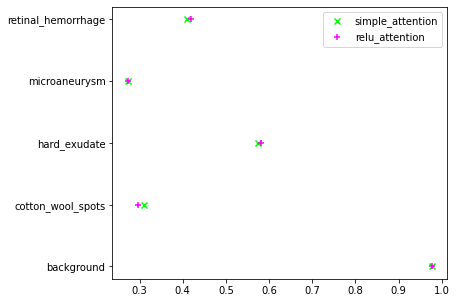

In [47]:
ev_stage_4_1.stage_five(model_keys=["simple_attention", "relu_attention"], path="./experiment_results/stage_4/simple_vs_relu_s5.png")

#### Stage 4 Part 2

This sub-stage compares the performance of the UNets trained with attention to their normal counterparts.

In [80]:
model_specifications = {
    "simple_vgg_unet" : (1, 1, 0, "./model_weights/stage_1/vgg_simple.pth"),
    "simple_resnet_unet" : (2, 1, 0, "./model_weights/stage_1/simple_resunet.pth"),
    "simple_efficientnet_unet" : (3, 1, 0, "./model_weights/stage_1/simple_effunet.pth"),
    "attention_vgg_unet" : (1, 1, 2, "./model_weights/stage_4/simple_vgg_attention_relu.pth"),
    "attention_resnet_unet" : (2, 1, 2, "./model_weights/stage_4/simple_res_attention.pth"),
    "attention_efficientnet_unet" : (3,1,2, "./model_weights/stage_4/simple_b4_attention.pth"),
    "csa_vgg_unet" : (1, 1, 1, "./model_weights/stage_4/csa_vgg.pth"),
    "csa_resnet_unet" : (2, 1, 1, "./model_weights/stage_4/csa_resnet.pth"),
    "csa_efficientnet_unet" : (3, 1, 1, "./model_weights/stage_4/csa_b4.pth")
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 


img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "3637_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "3637_right.png", "1008_right.png"]

args = (img_dir, gt_dir, img_files, gt_files)

model_dict = model_loader(model_specifications=model_specifications,num_classes=5)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [81]:
evaluator = EvalPipeline(dataloader=test_dl, n=5, model_dict=model_dict, class_dict=class_dict, color_dict=color_dict)

100%|██████████| 40/40 [00:07<00:00,  5.62it/s]


In [57]:
runner = Evaluator(evaluator, "./experiment_results/stage_4/")

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : csa_vgg_unet...
Creating final dict


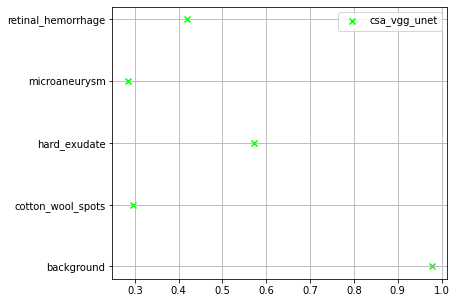

In [34]:
runner.quantative("csa_vgg", ["csa_vgg_unet"])

##### VGG Comparison

In [82]:
model_keys= [name for name in model_specifications.keys() if "vgg" in name]

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : attention_vgg_unet...
Working on : csa_vgg_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


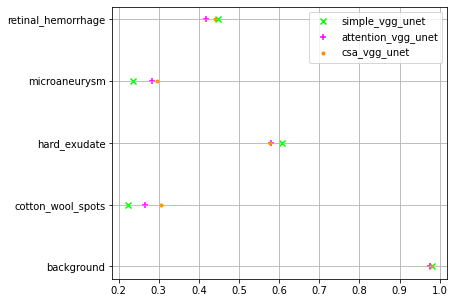

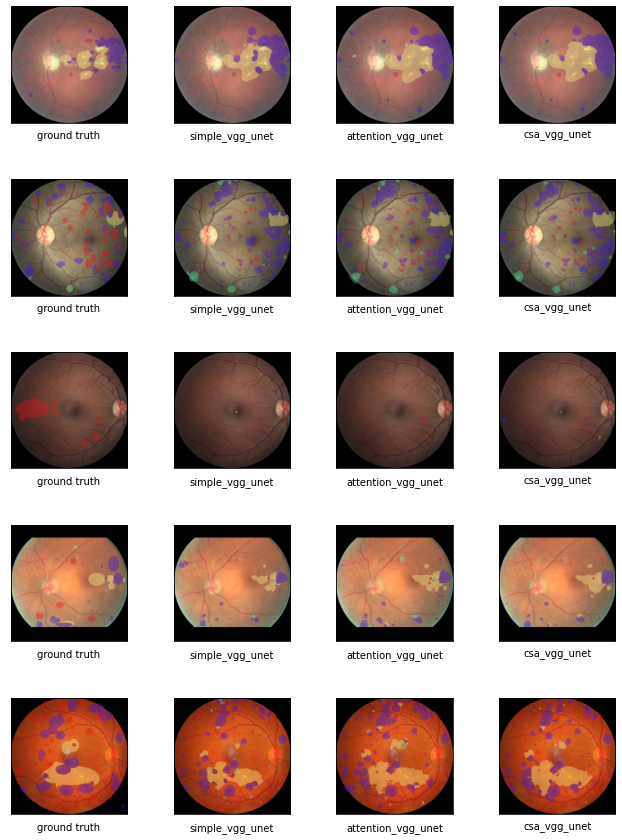

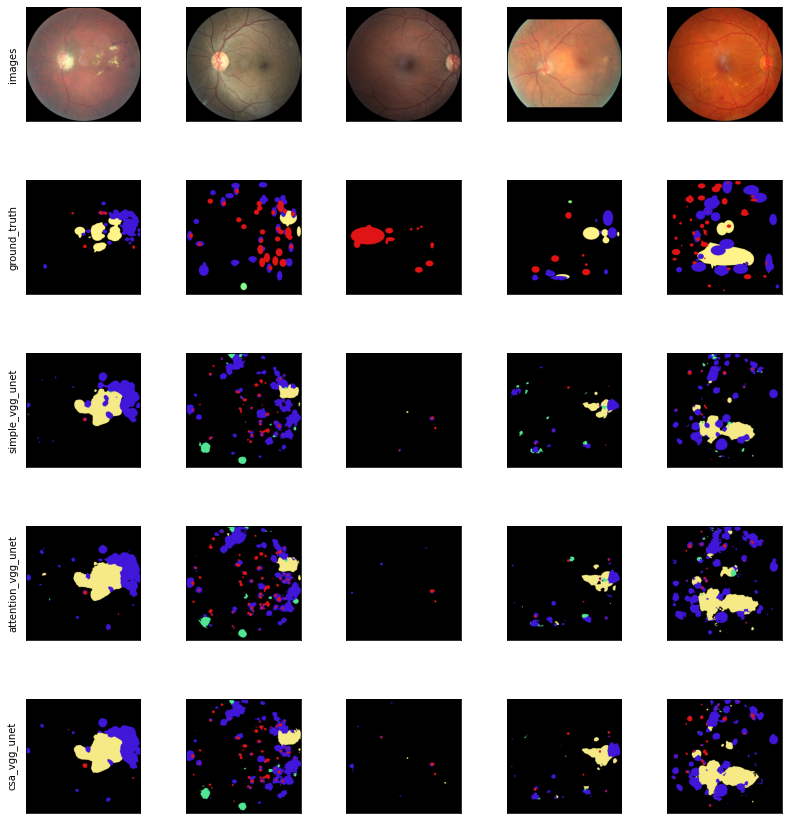

In [59]:
runner.all_routines(stub_name="vgg_attention", model_keys=model_keys, args=args)

In [83]:
evaluator.stage_six(model_keys, "./experiment_results/stage_4/vgg_attention_s6.csv")

##### Resnet Comparison

In [84]:
model_keys= [name for name in model_specifications.keys() if "res" in name]

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_resnet_unet...
Working on : attention_resnet_unet...
Working on : csa_resnet_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


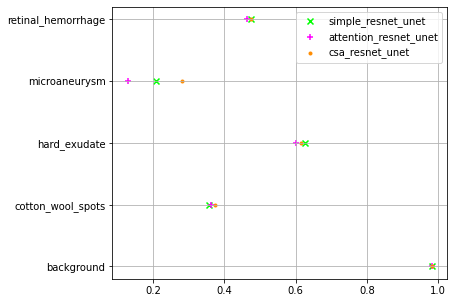

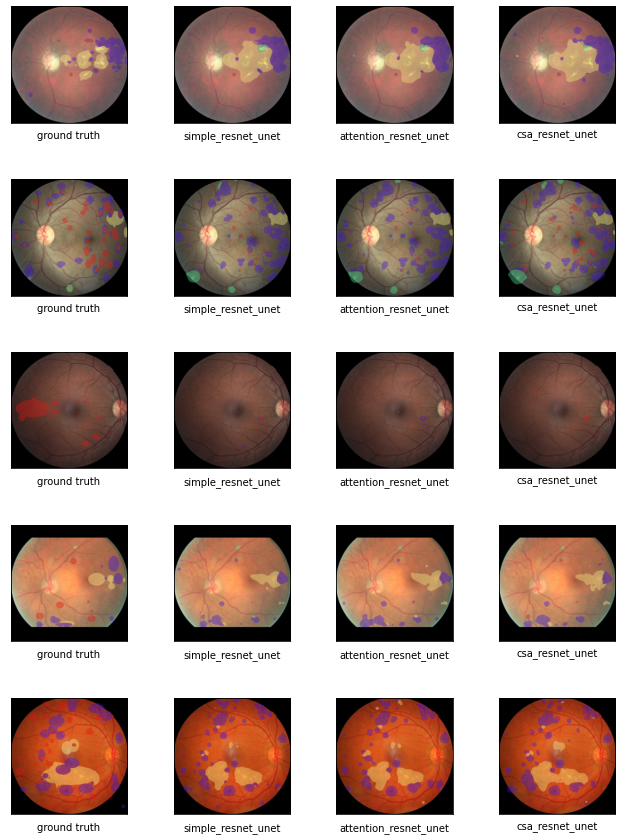

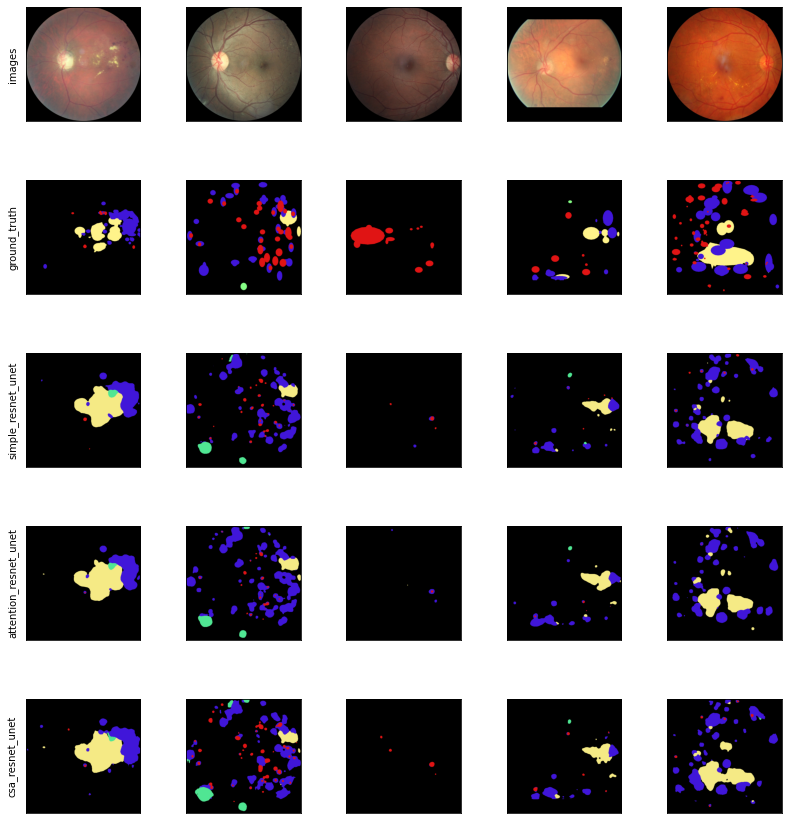

In [61]:
runner.all_routines("resnet_attention", model_keys, args)

In [85]:
evaluator.stage_six(model_keys, path="./experiment_results/stage_4/resnet_attention_s6.csv")

##### Efficient Comparison

In [86]:
model_keys=[name for name in model_specifications.keys() if "efficientnet" in name]

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_efficientnet_unet...
Working on : attention_efficientnet_unet...
Working on : csa_efficientnet_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


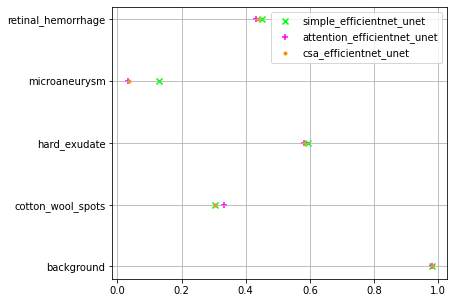

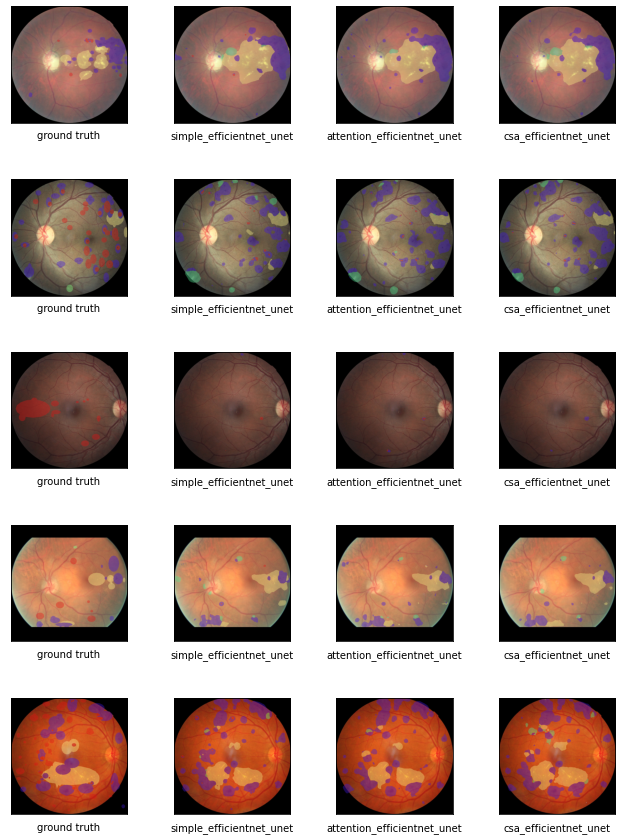

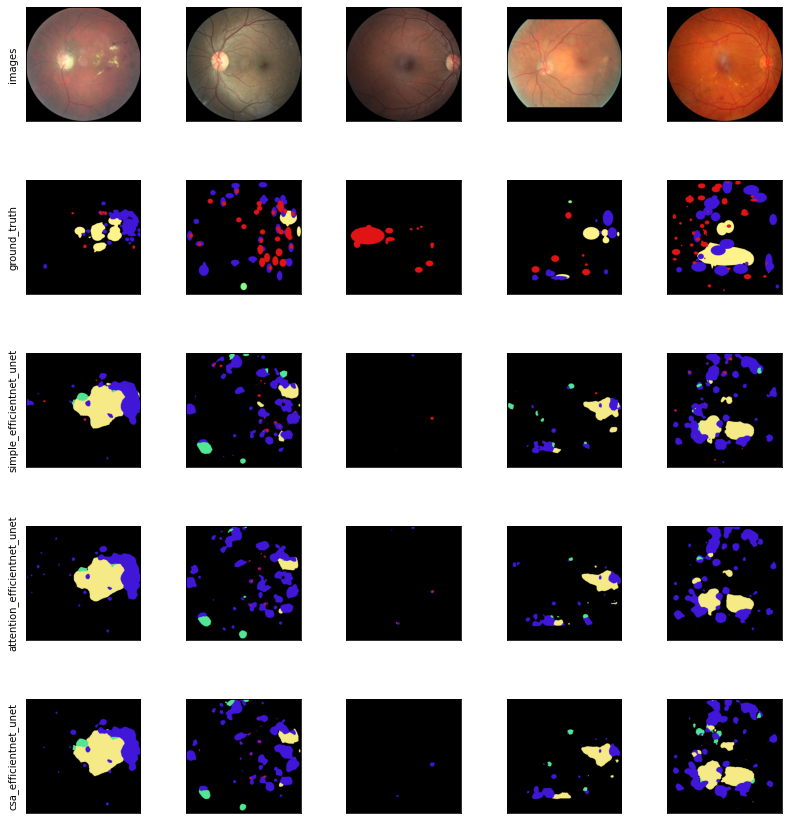

In [68]:
runner.all_routines("b4_attention", model_keys, args)

In [87]:
evaluator.stage_six(model_keys, "./experiment_results/stage_4/b4_attention_s6.csv")

#### Attention Nets Vs Non Attention Nets

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : simple_resnet_unet...
Working on : simple_efficientnet_unet...
Working on : attention_vgg_unet...
Working on : attention_resnet_unet...
Working on : attention_efficientnet_unet...
Working on : csa_vgg_unet...
Working on : csa_resnet_unet...
Working on : csa_efficientnet_unet...
Creating final dict


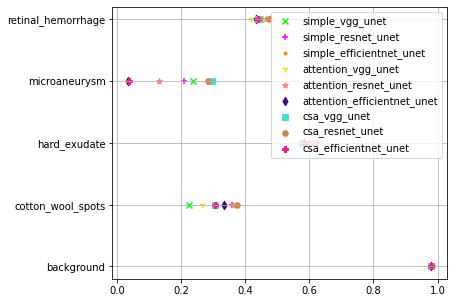

In [69]:
runner.quantative("attention_summary", list(model_specifications.keys()))

#### Comparison between the different networks with attention

In [39]:
model_keys = [key for key in model_specifications.keys() if "attention" in key]
print(model_keys)

['simple_vgg_attention_unet', 'simple_resnet_attention_unet', 'simple_efficientnet_attention_unet']


['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_attention_unet...
Working on : simple_resnet_attention_unet...
Working on : simple_efficientnet_attention_unet...
Creating final dict


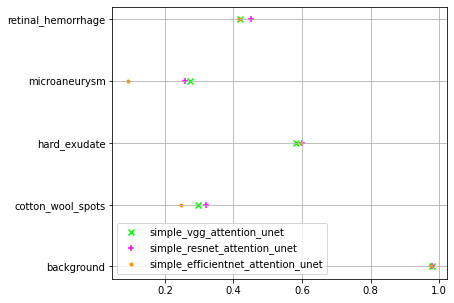

In [40]:
runner.quantative("attention_comp_e4", model_keys)

### Stage 5

This stage measures the effectiveness of training the U-Nets with a multi-task approach

In [40]:
stage_5_models = "./model_weights/stage_5/"
os.listdir(stage_5_models)

['simple_vgg_mtt_sig.pth', 'simple_vgg_mtt.pth', 'simple_res_mtt.pth']

#### Stage 5 Part 1

This experiment determines the effect between using the sigmoid or the softmax function when training with the multi-task approach.

In [48]:
model_specs = {
    "vgg_mtt_softmax" : (1,1,0, "./model_weights/stage_5/simple_vgg_mtt.pth"),
    "vgg_mtt_sigmoid" : (1,1,0, "./model_weights/stage_5/simple_vgg_mtt_sig.pth")
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

model_dict = model_loader(model_specifications=model_specs,num_classes=5)

In [49]:
ev_stage_5 = EvalPipeline(test_dl, 5, model_dict, class_dict=class_dict, color_dict=color_dict)

100%|██████████| 40/40 [00:12<00:00,  3.15it/s]


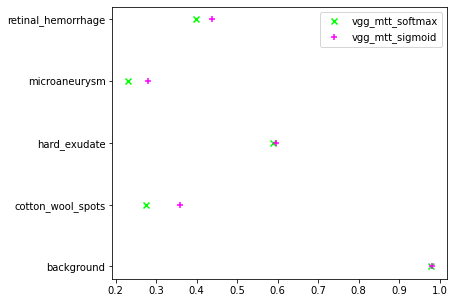

In [50]:
ev_stage_5.stage_five(model_keys=["vgg_mtt_softmax", "vgg_mtt_sigmoid"], path="./experiment_results/stage_5/s51_png")

#### Stage 5 Part 2

This sub-experiment compares the performance of the UNets trained with the multi-task training procedure to those trained normally.

In [147]:
model_specs = {
    "simple_vgg_unet" : (1, 1, 0, "./model_weights/stage_1/vgg_simple.pth"),
    "simple_resnet_unet" : (2, 1, 0, "./model_weights/stage_1/simple_resunet.pth"),
    "simple_b4_unet" : (3, 1, 0, "./model_weights/stage_1/simple_effunet.pth"),
    #Attention UNets#
    "attention_vgg_unet" : (1, 1, 2, "./model_weights/stage_4/simple_vgg_attention_relu.pth"),
    "attention_resnet_unet" : (2, 1, 2, "./model_weights/stage_4/simple_res_attention.pth"),
    "attention_b4_unet" : (3, 1, 2, "./model_weights/stage_4/simple_b4_attention.pth"),
    #CSA Attention UNet#
    "csa_vgg_unet" : (1,1,1, "./model_weights/stage_4/csa_vgg.pth"),
    "csa_resnet_unet" : (2, 1, 1, "./model_weights/stage_4/csa_resnet.pth"),
    "csa_b4_unet" : (3,1,1, "./model_weights/stage_4/csa_b4.pth"),
    #Multi-Task Unets#
    "multi-task_vgg_unet" : (1, 1, 0, "./model_weights/stage_5/simple_vgg_mtt_sig.pth"),
    "multi-task_resnet_unet" : (2, 1, 0, "./model_weights/stage_5/simple_res_mtt_2.pth"),
    "multi-task_resnet_unet_bce" : (2, 1, 0, "./model_weights/stage_5/mtt_resnet_bce.pth"),
    "multi-task-b4_unet" : (3, 1, 0, "./model_weights/stage_5/simple_b4_mtt.pth")
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_specs, 5)

In [148]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "3637_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "3637_right.png", "1008_right.png"]

In [149]:
evaluator = EvalPipeline(test_dl, n=5, model_dict=model_dict, class_dict=class_dict, color_dict=color_dict)

100%|██████████| 40/40 [00:09<00:00,  4.12it/s]


In [141]:
evaluator.stage_six(list(model_specs.keys()), "./experiment_results/stage_5/all_nets_s6.csv")

##### VGG Comparison

In [92]:
model_keys = ["simple_vgg_unet", "multi-task_vgg_unet"]

In [99]:
evaluator.stage_one(model_keys=model_keys, path="./experiment_results/stage_5/vgg_comp_s1.csv")

['SENS', 'SPEC', 'IoU', 'DSC']


KeyError: 'simple_vgg_unet'

In [84]:
evaluator.stage_two(model_keys=model_keys, path="./experiment_results/stage_5/vgg_comp_s2.json", csv_path="./experiment_results/stage_5/vgg_comp_s2.csv")





Working on : simple_vgg_unet...
Working on : multi-task_vgg_unet...
Creating final dict


{'simple_vgg_unet': {'background': {'SENS': 0.9669041698989185,
   'SPEC': 0.686428696808185,
   'IoU': 0.9558761503143394,
   'DSC': 0.9774403662120583},
  'cotton_wool_spots': {'SENS': 0.5927648672711086,
   'SPEC': 0.9966487052722416,
   'IoU': 0.16846105783877846,
   'DSC': 0.2883468930498535},
  'hard_exudate': {'SENS': 0.7110001164175629,
   'SPEC': 0.9917913865450437,
   'IoU': 0.4055992909250669,
   'DSC': 0.5771193732719229},
  'microaneurysm': {'SENS': 0.18952275629471677,
   'SPEC': 0.9983409186162345,
   'IoU': 0.15685491211391817,
   'DSC': 0.2711747350016392},
  'retinal_hemorrhage': {'SENS': 0.637856421636789,
   'SPEC': 0.9762866339628995,
   'IoU': 0.25421984099636635,
   'DSC': 0.40538322339791927}},
 'multi-task_vgg_unet': {'background': {'SENS': 0.9764108074984736,
   'SPEC': 0.6270759316434235,
   'IoU': 0.9631949843670141,
   'DSC': 0.9812524910026434},
  'cotton_wool_spots': {'SENS': 0.5279175827170812,
   'SPEC': 0.998123137634035,
   'IoU': 0.21900038440955447,

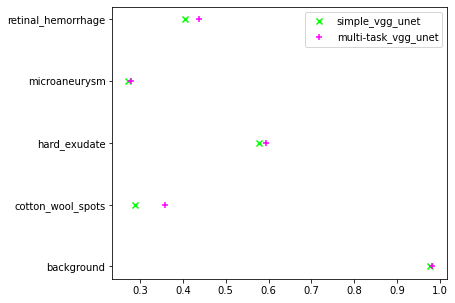

In [83]:
evaluator.stage_five(model_keys, path="./experiment_results/stage_5/vgg_comp_s5.png", csv_path="./experiment_results/stage_5/vgg_comp_s5.csv")

In [93]:
evaluator.stage_six(model_keys, path="./experiment_results/stage_5/vgg_comp_s6.csv")

In [56]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "3637_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "3637_right.png", "1008_right.png"]

./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


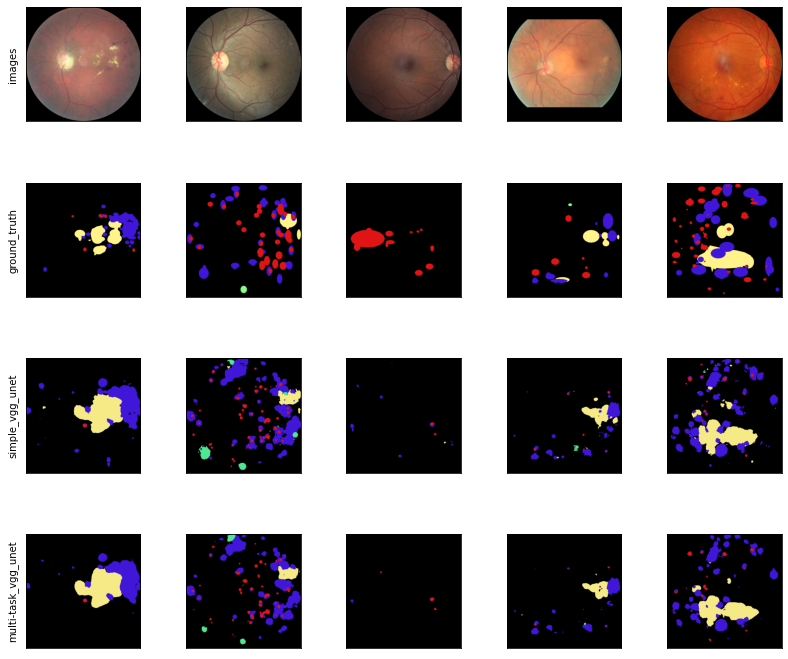

In [58]:
evaluator.stage_four(img_dir=img_dir, gt_dir=gt_dir, img_files=img_files, gt_files=gt_files, model_keys=model_keys, path="./experiment_results/stage_5/vgg_comp_s4.png")


##### Resnet Comparison

In [150]:
model_keys = ["simple_resnet_unet", "multi-task_resnet_unet", "multi-task_resnet_unet_bce"]

In [151]:
evaluator.stage_one(model_keys=model_keys, path="./experiment_results/stage_5/resnet_comp_s1.csv")

['SENS', 'SPEC', 'IoU', 'DSC']


{'SENS': [0.604, 0.627, 0.504],
 'SPEC': [0.921, 0.927, 0.893],
 'IoU': [0.414, 0.419, 0.427],
 'DSC': [0.53, 0.539, 0.548]}

In [152]:
evaluator.stage_two(model_keys=model_keys, path="./experiment_results/stage_5/resnet_comp_s2.json", csv_path="./experiment_results/stage_5/resnet_comp_s2.csv")



Working on : simple_resnet_unet...
Working on : multi-task_resnet_unet...
Working on : multi-task_resnet_unet_bce...
Creating final dict


{'simple_resnet_unet': {'background': {'SENS': 0.98,
   'SPEC': 0.628,
   'IoU': 0.966,
   'DSC': 0.983},
  'cotton_wool_spots': {'SENS': 0.631,
   'SPEC': 0.997,
   'IoU': 0.218,
   'DSC': 0.358},
  'hard_exudate': {'SENS': 0.664, 'SPEC': 0.995, 'IoU': 0.455, 'DSC': 0.625},
  'microaneurysm': {'SENS': 0.138, 'SPEC': 0.999, 'IoU': 0.116, 'DSC': 0.208},
  'retinal_hemorrhage': {'SENS': 0.607,
   'SPEC': 0.985,
   'IoU': 0.312,
   'DSC': 0.476}},
 'multi-task_resnet_unet': {'background': {'SENS': 0.975,
   'SPEC': 0.664,
   'IoU': 0.963,
   'DSC': 0.981},
  'cotton_wool_spots': {'SENS': 0.63,
   'SPEC': 0.998,
   'IoU': 0.235,
   'DSC': 0.38},
  'hard_exudate': {'SENS': 0.71, 'SPEC': 0.994, 'IoU': 0.452, 'DSC': 0.623},
  'microaneurysm': {'SENS': 0.171, 'SPEC': 0.998, 'IoU': 0.14, 'DSC': 0.245},
  'retinal_hemorrhage': {'SENS': 0.646,
   'SPEC': 0.982,
   'IoU': 0.305,
   'DSC': 0.467}},
 'multi-task_resnet_unet_bce': {'background': {'SENS': 0.993,
   'SPEC': 0.472,
   'IoU': 0.974,
   '

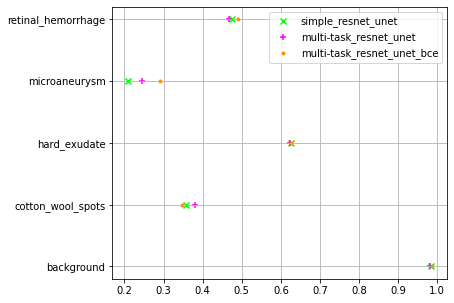

In [153]:
evaluator.stage_five(model_keys=model_keys, path="./experiment_results/stage_5/resnet_comp_s5.png", csv_path="./experiment_results/stage_5/resnet_comp_s5.csv")



In [154]:
evaluator.stage_six(model_keys, path="./experiment_results/stage_5/resnet_comp_s6.csv")

##### EfficientNet Comparison

In [96]:
model_keys = ["simple_b4_unet", "multi-task-b4_unet"]

In [94]:
evaluator.stage_one(model_keys=model_keys, path="./experiment_results/stage_5/b4_comp_s1.csv")

['SENS', 'SPEC', 'IoU', 'DSC']


{'SENS': [0.6032184260777376, 0.5854995632120202],
 'SPEC': [0.925061293068304, 0.9212759541682669],
 'IoU': [0.35886940990673, 0.38617023708437087],
 'DSC': [0.4523219052165044, 0.4929345081979862]}

In [95]:
evaluator.stage_two(model_keys=model_keys, path="./experiment_results/stage_5/b4_comp_s2.json", csv_path="./experiment_results/stage_5/b4_comp_s2.csv")


Working on : simple_b4_unet...
Working on : multi-task-b4_unet...
Creating final dict


{'simple_b4_unet': {'background': {'SENS': 0.9679628966282702,
   'SPEC': 0.6614385959660422,
   'IoU': 0.9560537850504203,
   'DSC': 0.9775332277233639},
  'cotton_wool_spots': {'SENS': 0.6844123044497338,
   'SPEC': 0.9953417627019236,
   'IoU': 0.1520593898732031,
   'DSC': 0.2639783872425864},
  'hard_exudate': {'SENS': 0.690633759302211,
   'SPEC': 0.9927692962847582,
   'IoU': 0.41522899350540093,
   'DSC': 0.586801140184267},
  'microaneurysm': {'SENS': 0.009458113631781217,
   'SPEC': 0.9998951362442772,
   'IoU': 0.009335226912952627,
   'DSC': 0.018497772918328388},
  'retinal_hemorrhage': {'SENS': 0.6636250563766914,
   'SPEC': 0.9758616741445192,
   'IoU': 0.261669654191673,
   'DSC': 0.4147989980139763}},
 'multi-task-b4_unet': {'background': {'SENS': 0.9734436942366166,
   'SPEC': 0.636579123186345,
   'IoU': 0.9605993553753575,
   'DSC': 0.9799037755895318},
  'cotton_wool_spots': {'SENS': 0.5929465632211058,
   'SPEC': 0.9977497185637219,
   'IoU': 0.2203258235043918,
 

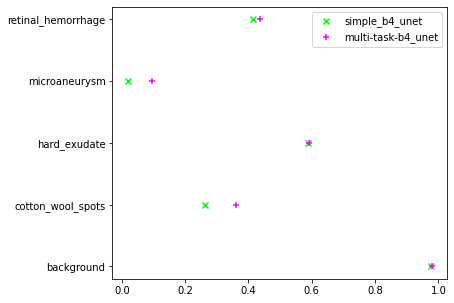

In [93]:
evaluator.stage_five(model_keys, path="./experiment_results/stage_5/b4_comp_s5.png", csv_path="./experiment_results/stage_5/b4_comp_s5.csv")

In [97]:
evaluator.stage_six(model_keys, path="./experiment_results/stage_5/b4_comp_s6.csv")

#### Stage 5 Part 3

This sub-experiment compares the models trained via multi-task training to those that are trained with attention

##### VGG Comparison

In [111]:
model_keys = ["attention_vgg_unet", "multi-task_vgg_unet"]
results_dir = "./experiment_results/stage_5/"

eval_specs = {
    1 : (model_keys, "vgg_attention_comp_s1.csv"),
    2 : (model_keys, "vgg_attention_comp_s2.json", "vgg_attention_comp_s2.csv"),
    5 : (model_keys, "vgg_attention_comp_s5.png", "vgg_attention_comp_s5.csv")
}

runner = Evaluator(eval_pipeline=evaluator, results_dir=results_dir)

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : attention_vgg_unet...
Working on : multi-task_vgg_unet...
Creating final dict


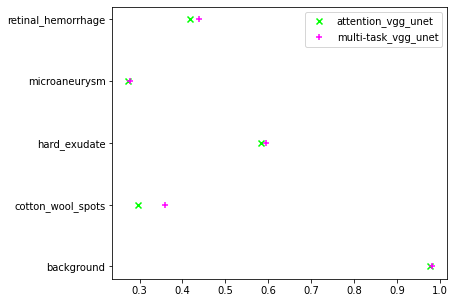

In [112]:
runner.evaluate(eval_specs)

##### Resnet Comparison

In [107]:
model_keys = ["attention_resnet_unet", "multi-task_resnet_unet"]
results_dir = "./experiment_results/stage_5/"

eval_specs = {
    1 : (model_keys, "resnet_attention_comp_s1.csv"),
    2 : (model_keys, "resnet_attention_comp_s2.json", "resnet_attention_comp_s2.csv"),
    5 : (model_keys, "resnet_attention_comp_s5.png", "resnet_attention_comp_s5.csv")
}

runner = Evaluator(eval_pipeline=evaluator, results_dir=results_dir)

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : attention_resnet_unet...
Working on : multi-task_resnet_unet...
Creating final dict


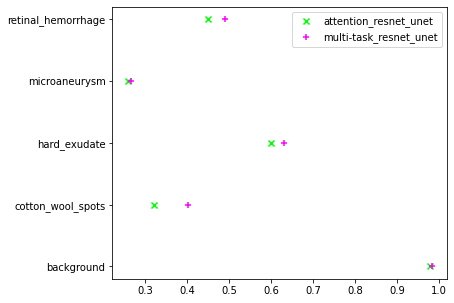

In [108]:
runner.evaluate(eval_routines=eval_specs)

##### Efficient Net Comparison

In [109]:
model_keys = ["attention_b4_unet", "multi-task-b4_unet"]
results_dir = "./experiment_results/stage_5/"

eval_specs = {
    1 : (model_keys, "b4_attention_comp_s1.csv"),
    2 : (model_keys, "b4_attention_comp_s2.json", "b4_attention_comp_s2.csv"),
    5 : (model_keys, "b4_attention_comp_s5.png", "b4_attention_comp_s5.csv")
}

runner = Evaluator(eval_pipeline=evaluator, results_dir=results_dir)

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : attention_b4_unet...
Working on : multi-task-b4_unet...
Creating final dict


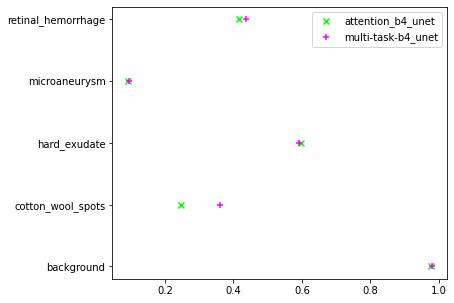

In [110]:
runner.evaluate(eval_specs)

### Stage 6

This stage compares the networks trained with both the attention and multi-task training to all the other variants.

In [45]:
model_specs = {
    "simple_vgg_unet" : (1, 1, 0, "./model_weights/stage_1/vgg_simple.pth"),
    # "simple_resnet_unet" : (2, 1, 0, "./model_weights/stage_1/simple_resunet.pth"),
    # "simple_b4_unet" : (3, 1, 0, "./model_weights/stage_1/simple_effunet.pth"),
    #Attention UNets#
    # "attention_vgg_unet" : (1, 1, 2, "./model_weights/stage_4/simple_vgg_attention_relu.pth"),
    # "attention_resnet_unet" : (2, 1, 2, "./model_weights/stage_4/simple_res_attention.pth"),
    # "attention_b4_unet" : (3, 1, 2, "./model_weights/stage_4/simple_b4_attention.pth"),
    #CSA Attention UNet#
    "csa_vgg_unet" : (1,1,1, "./model_weights/stage_4/csa_vgg.pth"),
    # "csa_resnet_unet" : (2, 1, 1, "./model_weights/stage_4/csa_resnet.pth"),
    # "csa_b4_unet" : (3,1,1, "./model_weights/stage_4/csa_b4.pth"),
    #Multi-Task Unets#
    "multi-task_vgg_unet" : (1, 1, 0, "./model_weights/stage_5/simple_vgg_mtt_sig.pth"),
    # "multi-task_resnet_unet" : (2, 1, 0, "./model_weights/stage_5/simple_res_mtt_2.pth"),
    # "multi-task_resnet_unet_bce" : (2, 1, 0, "./model_weights/stage_5/mtt_resnet_bce.pth"),
    # "multi-task-b4_unet" : (3, 1, 0, "./model_weights/stage_5/simple_b4_mtt.pth"),
    #Multi-task with CSA
    "multi-task_vgg_unet_csa" : (1,1,1,"./model_weights/stage_6/mtt_vgg_csa.pth")
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_specs, 5)

In [46]:
evaluator = EvalPipeline(test_dl, n=5, model_dict=model_dict, class_dict=class_dict, color_dict=color_dict)

100%|██████████| 40/40 [00:13<00:00,  3.07it/s]


In [48]:
runner = Evaluator(evaluator, "./experiment_results/stage_6/")

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : csa_vgg_unet...
Working on : multi-task_vgg_unet...
Working on : multi-task_vgg_unet_csa...
Creating final dict


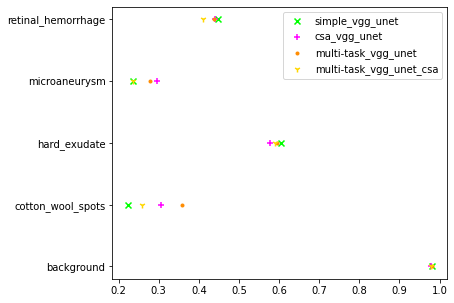

In [50]:
runner.quantative("csa_mtt",list(model_specs.keys()))

#### VGG Comparison

In [60]:
model_keys = [key for key in list(model_specs.keys()) if "vgg" in key]


In [61]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
gt_files = ['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']

args = (img_dir, gt_dir, img_files, gt_files)

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : attention_vgg_unet...
Working on : multi-task_vgg_unet...
Working on : dual_vgg_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


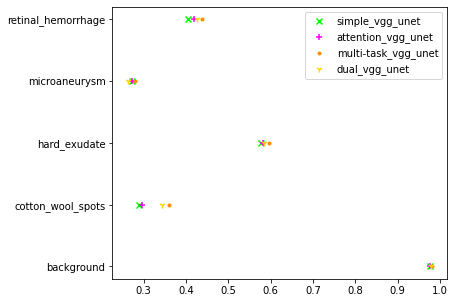

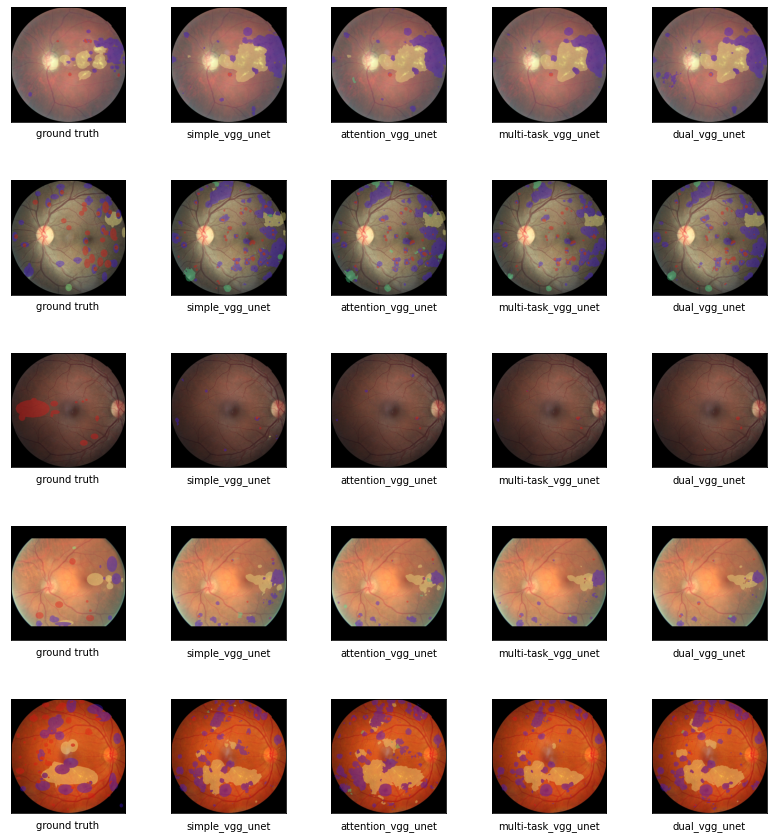

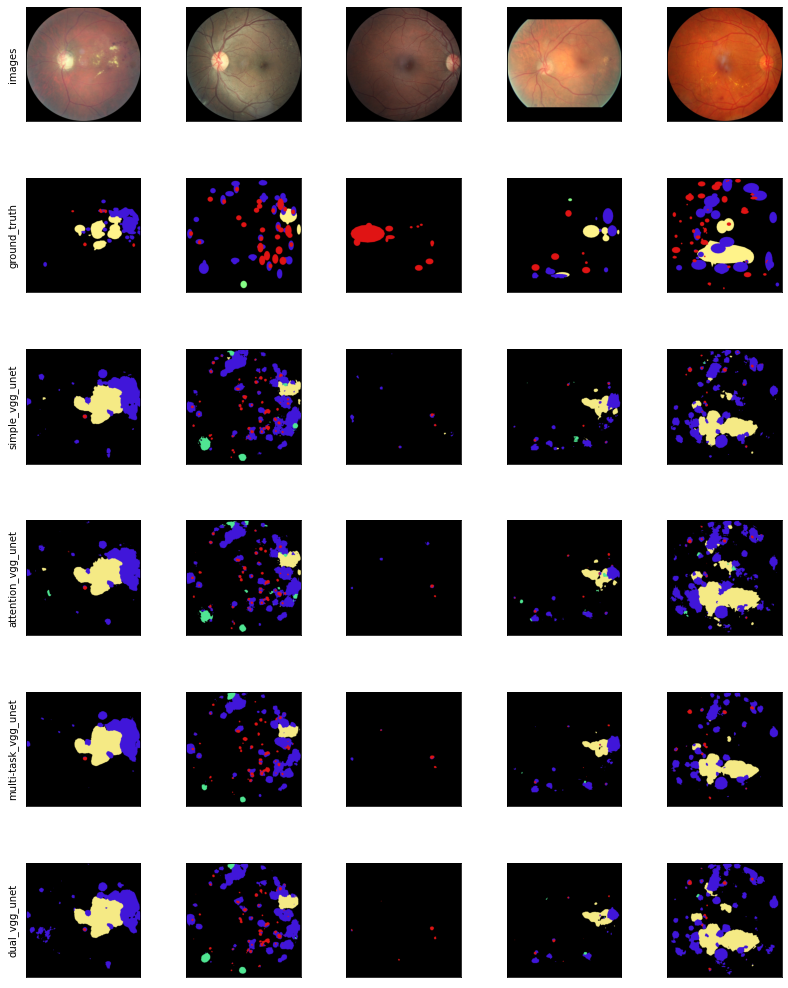

In [62]:
runner.all_routines("vgg_comp_e6", model_keys=model_keys, args=args)

#### Resnet Comparison

In [63]:
model_keys = [key for key in list(model_specs.keys()) if "resnet" in key]

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_resnet_unet...
Working on : attention_resnet_unet...
Working on : multi-task_resnet_unet...
Working on : dual_resnet_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


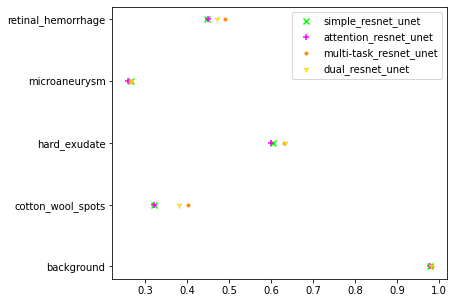

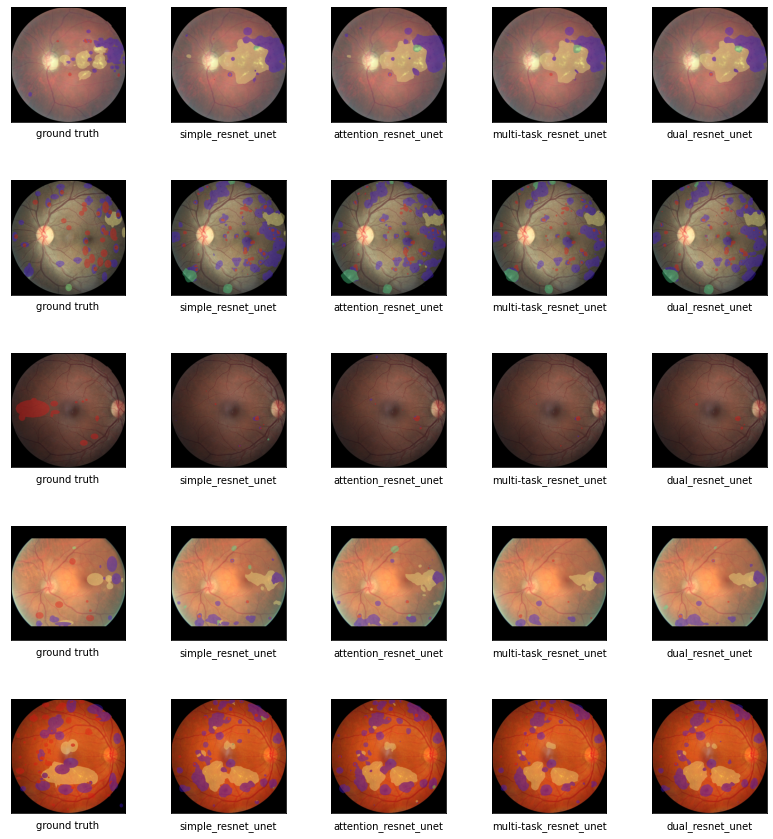

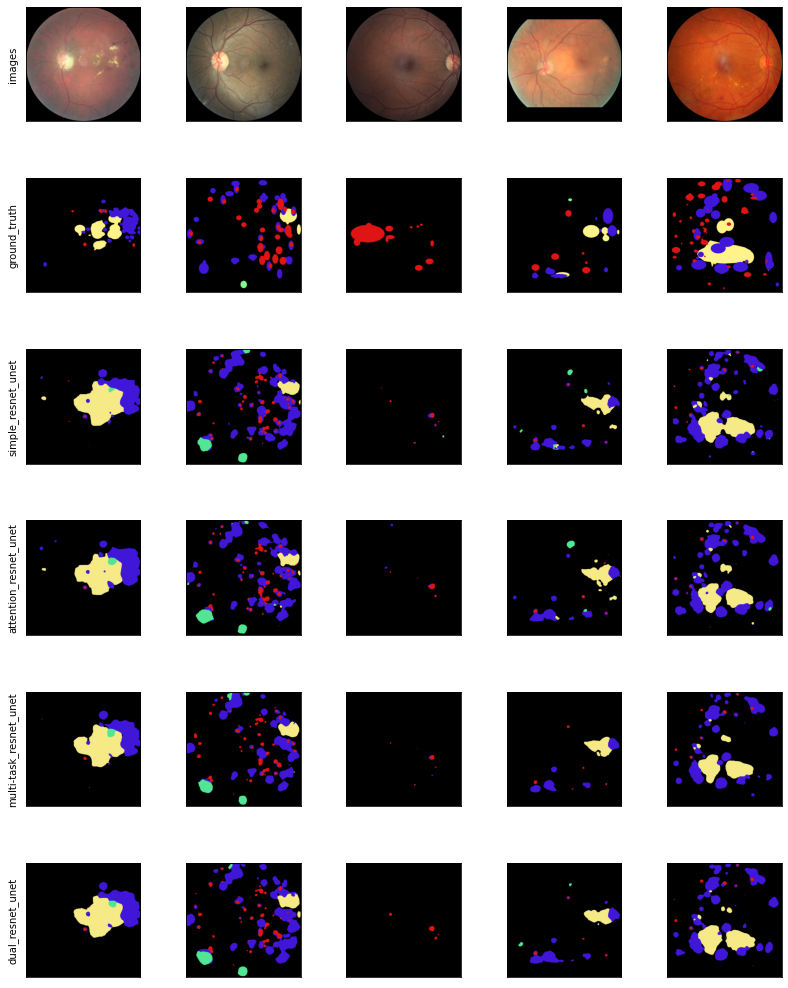

In [66]:
runner.all_routines("resnet_comp_s6", model_keys, args)

#### Efficientnet Comparison

In [67]:
model_keys = [key for key in list(model_specs.keys()) if "eff" in key]

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_efficientnet_unet...
Working on : attention_efficientnet_unet...
Working on : multi-task_efficientnet_unet...
Working on : dual_efficientnet_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


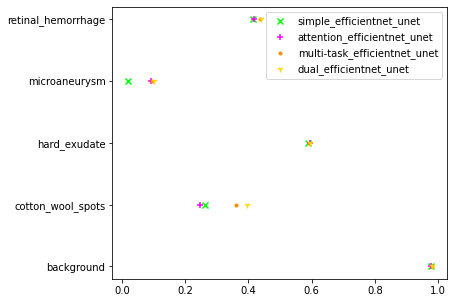

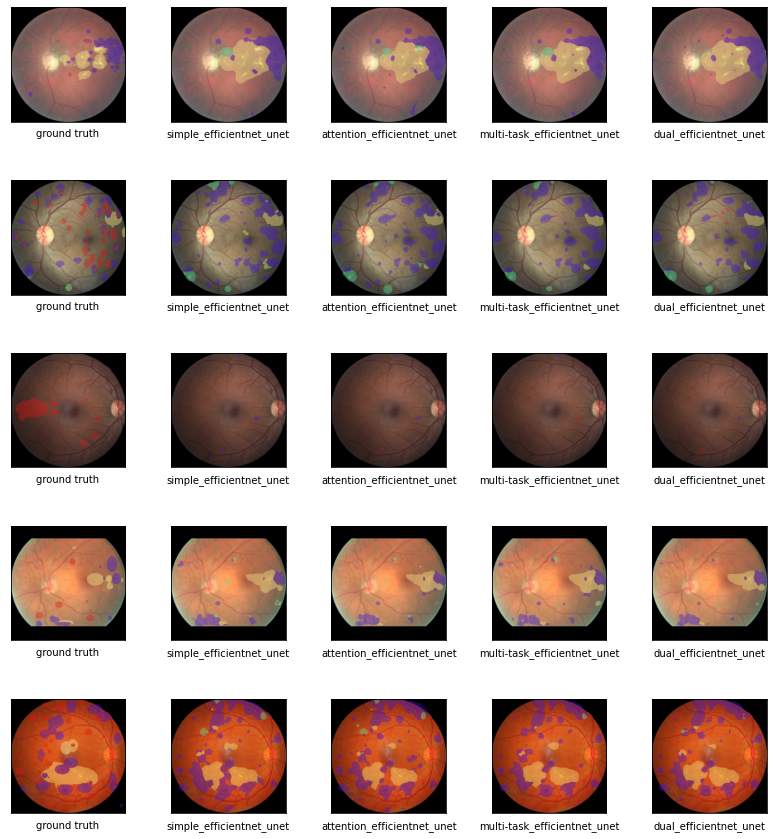

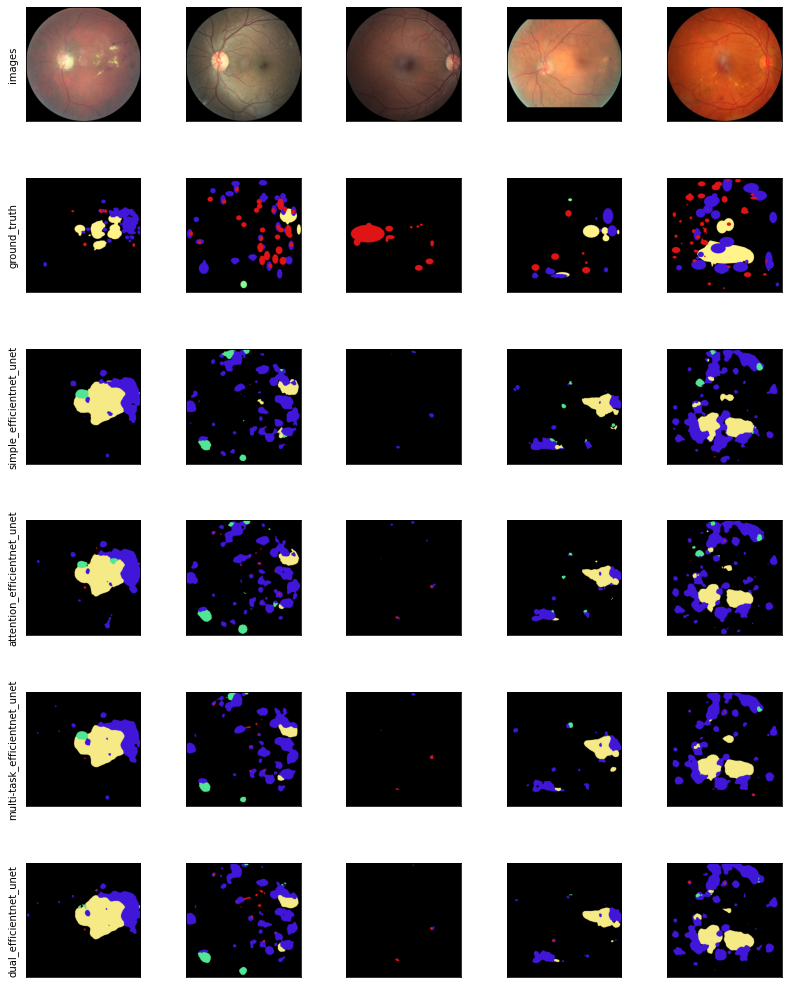

In [68]:
runner.all_routines("b4_comp", model_keys, args)

#### All Dual Networks

In [69]:
model_keys = [key for key in model_specs.keys() if "dual" in key]

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : dual_vgg_unet...
Working on : dual_resnet_unet...
Working on : dual_efficientnet_unet...
Creating final dict
./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


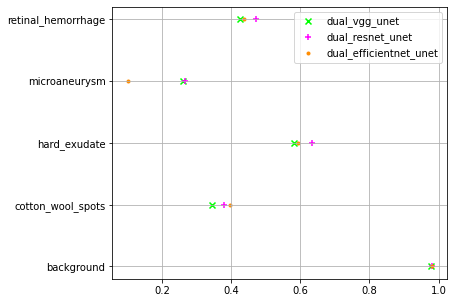

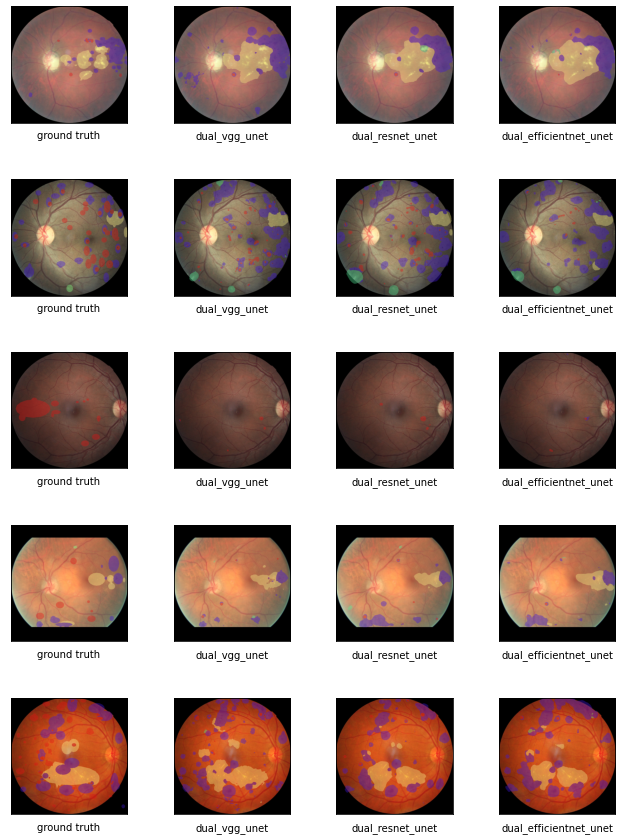

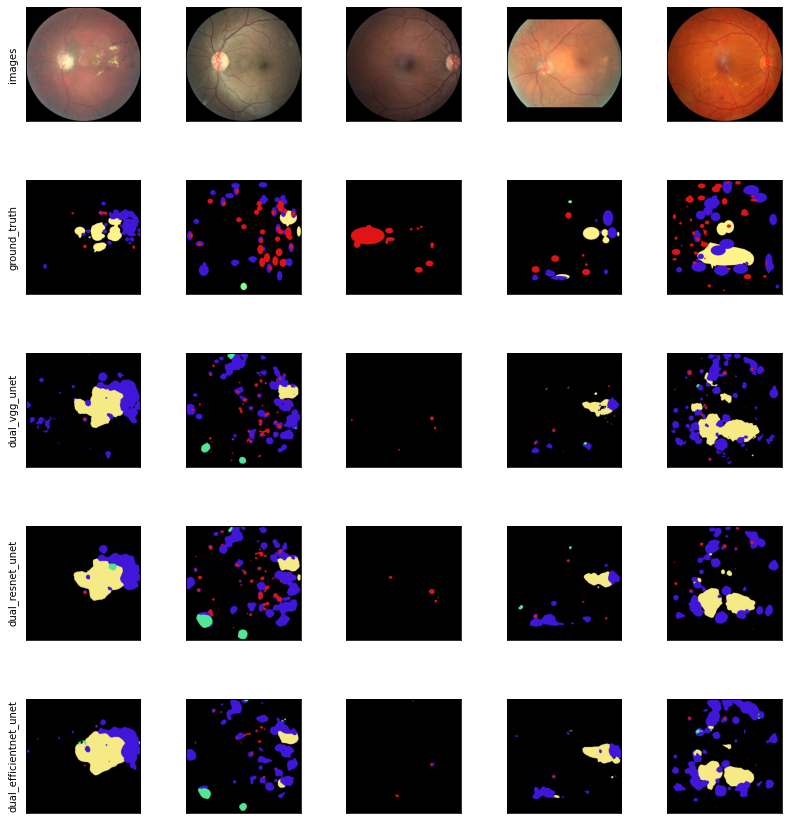

In [71]:
runner.all_routines("all_dual_nets_e6", model_keys, args)

### Stage 7

BCM experiments conducted here

In [103]:
model_spec = {
    # "vgg_unet" : (1, 1, 0, "./model_weights/stage_1/vgg_simple.pth"),
    # "vgg_unet_bcm" : (1, 1, 0, "./model_weights/stage_15_bcm/simple_vgg.pth"),
    # "csa_vgg_unet" : (1,1,1,"./model_weights/stage_4/csa_vgg.pth"),
    # "mtt_vgg_unet" : (1,1,0, "./model_weights/stage_5/simple_vgg_mtt_sig.pth"),
    #Resnet
    "resnet_unet" : (2,1,0, "./model_weights/stage_1/simple_resunet.pth"),
    "resnet_unet_bcm" : (2,1,0, "./model_weights/stage_15_bcm/simple_res.pth"),
    # "multi-task_resnet_bcm" : (2,1,0, "./model_weights/stage_15_bcm/mtt_res.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_11_dice_ce/csa_resnet.pth"),
    # "mtt_resnet_unet_bce" : (2,1,0, "./model_weights/stage_5/mtt_resnet_bce.pth"),
    # "mtt_resnet_unet" : (2,1,0, "./model_weights/stage_5/simple_res_mtt.pth"),
    # "resnet_unet_bcm_diceCE" : (2,1,0, "./model_weights/stage_15_bcm/simple_res_2.pth")
    
}

img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "3637_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "3637_right.png", "1008_right.png"]

args = (img_dir, gt_dir, img_files, gt_files)

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_spec, 5)

In [104]:
evaluator = EvalPipeline(test_dl, 5 ,model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:04<00:00,  8.78it/s]


In [105]:
runner = Evaluator(evaluator, "./experiment_results/stage_11_bcm/")

#### Binary Results

In [89]:
preds = model.predict_binary(test_dl)

100%|██████████| 40/40 [00:05<00:00,  6.67it/s]


In [88]:
model = model_dict["vgg_unet_binary"]

In [91]:
preds = np.squeeze(preds)

In [97]:
preds = np.round(preds)

In [61]:
img, gt = zip(*[(data[0].numpy(), data[1].numpy()) for data in test_dl])
gt = np.concatenate(gt)

In [93]:
gt.shape

(158, 512, 512)

In [101]:
evaluate(gt, preds, metric="IoU", multi_class=False)

0.2164119175965743

#### VGG Results

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : vgg_unet...
Working on : vgg_unet_bcm...
Working on : csa_vgg_unet...
Working on : mtt_vgg_unet...
Creating final dict


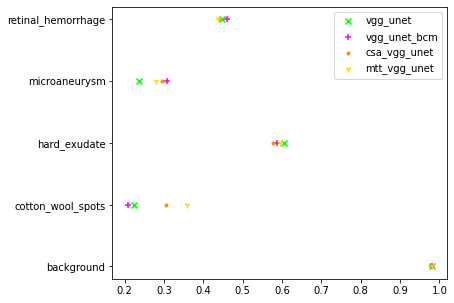

In [137]:
runner.quantative(stub_name="vgg_unet",model_keys=[key for key in model_spec.keys() if "vgg" in key])

#### Resnet Results

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : resnet_unet...
Working on : multi-task_resnet_bcm...
Working on : csa_resnet_unet...
Working on : multi-task_resnet_unet_bce...
Working on : resnet_unet_bcm_diceCE...
Creating final dict


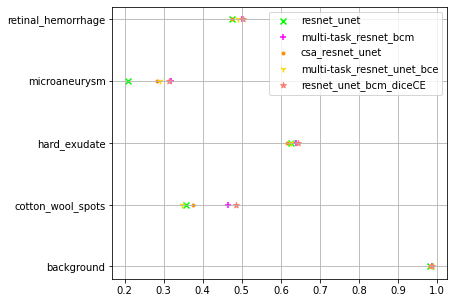

In [ ]:
runner.quantative("resnet_comp", model_keys=[key for key in model_spec.keys() if "res" in key])

./fundus_images/
./lesion_annotations_color_darker/
['25867_left.jpg', '3868_left.jpg', '17840_right.jpg', '3637_right.jpg', '1008_right.jpg']
['25867_left.png', '3868_left.png', '17840_right.png', '3637_right.png', '1008_right.png']


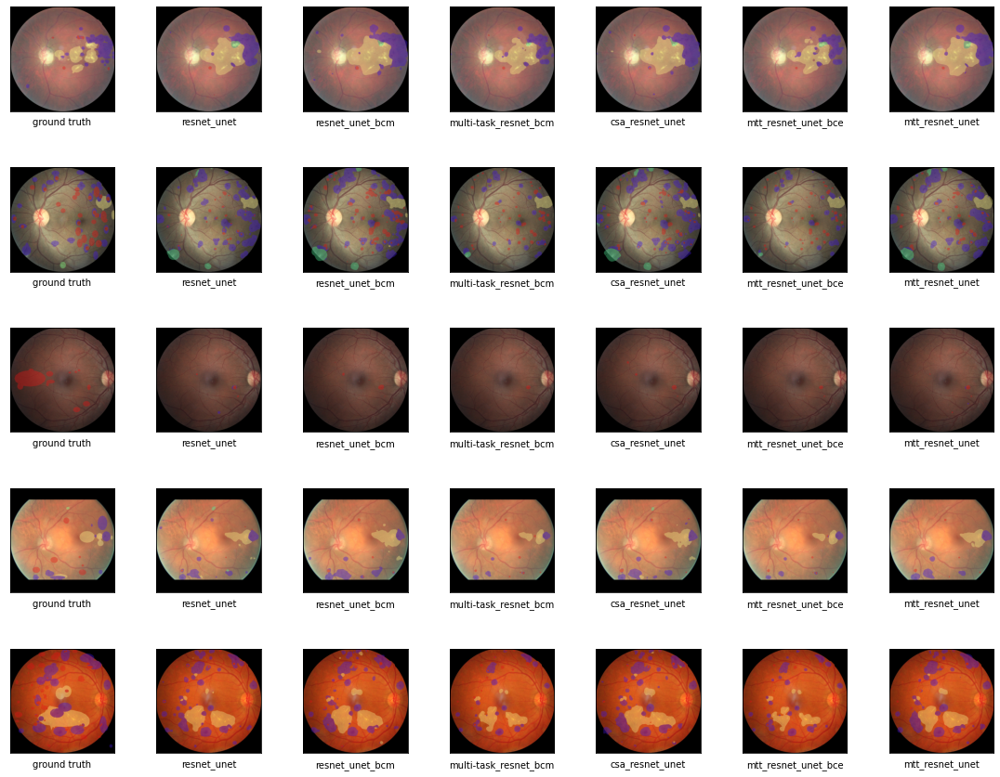

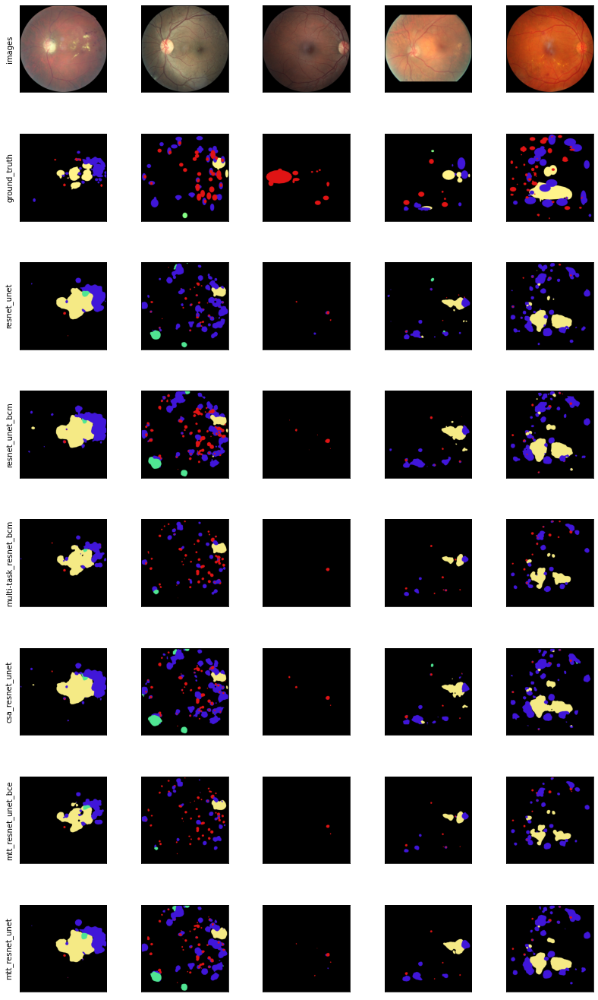

In [92]:
runner.qualitative("resnet_comp", [key for key in model_spec.keys() if "res" in key], args)

### Stage 8

RFT experiments conducted here

In [101]:
model_spec = {
    # "vgg_unet" : (1, 1, 0, "./model_weights/stage_1/vgg_simple.pth"),
    # "vgg_unet_bcm" : (1, 1, 0, "./model_weights/stage_15_bcm/simple_vgg.pth"),
    # "csa_vgg_unet" : (1,1,1,"./model_weights/stage_4/csa_vgg.pth"),
    # "mtt_vgg_unet" : (1,1,0, "./model_weights/stage_5/simple_vgg_mtt_sig.pth"),
    #Resnet
    "csa_resnet_diceCE" : (2,1,1, "./model_weights/stage_11_dice_ce/csa_resnet.pth"),
    "csa_resnet_mtt_1" : (2,1,1, "./model_weights/stage_17_rft/csa_resnet.pth"),
    "csa_resnet_mtt_2" : (2,1,1, "./model_weights/stage_17_rft/csa_resnet_2.pth"),
    "csa_resnet_bcm" : (2,1,1, "./model_weights/stage_17_rft/csa_resnet_bcm.pth"),
    "csa_resnet_bcm_re" : (2,1,1, "./model_weights/stage_17_rft/csa_resnet_bcm_3.pth")
    
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_spec, 5)

In [102]:
evaluator = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:04<00:00,  8.57it/s]


In [103]:
runner = Evaluator(evaluator, "./experiment_results/stage_12_rft/")

In [104]:
list(model_spec.keys())

['csa_resnet_diceCE',
 'csa_resnet_mtt_1',
 'csa_resnet_mtt_2',
 'csa_resnet_bcm',
 'csa_resnet_bcm_re']

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : csa_resnet_diceCE...
Working on : csa_resnet_mtt_1...
Working on : csa_resnet_mtt_2...
Working on : csa_resnet_bcm...
Working on : csa_resnet_bcm_re...
Creating final dict


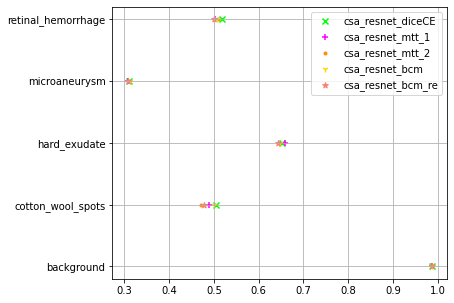

In [105]:
runner.quantative("exp12", list(model_spec.keys()))

### Stage 9

Alternative optimization experiments conducted here

In [41]:
model_spec = {
    #Resnet
    "csa_resnet_diceCE" : (2,1,1, "./model_weights/stage_11_dice_ce/csa_resnet.pth"),
    "csa_resnet_AO" : (2,1,1, "./model_weights/stage_18_alternative_optimization/csa_resnet.pth"),
    "csa_resnet_re" : (2,1,1, "./model_weights/stage_11_dice_ce/csa_resnet_2.pth")
    
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_spec, 5)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [42]:
ev = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:07<00:00,  5.52it/s]


In [43]:
runner = Evaluator(ev, "./experiment_results/stage_13_ao/")

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : csa_resnet_diceCE...
Working on : csa_resnet_AO...
Working on : csa_resnet_re...
Creating final dict


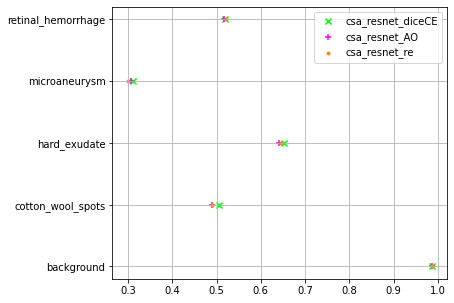

In [44]:
runner.quantative("csa_resnet", list(model_spec.keys()))

### Stage 10

This section evaluates the performance of models trained using subtractive classification decoders

In [78]:
model_spec = {
    "simple_vgg_unet" : (1, 1, 0, 0,"./model_weights/stage_1/vgg_simple.pth"),
    "complex_vgg_unet" : (1, 0, 0, 0,"./model_weights/stage_1/complex_vgg_best.pth"),
    "subtractive_vgg_unet" : (1, 1, 0, 1, "./model_weights/stage_19_subtractive_classification/simple_vgg.pth"),
    "bcm_vgg_unet" : (1, 1, 0, 0,"./model_weights/stage_15_bcm/simple_vgg_05.pth"),
    "subtractive_bcm_vgg_unet" : (1,1,0,1, "./model_weights/stage_19_subtractive_classification/bcm_vgg.pth")
    # "simple_csa_vgg_unet" : (1, 1, 1, 0,"./model_weights/stage_4/csa_vgg.pth"),
    # "subtractive_csa_vgg_unet" : (1,1,1,1, "./model_weights/stage_19_subtractive_classification/csa_vgg.pth"),
    
    #ResNets
    # "simple_res_unet" : (2, 1, 0, 0, "./model_weights/stage_1/simple_resunet.pth"),
    # "complex_res_unet" : (2, 0, 0, 0, "./model_weights/stage_1/complex_resunet.pth"),
    # # "bcm_res_unet" : (2, 1, 0, 0, "./model_weights/stage_15_bcm/simple_res_015.pth"),
    # "csa_res_unet" : (2,1,1,0, "./model_weights/stage_4/csa_resnet.pth"),
    # "subtractive_res_unet": (2,1,0,1, "./model_weights/stage_19_subtractive_classification/simple_res.pth"),
    # "subtractive_csa_res_unet" : (2,1,1,1, "./model_weights/stage_19_subtractive_classification/csa_resnet.pth")
    
#     #B4 Unets#
#     "simple_b4_unet" : (3,1,0,0, "./model_weights/stage_1/simple_effunet.pth"),
#     "comples_b4_unet" : (3,0,0,0, "./model_weights/stage_1/complex_effunet.pth"),
#     "csa_b4_unet" : (3,1,1,0, "./model_weights/stage_4/csa_b4.pth"),
#     "subtractive_b4_unet" : (3,1,0,1, "./model_weights/stage_19_subtractive_classification/simple_b4.pth")
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_spec, 5)

In [79]:
[key for key in model_dict.keys() if "vgg" in key]

['simple_vgg_unet',
 'complex_vgg_unet',
 'subtractive_vgg_unet',
 'bcm_vgg_unet',
 'subtractive_bcm_vgg_unet']

In [80]:
ev = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)

AttributeError: 'str' object has no attribute 'max_pool2d'

In [57]:
runner = Evaluator(ev, "./experiment_results/stage_14_sc/")

#### VGG Experiments

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : complex_vgg_unet...
Working on : subtractive_vgg_unet...
Working on : bcm_vgg_unet...
Working on : subtractive_bcm_vgg_unet...
Creating final dict


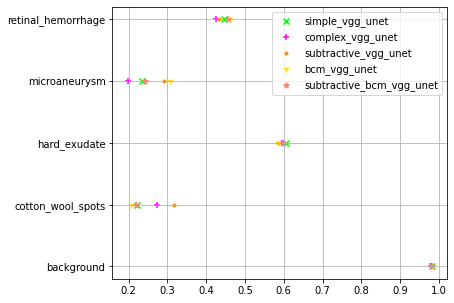

In [58]:
runner.quantative("vgg_bcm", [key for key in model_dict.keys() if "vgg" in key])

#### ResNet Experiments

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_res_unet...
Working on : complex_res_unet...
Working on : csa_res_unet...
Working on : subtractive_res_unet...
Working on : subtractive_csa_res_unet...
Creating final dict


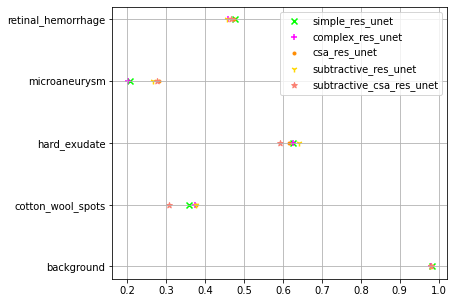

In [65]:
runner.quantative("resnet", [key for key in model_spec.keys() if "res" in key])

#### B4 UNet

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_b4_unet...
Working on : comples_b4_unet...
Working on : csa_b4_unet...
Working on : subtractive_b4_unet...
Creating final dict


/tmp/ipykernel_57/3472906499.py:395: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


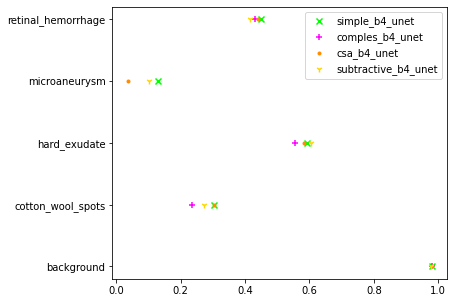

In [72]:
runner.quantative("b4", [key for key in model_spec.keys() if "b4" in key])

## Experiments on Image Pre-processing

#### Initialization

In [68]:
model_specifications_norm = {
    "simple_vgg_unet" : (1,1,0, "./model_weights/stage_1/vgg_simple.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_4/csa_resnet.pth"),
    "multi-task_resnet_unet" : (2,1,0, "./model_weights/stage_5/simple_res_mtt.pth"),
    "attention_b4_unet" : (3, 1, 2, "./model_weights/stage_4/simple_b4_attention.pth")
}

model_specifications_enh1 = {
    "simple_vgg_unet" : (1,1,0, "./model_weights/stage_7/simple_vgg.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_7/csa_resnet.pth"),
    "multi-task_resnet_unet" : (2,1,0, "./model_weights/stage_7/res_mtt_simple.pth"),
    "attention_b4_unet" : (3,1,2, "./model_weights/stage_7/attention_b4.pth")
}

model_specifications_enh2 = {
    "simple_vgg_unet" : (1,1,0, "./model_weights/stage_8/simple_vgg.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_8/csa_resnet.pth"),
    "multi-task_resnet_unet" : (2,1,0, "./model_weights/stage_8/res_mtt_simple.pth"),
    "attention_b4_unet" : (3,1,2, "./model_weights/stage_8/attention_b4.pth")
}

model_specifications_enh3 = {
    "simple_vgg_unet" : (1,1,0, "./model_weights/stage_9/simple_vgg.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_9/csa_resnet.pth"),
    "multi-task_resnet_unet" : (2,1,0, "./model_weights/stage_9/res_mtt_simple.pth"),
    "attention_b4_unet" : (3,1,2, "./model_weights/stage_9/attention_b4.pth")
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

class_dict = ["background"] + classes

model_dict_norm = model_loader(model_specifications=model_specifications_norm, num_classes=5)
model_dict_enh1 = model_loader(model_specifications_enh1, 5)
model_dict_enh2 = model_loader(model_specifications_enh2, 5)
model_dict_enh3 = model_loader(model_specifications_enh3, 5)




/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [69]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "3637_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "3637_right.png", "1008_right.png"]

args_1 = ("./fundus_images/", gt_dir, img_files, gt_files)
args_2 = ("./enhancement_one_x/", gt_dir, img_files, gt_files)
args_3 = ("./enhancement_two_x/", gt_dir, img_files, gt_files)
args_4 = ("./enhancement_three/", gt_dir, img_files, gt_files)

In [70]:
ev_1 = EvalPipeline(datasets[0], n=5, model_dict=model_dict_norm, class_dict=class_dict, color_dict=color_dict)
runner_1 = Evaluator(ev_1, "./experiment_results/stage_7/")

100%|██████████| 40/40 [00:04<00:00,  8.40it/s]


In [93]:
ev_2 = EvalPipeline(datasets[1], n=5, model_dict=model_dict_enh1, class_dict=class_dict, color_dict=color_dict)
runner_2 = Evaluator(ev_2, "./experiment_results/stage_7/")

100%|██████████| 40/40 [00:04<00:00,  9.90it/s]


In [72]:
ev_3 = EvalPipeline(datasets[2], n=5, model_dict=model_dict_enh2, class_dict=class_dict, color_dict=color_dict)
runner_3 = Evaluator(ev_3, "./experiment_results/stage_8/")

100%|██████████| 40/40 [00:04<00:00,  8.79it/s]


In [115]:
ev_4 = EvalPipeline(datasets[-1], n=5, model_dict=model_dict_enh3, class_dict=class_dict, color_dict=color_dict)
runner_4 = Evaluator(ev_4, "./experiment_results/stage_9/")

100%|██████████| 40/40 [00:05<00:00,  6.83it/s]


### Stage 7
This experiment determines the impact of using different fundus preprocessing techniques. This method of enhancement applies CLAHE to the R, G, and B channels of an image.

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : csa_resnet_unet...
Working on : multi-task_resnet_unet...
Working on : attention_b4_unet...
Creating final dict


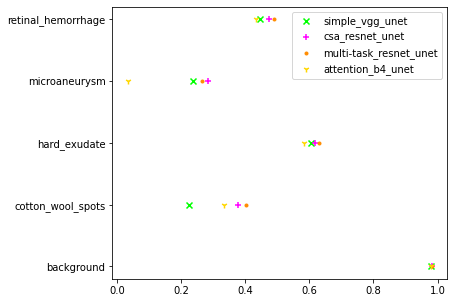

In [74]:
runner_1.quantative("no_preprocessing", list(model_specifications_norm.keys()))

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : csa_resnet_unet...
Working on : multi-task_resnet_unet...
Working on : attention_b4_unet...
Creating final dict


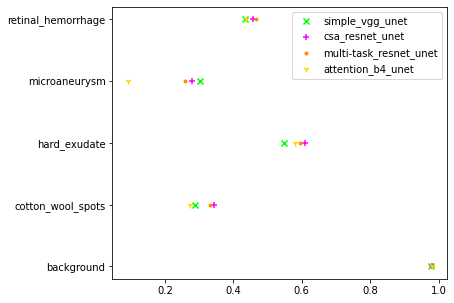

In [94]:
runner_2.quantative("enhancement_1", list(model_specifications_enh1.keys()))

### Stage 8

This experiment involves images preprocess with CLAHE applied only on the green channel

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : csa_resnet_unet...
Working on : multi-task_resnet_unet...
Working on : attention_b4_unet...
Creating final dict


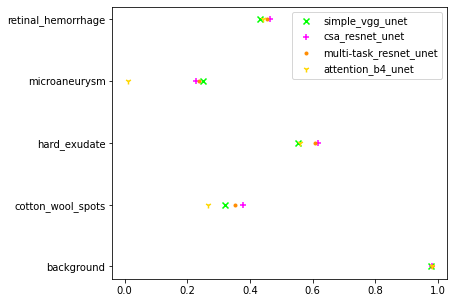

In [96]:
runner_3.quantative("enhancement_2", list(model_specifications_enh2.keys()))

#### BCM Comparison

In [69]:
model_specifications_enh1 = {
    "bcm_resnet_unet" : (2,1,0, "./model_weights/stage_7/bcm_resnet.pth")
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

class_dict = ["background"] + classes

model_dict_enh1 = model_loader(model_specifications_enh1, 5)

In [72]:
ev_1 = EvalPipeline(test_dl, n=5, model_dict=model_dict_enh1, class_dict=class_dict, color_dict=color_dict)
runner_1 = Evaluator(ev_1, "./experiment_results/stage_7/")

100%|██████████| 40/40 [00:05<00:00,  6.89it/s]


['SENS', 'SPEC', 'IoU', 'DSC']
Working on : bcm_resnet_unet...
Creating final dict


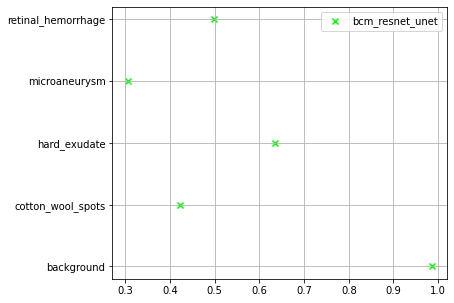

In [73]:
runner_1.quantative("bcm_resnet", list(model_specifications_enh1.keys()))

### Stage 9

This experiment involves image preprocesing with CLAHE applied to L channel in the LAB color space.

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : csa_resnet_unet...
Working on : multi-task_resnet_unet...
Working on : attention_b4_unet...
Creating final dict


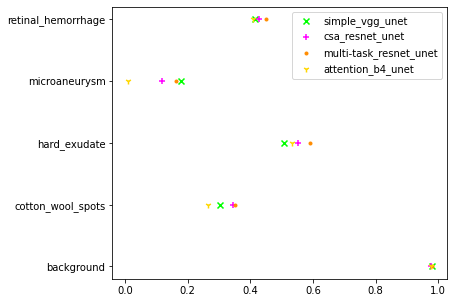

In [116]:
runner_4.quantative("enhancement_3", list(model_specifications_enh3.keys()))

### Stage 10

This experiment measures the performance when the models are trained using images with just median noise removal.

In [37]:
model_specs = {
    "simple_vgg_unet" : (1,1,0, "./model_weights/stage_16_noise_removed/simple_vgg.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_16_noise_removed/csa_resnet.pth"),
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

class_dict = ["background"] + classes

model_dict = model_loader(model_specifications=model_specs, num_classes=5)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

In [40]:
ev_10 = EvalPipeline(test_dl, 5,model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:04<00:00,  9.04it/s]


In [41]:
runner_10 = Evaluator(ev_10, "./experiment_results/stage_9_cont/")

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : csa_resnet_unet...
Creating final dict


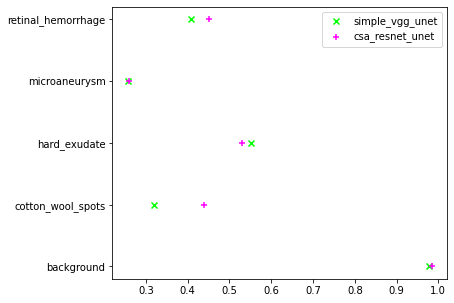

In [42]:
runner_10.quantative(stub_name="noise_removed", model_keys=list(model_specs.keys()))

## Experiments on Loss Functions

#### Initialization

In [60]:
model_specification = {
    
    #CE Loss
    "simple_vgg_unet" : (1,1,0, "./model_weights/stage_1/vgg_simple.pth"),
    "csa_resnet_unet" : (2,1,1, "./model_weights/stage_4/csa_resnet_2.pth"),
    "attention_b4_unet" : (3,1,2, "./model_weights/stage_4/simple_b4_attention.pth"),
    "multi-task_resnet_unet" : (2,1,0, "./model_weights/stage_5/simple_res_mtt_2.pth"),
    "bcm_resnet_unet" : (2,1,0, "model_weights/stage_15_bcm/simple_res.pth"),
    
    #Dice Loss
    "simple_vgg_unet_dice" : (1,1,0, "./model_weights/stage_10_dice/simple_vgg.pth"),
    "csa_resnet_unet_dice" : (2,1,1, "./model_weights/stage_10_dice/csa_resnet.pth"),
    "attention_b4_unet_dice" : (3,1,2, "./model_weights/stage_10_dice/attention_b4.pth"),
    "multi-task_resnet_unet_dice" : (2,1,0, "./model_weights/stage_10_dice/res_mtt_simple.pth"),
    
    #DiceCE Loss
    "simple_vgg_unet_diceCE" : (1,1,0, "./model_weights/stage_11_dice_ce/simple_vgg.pth"),
    "csa_resnet_unet_diceCE" : (2,1,1, "./model_weights/stage_11_dice_ce/csa_resnet.pth"),
    "attention_b4_unet_diceCE" : (3,1,2, "./model_weights/stage_11_dice_ce/attention_b4.pth"),
    "multi-task_resnet_unet_diceCE" : (2,1,0, "./model_weights/stage_11_dice_ce/simple_res_mtt.pth"),
    "bcm_resnet_unet_diceCE" : (2,1,0, "./model_weights/stage_15_bcm/simple_res_diceCE.pth"),
    
    #L1 Loss
    "simple_vgg_unet_l1" : (1,1,0, "./model_weights/stage_12_l1/simple_vgg.pth"),
    "csa_resnet_unet_l1" : (2,1,1, "./model_weights/stage_12_l1/csa_resnet.pth"),
    "attention_b4_unet_l1" : (3,1,2, "./model_weights/stage_12_l1/attention_b4.pth"),
    "multi-task_resnet_unet_l1" : (2,1,0, "./model_weights/stage_12_l1/simple_resnet_mtt.pth"),
    "simple_vgg_unet_l1_weighted" : (1,1,0, "./model_weights/stage_14_l1_weighted/simple_vgg.pth"),
    "bcm_resnet_unet_l1" : (2,1,0, "./model_weights/stage_12_l1/bcm_resnet.pth"),
    
    #KL_Loss
    "simple_vgg_unet_kl" : (1,1,0, "./model_weights/stage_13_kl/simple_vgg.pth"),
    "csa_resnet_unet_kl" : (2,1,1, "./model_weights/stage_13_kl/csa_resnet.pth"),
    "attention_b4_unet_kl" : (3,1,2, "./model_weights/stage_13_kl/attention_b4.pth"),
    "multi-task_resnet_unet_kl" : (2,1,0, "./model_weights/stage_13_kl/mtt_resnet_simple.pth"),
    
}

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
} 

class_dict = ["background"] + classes

model_dict = model_loader(model_specifications=model_specification, num_classes=5)

Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth


  0%|          | 0.00/548M [00:00<?, ?B/s]

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/efficientnet_b4_rwightman-7eb33cd5.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b4_rwightman-7eb33cd5.pth


  0%|          | 0.00/74.5M [00:00<?, ?B/s]

In [61]:
ev = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:08<00:00,  4.46it/s]


In [54]:
runner = Evaluator(ev, "./experiment_results/stage_10/")

#### Model 1

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : simple_vgg_unet_dice...
Working on : simple_vgg_unet_diceCE...
Working on : simple_vgg_unet_l1...
Working on : simple_vgg_unet_l1_weighted...
Working on : simple_vgg_unet_kl...
Creating final dict


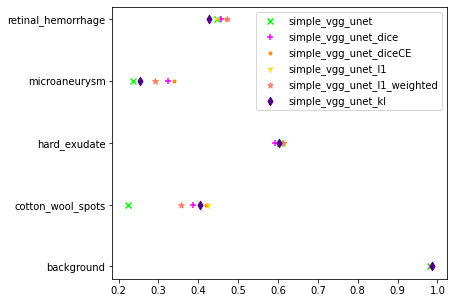

In [55]:
runner.quantative("simple_vgg_comp", [key for key in model_specification.keys() if "vgg" in key])

#### Model 2

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : csa_resnet_unet...
Working on : csa_resnet_unet_dice...
Working on : csa_resnet_unet_diceCE...
Working on : csa_resnet_unet_l1...
Working on : csa_resnet_unet_kl...
Creating final dict


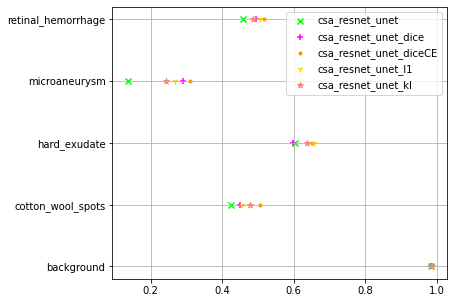

In [42]:
runner.quantative("csa_resnet_comp", [key for key in model_specification.keys() if "csa" in key])

#### Model 3

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : attention_b4_unet...
Working on : attention_b4_unet_dice...
Working on : attention_b4_unet_diceCE...
Working on : attention_b4_unet_l1...
Working on : attention_b4_unet_kl...
Creating final dict


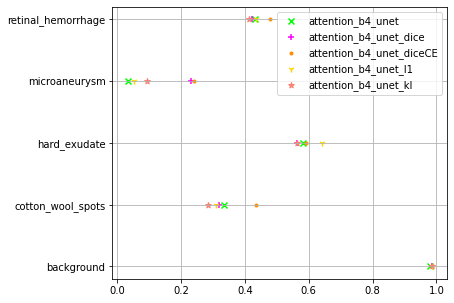

In [43]:
runner.quantative("attention_b4_comp", [key for key in model_specification.keys() if "b4" in key])

#### Model 4

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : multi-task_resnet_unet...
Working on : multi-task_resnet_unet_dice...
Working on : multi-task_resnet_unet_diceCE...
Working on : multi-task_resnet_unet_l1...
Working on : multi-task_resnet_unet_kl...
Creating final dict


/tmp/ipykernel_57/3685435587.py:355: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


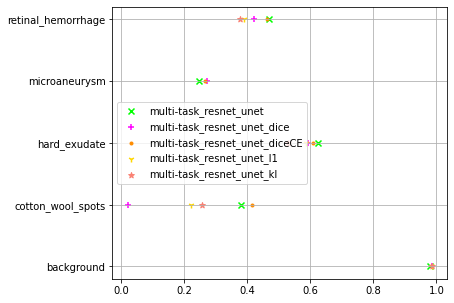

In [44]:
runner.quantative("multi_task_comp", [key for key in model_specification.keys() if "multi" in key])

#### Model 5

In [62]:
runner.quantative("bcm_resnet", [key for key in model_specification.keys() if "bcm" in key])

NameError: name 'runner' is not defined

# Demo

#### Demo Fail

In [54]:
test_images = [
    ["1413_left",
    "1663_right",
    "1008_right",
    "4374_right",],
    ["8446_left",
    "10091_right",
    "19347_right",
    "25463_left"],
]

In [61]:
test_images[0][1]

'1663_right'

In [49]:
image_dir

'./fundus_images/'

In [50]:
ann_dir = "./lesion_annotations_color_darker/"

In [51]:
img_files = [os.path.join(image_dir, file+".jpg") for file in test_images]
ann_files = [os.path.join(ann_dir, file+".png") for file in test_images]

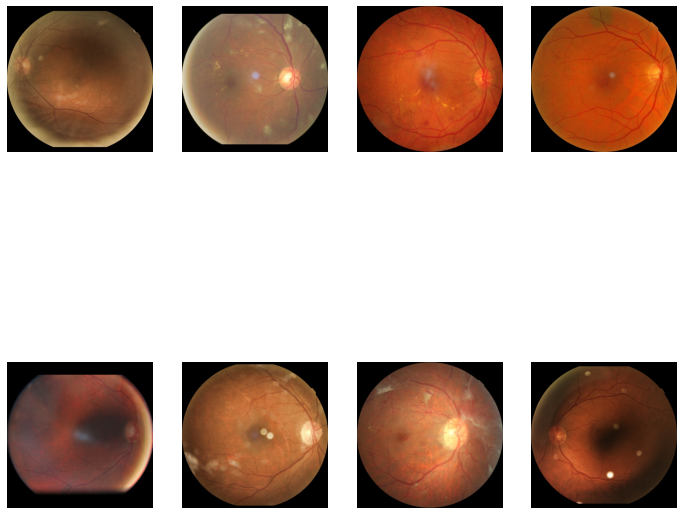

In [69]:
fig, ax = plt.subplots(2, 4, figsize=(12,12))

for i in range(2):
    for j in range(4):
        img_file = test_images[i][j]
        img_path = os.path.join(image_dir, img_file+".jpg")
        img = cv2.imread(img_path)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        ax[i, j].imshow(img)
        ax[i,j].axis('off')


In [115]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["1413_left.jpg", "1663_right.jpg"]
gt_files = ["1413_left.png", "1663_right.png"]

args = (img_dir, gt_dir, img_files, gt_files)

./fundus_images/
./lesion_annotations_color_darker/
['1413_left.jpg', '1663_right.jpg']
['1413_left.png', '1663_right.png']


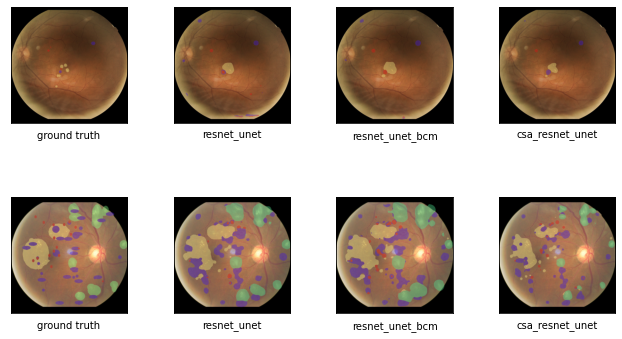

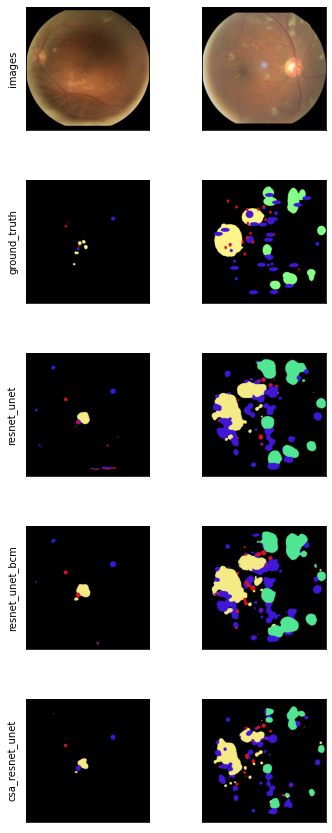

In [116]:
runner.qualitative("demo", [key for key in model_spec.keys() if "res" in key], args)

### 2

In [223]:
def color_swap(img):
    
    color_dict = {
        1 : np.array([[80, 230, 147]]),
        2 : np.array([[245, 234, 133]]),
        3 : np.array([[224, 20, 20]]),
        4 : np.array([[64, 22, 217]])
    }
    
    for key in color_dict.keys():

        c = np.where(img[:, :, [0,1,2]] == [key, key, key])
        img[c[0], c[1], :] = color_dict[key]

    return img

In [234]:
model_spec = {
    "attention_b4_unet" : (3,1,2,0, "./model_weights/stage_9/attention_b4.pth"),
    "b4_unet" : (3,1,0,0, "./model_weights/stage_1/simple_effunet.pth"),
    "csa_res" : (2,1,1,0, "./model_weights/stage_9/csa_resnet.pth"),
    "csa_res_1" : (2,1,1,0, "./model_weights/stage_4/csa_resnet_2.pth")
}

model_dict = model_loader(model_spec, 5)
ab4 = model_dict["attention_b4_unet"]
b4= model_dict["b4_unet"]
csa = model_dict["csa_res"]
csa_normal = model_dict["csa_res_1"]

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=EfficientNet_B4_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B4_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [235]:
img_dir = "./enhancement_three/"
img_dir = "./fundus_images/"
img_name = "9_left.jpg"

img_path = os.path.join(img_dir, img_name)
img = cv2.imread(img_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
img = img / 255.0
img = cv2.resize(img, (512,512))
img = np.transpose(img, (2,0,1))
img = torch.from_numpy(img)

In [236]:
img.shape

torch.Size([3, 512, 512])

In [237]:
img = img.float()
pred = csa_normal.predict_image(img)

In [238]:
pred.shape

(1, 512, 512, 5)

In [239]:
#pred_ann = np.squeeze(pred)
pred = np.argmax(pred, axis=-1)
pred = np.transpose(pred, (1,2,0))
pred = np.repeat(pred, repeats=3,axis=-1)

In [240]:
pred.shape

(512, 512, 3)

In [241]:
pred= color_swap(pred)
pred.shape

(512, 512, 3)

In [242]:
save_img("./pred.png", pred)

(-0.5, 511.5, 511.5, -0.5)

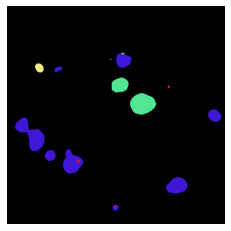

In [243]:
plt.imshow(pred)
plt.axis('off')

# Final Evaluation

In [68]:
model_spec = {
    
#     #Basic Unets
#     "simple_unet" : (0,1,0,0, "./model_weights/stage_1/simple_unet.pth"),
#     "complex_unet" : (0,0,0,0, "./model_weights/stage_1/complex_unet.pth"),
    
#     #VGG Unets
    "simple_vgg_unet" : (1, 1, 0, 0,"./model_weights/stage_1/vgg_simple.pth"),
    "multi-task_vgg_unet" : (1,1,0,0, "./model_weights/stage_5/simple_vgg_mtt_sig.pth"),
    "bcm_vgg_unet_05" : (1,1,0,0, "./model_weights/stage_15_bcm/simple_vgg_05.pth"),
    "bcm_vgg_unet_015" : (1,1,0,0, "./model_weights/stage_15_bcm/simple_vgg_015.pth"),
# #     "complex_vgg_unet" : (1, 0, 0, 0,"./model_weights/stage_1/complex_vgg_best.pth"),
# #     "csa_vgg_unet" : (1, 1, 1, 0, "./model_weights/stage_4/csa_vgg.pth"),
# #     "dual_attention_vgg_unet" : (1,1,2,0, "./model_weights/stage_4/simple_vgg_attention_relu.pth"),
    
#     #ResNets
    "simple_res_unet" : (2, 1, 0, 0, "./model_weights/stage_1/simple_resunet.pth"),
    "multi-task_res_unet" : (2,1,0,0, "./model_weights/stage_5/simple_res_mtt_2.pth"),
    "bcm_res_unet_05" : (2,1,0,0, "./model_weights/stage_15_bcm/simple_res_05.pth"),
    "bcm_res_unet_015" : (2,1,0,0, "./model_weights/stage_15_bcm/simple_res_015.pth"),
    # "complex_res_unet" : (2, 0, 0, 0, "./model_weights/stage_1/complex_resunet.pth"),
    # "csa_res_unet" : (2,1,1,0, "./model_weights/stage_11_dice_ce/csa_resnet.pth"),
    # "dual_attention_res_unet" : (2,1,2,0, "./model_weights/stage_4/simple_res_attention.pth"),

    
    # #B4 Unets
    # "simple_b4_unet" : (3,1,0,0, "./model_weights/stage_1/simple_effunet.pth"),
    # "complex_b4_unet" : (3,0,0,0, "./model_weights/stage_1/complex_effunet.pth"),
    # "csa_b4_unet" : (3,1,1,0, "./model_weights/stage_4/csa_b4.pth"),
    # "dual_attention_b4_unet" : (3,1,2,0, "./model_weights/stage_4/simple_b4_attention.pth"),
}

class_dict = ["background"] + classes

color_dict = {
    1 : np.array([[80, 230, 147]]),
    2 : np.array([[245, 234, 133]]),
    3 : np.array([[224, 20, 20]]),
    4 : np.array([[64, 22, 217]])
}

model_dict = model_loader(model_spec, 5)

In [102]:
img_dir = "./fundus_images/"
gt_dir = "./lesion_annotations_color_darker/"

img_files = ["25867_left.jpg", "3868_left.jpg", "17840_right.jpg", "10091_right.jpg", "1008_right.jpg"]
gt_files = ["25867_left.png", "3868_left.png", "17840_right.png", "10091_right.png", "1008_right.png"]

img_files = ["250_left.jpg", "2044_left.jpg", "2800_left.jpg", "20292_left.jpg", "18451_right.jpg"]
gt_files = ["250_left.png", "2044_left.png", "2800_left.png", "20292_left.png", "18451_right.png"]

args = (img_dir, gt_dir, img_files, gt_files)

In [70]:
ev = EvalPipeline(test_dl, 5, model_dict, class_dict, color_dict)

100%|██████████| 40/40 [00:06<00:00,  6.66it/s]


In [71]:
runner = Evaluator(ev, "./final_experiment_results/training_approaches/")

### Model Architectures

In [66]:
runner.quantative("multi-task_x", list(model_dict.keys()))

['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_vgg_unet...
Working on : multi-task_vgg_unet...
Working on : bcm_vgg_unet_05...
Working on : bcm_vgg_unet_015...
Working on : simple_res_unet...
Working on : multi-task_res_unet...
Working on : bcm_res_unet_05...
Working on : bcm_res_unet_015...
Creating final dict


./fundus_images/
./lesion_annotations_color_darker/
['250_left.jpg', '2044_left.jpg', '2800_left.jpg', '20292_left.jpg', '18451_right.jpg']
['250_left.png', '2044_left.png', '2800_left.png', '20292_left.png', '18451_right.png']


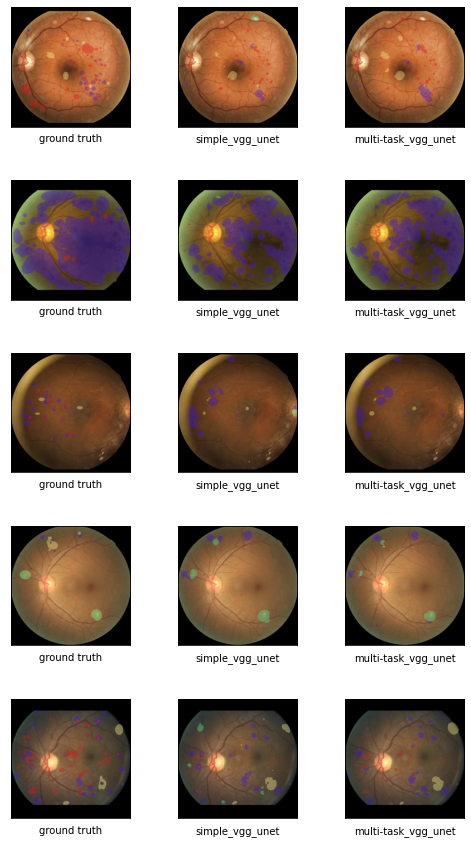

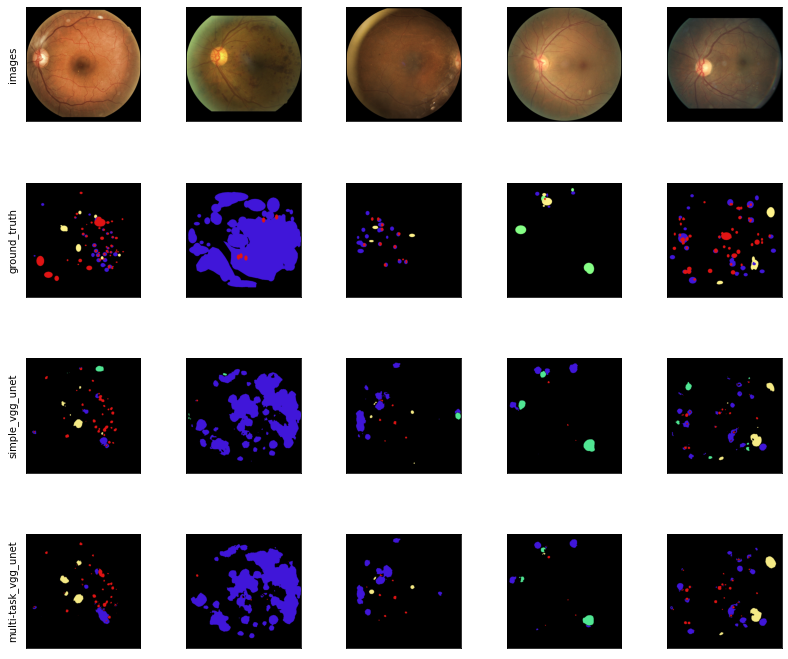

In [103]:
runner.qualitative(stub_name="multi-task", model_keys=["simple_vgg_unet", "multi-task_vgg_unet"], args=args)



['SENS', 'SPEC', 'IoU', 'DSC']
Working on : simple_unet...
Working on : complex_unet...
Working on : simple_vgg_unet...
Working on : complex_vgg_unet...
Creating final dict


/tmp/ipykernel_57/3443260270.py:401: RuntimeWarning: invalid value encountered in true_divide
  f1 = (2 * prec * recall) / (prec + recall)


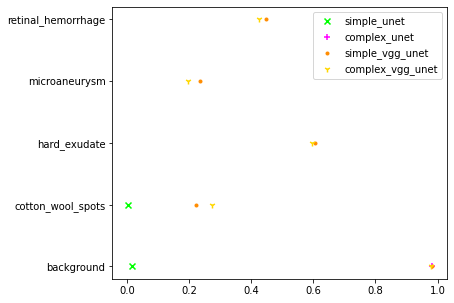

In [50]:
runner.quantative("basic_unet", list(model_dict.keys())[:4])

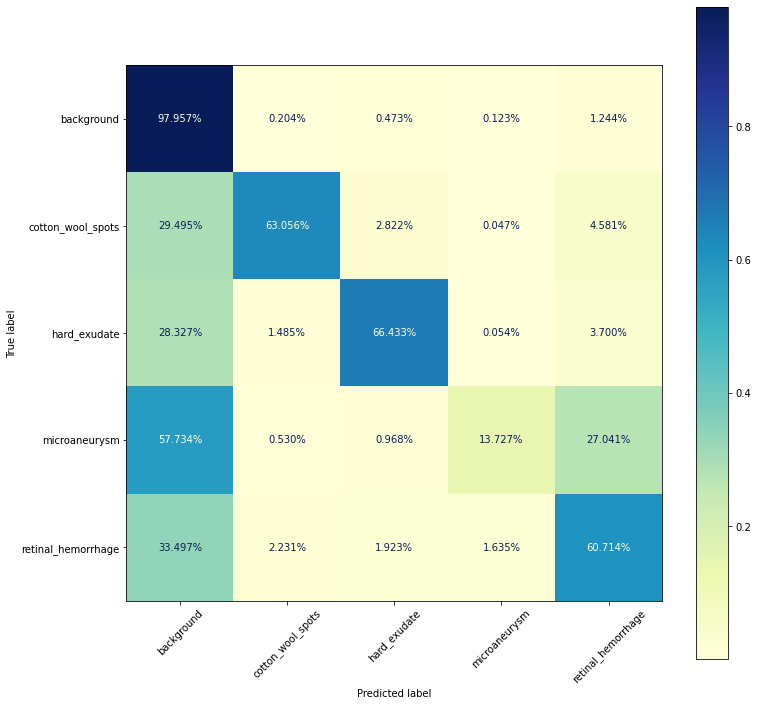

In [194]:
ev.stage_seven(model_key="simple_res_unet", path="./final_experiment_results/training_approaches/simple_res.png")

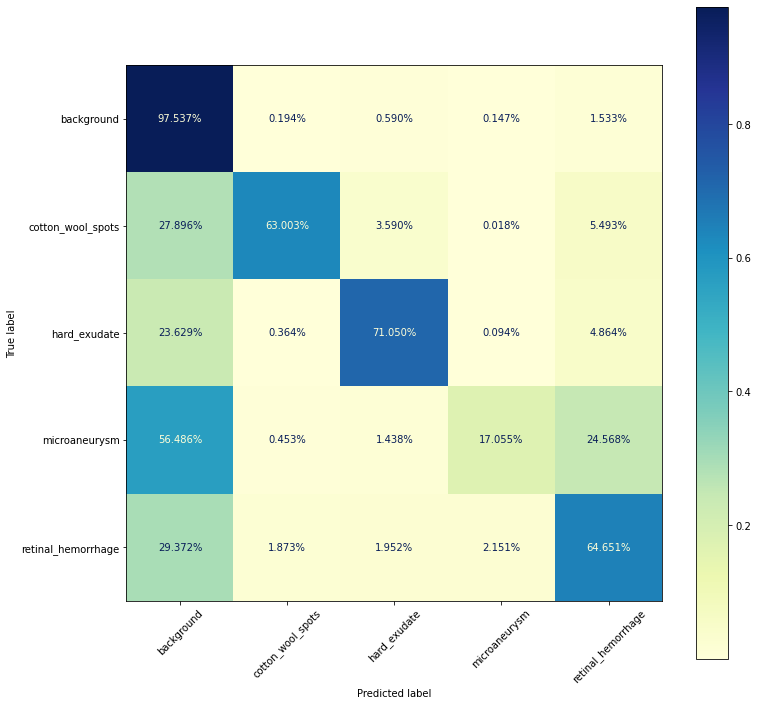

In [196]:
ev.stage_seven(model_key="multi-task_res_unet", path="./final_experiment_results/training_approaches/mtt_res.png")

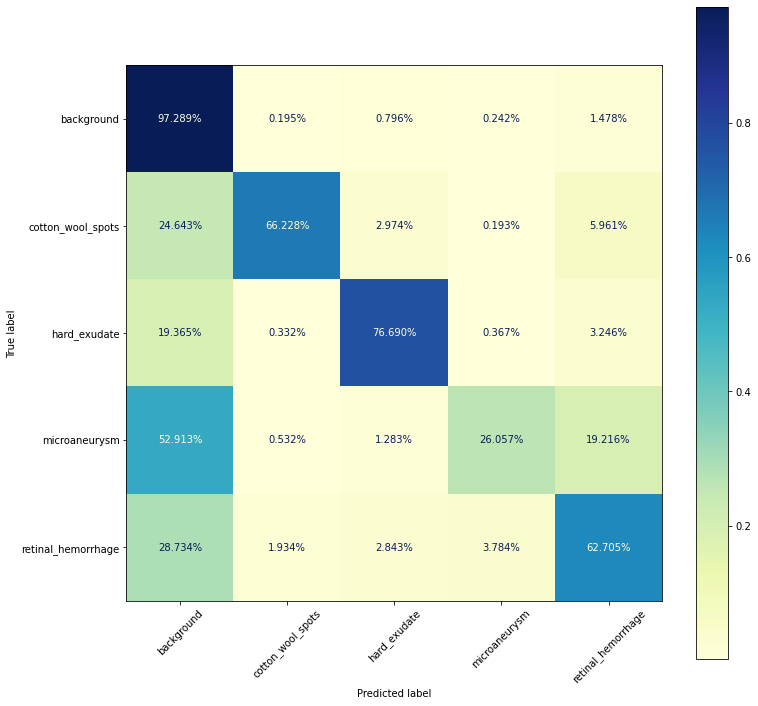

In [197]:
ev.stage_seven(model_key="bcm_res_unet_015", path="./final_experiment_results/training_approaches/bcm_res.png")

#### Plotting

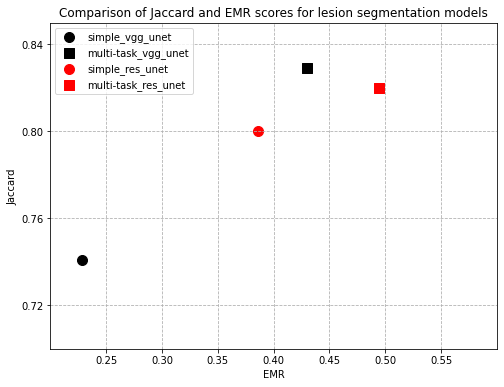

In [218]:
import matplotlib.pyplot as plt

# Define data
models = ["simple_vgg_unet", "multi-task_vgg_unet", "simple_res_unet", "multi-task_res_unet"]
jaccard_scores = [0.741, 0.829, 0.8, 0.82]
emr_scores = [0.228, 0.43, 0.386, 0.494]

# Define markers and line colors
vgg_marker = "o"
res_marker = "s"
simple_color = "black"
multi_color = "red"

# Plot data
fig, ax = plt.subplots(figsize=(8, 6))
for i in range(len(models)):
    if "vgg" in models[i]:
        if "simple" in models[i]:
            marker = vgg_marker
            color = simple_color
        else:
            marker = res_marker
            color = simple_color
    else:
        if "simple" in models[i]:
            marker = vgg_marker
            color = multi_color
        else:
            marker = res_marker
            color = multi_color
    
    ax.scatter(emr_scores[i], jaccard_scores[i], marker=marker, s=100, label=models[i], color=color)

# Add legend and labels
ax.legend(loc="best")
ax.set_xlabel("EMR")
ax.set_ylabel("Jaccard")

# Set axis limits and ticks
ax.set_xlim([0.2, 0.6])
ax.set_ylim([0.7, 0.85])
ax.set_xticks([0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55])
ax.set_yticks([0.72, 0.76, 0.8, 0.84])

# Add gridlines
ax.grid(True, linestyle="--")

# Set plot title
plt.title("Comparison of Jaccard and EMR scores for lesion segmentation models")

# Show plot
plt.show()


(0.2, 0.6)

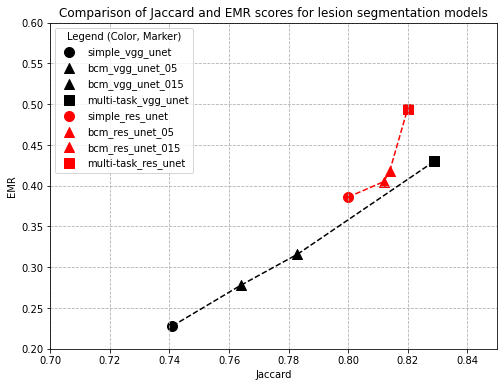

In [234]:
import matplotlib.pyplot as plt

# Define data
models = ["simple_vgg_unet", "multi-task_vgg_unet", "bcm_vgg_unet_05", "bcm_vgg_unet_015",
          "simple_res_unet", "multi-task_res_unet", "bcm_res_unet_05", "bcm_res_unet_015"]
jaccard_scores = [0.741, 0.829, 0.764, 0.783, 0.8, 0.82, 0.812, 0.814]
emr_scores = [0.228, 0.43, 0.278, 0.316, 0.386, 0.494, 0.405, 0.418]

# Define markers and line colors
simple_marker = "o"
multi_marker = "s"
vgg_color = "black"
res_color = "red"
bcm_color = "green"
bcm_marker = "^"

# Sort models based on whether they are VGG-based or ResNet-based
vgg_models = [m for m in models if "vgg" in m]
res_models = [m for m in models if "res" in m]
vgg_models_sorted = sorted(vgg_models, key=lambda m: jaccard_scores[models.index(m)])
res_models_sorted = sorted(res_models, key=lambda m: jaccard_scores[models.index(m)])

# Plot VGG models
fig, ax = plt.subplots(figsize=(8, 6))
for i in range(len(vgg_models_sorted)):
    m = vgg_models_sorted[i]
    if "simple" in m:
        marker = simple_marker
        color = vgg_color
    elif "bcm" in m:
        marker = bcm_marker
        color = vgg_color
    else:
        marker = multi_marker
        color = vgg_color
    
    ax.scatter(jaccard_scores[models.index(m)], emr_scores[models.index(m)], marker=marker, s=100, label=m, color=color)

# Connect VGG models with lines
for i in range(len(res_models_sorted) - 1):
    m1, m2 = res_models_sorted[i], res_models_sorted[i+1]
    if "simple" in m1:
        marker1 = simple_marker
        color1 = res_color
    elif "bcm" in m1:
        marker1 = bcm_marker
        color1 = res_color
    else:
        marker1 = multi_marker
        color1 = res_color
    if "simple" in m2:
        marker2 = simple_marker
        color2 = res_color
    elif "bcm" in m2:
        marker2 = bcm_marker
        color2 = res_color
    else:
        marker2 = multi_marker
        color2 = res_color
    
    ax.plot([jaccard_scores[models.index(m1)], jaccard_scores[models.index(m2)]],
            [emr_scores[models.index(m1)], emr_scores[models.index(m2)]],
            color=color1, linestyle="--")

for i in range(len(res_models_sorted)):
    m = res_models_sorted[i]
    if "simple" in m:
        marker = simple_marker
        color = res_color
    elif "bcm" in m:
        marker = bcm_marker
        color = res_color
    else:
        marker = multi_marker
        color = res_color
    
    ax.scatter(jaccard_scores[models.index(m)], emr_scores[models.index(m)], marker=marker, s=100, label=m, color=color)

# Connect VGG models with lines
for i in range(len(vgg_models_sorted) - 1):
    m1, m2 = vgg_models_sorted[i], vgg_models_sorted[i+1]
    if "simple" in m1:
        marker1 = simple_marker
        color1 = vgg_color
    elif "bcm" in m1:
        marker1 = bcm_marker
        color1 = vgg_color
    else:
        marker1 = multi_marker
        color1 = vgg_color
    if "simple" in m2:
        marker2 = simple_marker
        color2 = vgg_color
    elif "bcm" in m2:
        marker2 = bcm_marker
        color2 = vgg_color
    else:
        marker2 = multi_marker
        color2 = vgg_color
    
    ax.plot([jaccard_scores[models.index(m1)], jaccard_scores[models.index(m2)]],
            [emr_scores[models.index(m1)], emr_scores[models.index(m2)]],
            color=color1, linestyle="--")    


# Add legend and labels
ax.legend(loc="best", title="Legend (Color, Marker)")
ax.set_xlabel("Jaccard")
ax.set_ylabel("EMR")

# Add gridlines
ax.grid(True, linestyle="--")

# Set plot title
plt.title("Comparison of Jaccard and EMR scores for lesion segmentation models")

# Set axis limits and ticks
ax.set_xlim([0.7, 0.85])
ax.set_ylim([0.2, 0.6])


#### Testing Confusion Matrix

In [53]:
ev.gt.shape

(158, 512, 512, 1)

In [73]:
test_gt = ev.gt

In [115]:
lesions = test_gt.reshape(-1)

In [98]:
lesions_ind = list(np.where(lesions > 0)[0])

In [91]:
lesions = lesions[lesions_ind]

In [116]:
lesions.shape

(41418752,)

In [66]:
test_pred = ev.pred["simple_vgg_unet"]

In [117]:
pred_lesions = test_pred.reshape(-1)

In [100]:
pred_lesions = pred_lesions[lesions_ind]

In [118]:
pred_lesions.shape

(41418752,)

In [106]:
np.unique(pred_lesions)

array([0, 1, 2, 3, 4])

In [107]:
from sklearn.metrics import ConfusionMatrixDisplay, confusion_matrix

In [160]:
cm = confusion_matrix(lesions, pred_lesions, normalize='true')

In [161]:
cm

array([[9.76278964e-01, 5.10769625e-03, 4.25798638e-03, 8.94717330e-04,
        1.34606359e-02],
       [2.32752512e-01, 7.00201683e-01, 1.57348693e-02, 1.18102367e-03,
        5.01299126e-02],
       [2.92102859e-01, 4.34707658e-02, 6.11433996e-01, 5.23879033e-04,
        5.24685001e-02],
       [5.70725061e-01, 3.19547379e-02, 7.80538770e-03, 1.52307401e-01,
        2.37207413e-01],
       [3.66758274e-01, 2.87244120e-02, 1.23459102e-02, 1.65891829e-02,
        5.75582221e-01]])

In [126]:
for v in cm[1]:
    print(v / np.sum(cm[1]))

0.2327525119465087
0.700201682504497
0.015734869269763977
0.0011810236749822847
0.05012991260424805


In [136]:
cmp = np.zeros(cm.shape)

for i in range(cmp.shape[0]):
    for j in range(cmp.shape[1]):
        cmp[i,j] = round((cm[i,j] / np.sum(cm[i])), 3) * 100

In [137]:
cmp

array([[97.6,  0.5,  0.4,  0.1,  1.3],
       [23.3, 70. ,  1.6,  0.1,  5. ],
       [29.2,  4.3, 61.1,  0.1,  5.2],
       [57.1,  3.2,  0.8, 15.2, 23.7],
       [36.7,  2.9,  1.2,  1.7, 57.6]])

In [113]:
c = ["background"] + classes

In [122]:
c

['background',
 'cotton_wool_spots',
 'hard_exudate',
 'microaneurysm',
 'retinal_hemorrhage']

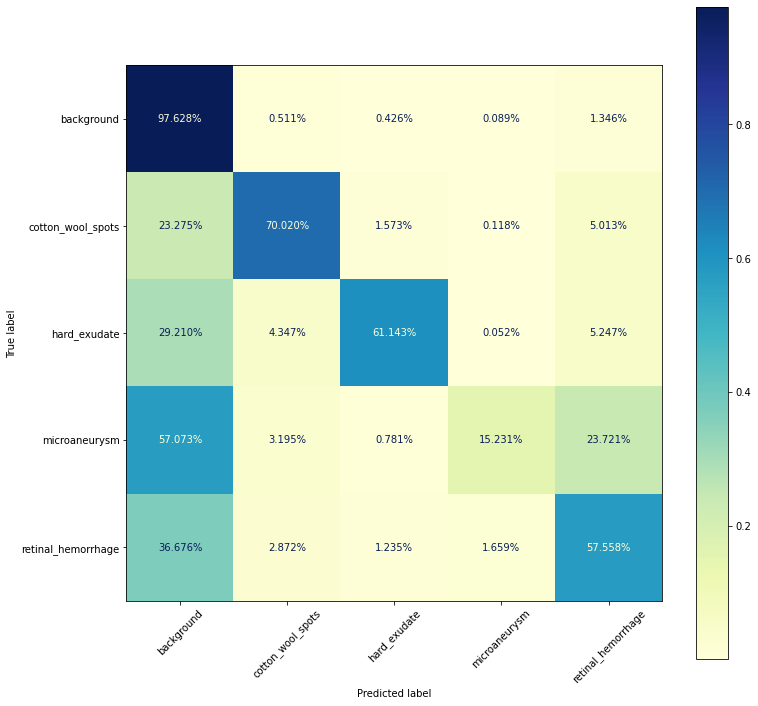

In [180]:
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap

fig, ax = plt.subplots(1,1, figsize=(12,12))

# Define the original colormap
cmap = plt.get_cmap('PiYG')

# Define a gamma value to adjust intensity
gamma = 0.2

# Create a new colormap with reduced intensity
new_cmap = ListedColormap(cmap(np.linspace(0, 1, cmap.N))**gamma)

ConfusionMatrixDisplay.from_predictions(lesions,
                                        pred_lesions
                                        , display_labels=c
                                        , xticks_rotation=45
                                        , normalize='true'
                                        , values_format= ".3%"
                                        , cmap="YlGnBu"
                                        ,ax=ax)

plt.savefig("./test_cm.png")
